In [2]:
import warnings
warnings.filterwarnings('ignore')

from IPython.display import display

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

import pingouin as pg

import glob
import os
import shutil

pd.options.display.max_info_rows = 30000000
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 100)

sns.set_theme(style='darkgrid')

# Tamaño figuras
plt.rcParams["figure.figsize"] = (20,8)
plt.rcParams["figure.dpi"] = 600

pd.options.mode.chained_assignment = None

# Paleta de colores
color = ['#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

color2 = ['#264653', '#2a9d8f', '#e9c46a', '#f4a261', '#e76f51', '#b13c47']

In [4]:
# Join all of csv files of the folder ../resultados, mantaining the header of the first file
#path = r'../results/Resultados_definitivos/' # use your path
#all_files = glob.glob(os.path.join(path, "*.csv"))

#df_from_each_file = (pd.read_csv(f, sep=',') for f in all_files)
#df = pd.concat(df_from_each_file, ignore_index=True)

# Read df from csv
df = pd.read_csv('../results/resultados-definitivos-paper.csv', sep=',')

df['algorithm'] = df['algorithm'].replace('fges', 'Fges')
df['algorithm'] = df['algorithm'].replace('fges-faithfulness', 'Fges-faithfulness')
df['algorithm'] = df['algorithm'].replace('ges-tetrad', 'Fges-ges')
df['algorithm'] = df['algorithm'].replace('ges', 'GES')
df['algorithm'] = df['algorithm'].replace('ges-noParallel', 'GES-np')
df['algorithm'] = df['algorithm'].replace('ges parallel', 'GES')
df['algorithm'] = df['algorithm'].replace('pges', 'pGES')
df['algorithm'] = df['algorithm'].replace('pges-jc', 'pGES-jc')
df['algorithm'] = df['algorithm'].replace('pges-noParallel', 'pGES-np')
df['algorithm'] = df['algorithm'].replace('pges-jc-noParallel', 'pGES-jc-np')

df.head()

,algorithm,network,bbdd,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMM,deltaMM+,deltaMM-,iterations,time(s)
0,Fges,alarm,alarm.xbif50001246_,16,0,0,-1,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,0.770
1,Fges,alarm,alarm.xbif50001246_,16,-1,-1,2,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,0.786
2,Fges,alarm,alarm.xbif50001246_,1,0,0,-1,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,0.807
3,Fges,alarm,alarm.xbif50001246_,1,-1,-1,2,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,0.784
4,Fges,alarm,alarm.xbif50001246_,2,0,0,-1,7,-0.281438,-54069.673911,14.0,0.0,14.0,1,1.046


In [6]:
# Remove GES-np with pges_threads == 0
df = df[~((df['algorithm'] == 'GES-np') & (df['pges_threads'] == 0))]

# Remove Fges with pges_threads == 0
df = df[~((df['algorithm'] == 'Fges') & (df['pges_threads'] == 0))]

# Changue pges_threads == -1 to 1
df['pges_threads'] = df['pges_threads'].replace(-1, 1)

In [7]:
# Remove Fges-faithfulness with pges_threads == 0
df = df[~((df['algorithm'] == 'Fges-faithfulness') & (df['pges_threads'] == 0))]

df = df[~((df['algorithm'] == 'Fges-faithfulness') & (df['pges_threads'] == 0))]

# Replace pges_threads threads in Fges, Fges-faithfulness, GES to 1
df.loc[df['algorithm'] == 'Fges', 'pges_threads'] = 1
df.loc[df['algorithm'] == 'Fges-faithfulness', 'pges_threads'] = 1
df.loc[df['algorithm'] == 'Fges-ges', 'pges_threads'] = 1
df.loc[df['algorithm'] == 'GES', 'pges_threads'] = 1
df.loc[df['algorithm'] == 'ges-noParallel', 'pges_threads'] = 1
df.loc[df['algorithm'] == 'ges-tetrad', 'pges_threads'] = 1

In [8]:
# Remove pGES-jc with seed = -1
df = df[~((df['algorithm'] == 'pGES-jc') & (df['seed'] == -1))]

# Remove Fges-ges with seed = -1
df = df[~((df['algorithm'] == 'Fges-ges') & (df['seed'] == -1))]

# Changue seed to 2
df['seed'] = df['seed'].replace(-1, 2)

# Remove earthquake database
df = df[df['network'] != 'earthquake']

In [9]:
# Borramos pGES-jc-np y pGES-np
df = df[~((df['algorithm'] == 'pGES-jc-np') | (df['algorithm'] == 'pGES-np'))]

In [10]:
# Create a copy of df
df3 = df.copy()

### Cargamos los datos del circular

In [11]:
# Join all of csv files of the folder ../resultados, mantaining the header of the first file
#path = r'../results/Resultados_circular_galgo_alpha/' # use your path
#all_files = glob.glob(os.path.join(path, "*.csv"))

#df_from_each_file = (pd.read_csv(f, sep=',') for f in all_files)
#df2 = pd.concat(df_from_each_file, ignore_index=True)

df2 = pd.read_csv('../results/resultados-circular-galgo-interleaving.csv', sep=',')

df2.head()

,algorithm,network,bbdd,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMM,deltaMM+,deltaMM-,iterations,time(s)
0,circular_ges_c2,alarm,alarm.xbif50001246_,8,2,100,2,10,-0.387282,-54175.022659,20.0,6.0,14.0,4,1.246
1,circular_ges_c2,alarm,alarm.xbif50001246_,8,2,10,2,7,-0.381239,-54069.673911,14.0,0.0,14.0,5,1.169
2,circular_ges_c2,alarm,alarm.xbif50001246_,8,2,125,2,10,-0.387282,-54175.022659,20.0,6.0,14.0,4,1.276
3,circular_ges_c2,alarm,alarm.xbif50001246_,8,2,150,2,10,-0.387282,-54175.022659,20.0,6.0,14.0,4,1.255
4,circular_ges_c2,alarm,alarm.xbif50001246_,8,2,15,2,7,-0.381239,-54069.673911,14.0,0.0,14.0,4,1.251


In [12]:
# Print df2 algorithms unique
df2['algorithm'].unique()

array(['circular_ges_c2', 'ges'], dtype=object)

In [13]:
# Changue ges in df2 to ges-new
df2['algorithm'] = df2['algorithm'].replace('ges', 'GES-new')
df2.loc[df2['algorithm'] == 'GES-new', 'pges_threads'] = 1

In [14]:
# Join df and df2
df = pd.concat([df3, df2], ignore_index=True)

In [15]:
# Delete earthquake
df = df[df['network'] != 'earthquake']

In [16]:
df['bdeu'] = df['bdeu'] / 5000

In [17]:
# Remove algorithms with threads != 16
df16 = df[df['threads'] == 16]

df8 = df[df['threads'] == 8]

# Tablas de datos

In [18]:
df_unstack = df8.drop(["bbdd", "seed", "SHD", "loglike", "bdeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads", "interleaving"], observed=True).mean().unstack(0)

time(s)             \
network                                                 alarm      andes   
algorithm         threads pges_threads interleaving                        
Fges              8       1            -1            0.965727   2.971727   
Fges-faithfulness 8       1            -1            1.247000  11.185909   
Fges-ges          8       1            -1            1.908818  22.393636   
GES               8       1            -1            0.895455  23.378000   
GES-new           8       1            -1            0.890455  23.975273   
GES-np            8       1            -1            1.092909  58.342727   
circular_ges_c2   8       2             5            1.285364  28.097909   
                                        10           1.184727  17.982182   
                                        15           1.206909  16.000455   
                                        20           1.116000  14.131091   
                                        25           1.196273  13.627545   
                                        30           1.230545  13.574364   
                                        40           1.238818  13.711545   
                                        50           1.222636  13.052182   
                                        60           1.246364  12.966818   
                                        70           1.278091  12.737545   
                                        80           1.327818  12.718727   
                                        90           1.307727  12.334000   
                                        100          1.280636  12.419091   
                                        125          1.254091  12.736909   
                                        150          1.232909  13.708182   
                                        200          1.249364  14.671636   
                                        250          1.198636  15.325636   
                                        2147483647   1.260455  14.617000   
                          4             5            1.467909  20.552273   
                                        10           1.466818  13.820182   
                                        15           1.529545  11.761909   
                                        20           1.469364  12.405364   
                                        25           1.570727  11.703727   
                                        30           1.576091  11.213000   
                                        40           1.496182  10.885182   
                                        50           1.452455  12.654273   
                                        60           1.521727  12.457182   
                                        70           1.557727  13.027727   
                                        80           1.559364  11.640455   
                                        90           1.559000  12.547182   
                                        100          1.474182  12.954727   
                                        125          1.476364  13.097545   
                                        150          1.462455  13.303273   
                                        200          1.496909  13.264091   
                                        250          1.506545  13.109273   
                                        2147483647   1.591818  13.541000   
                          6             5            1.588364  17.739273   
                                        10           1.668182  15.699273   
                                        15           1.774364  13.304091   
                                        20           1.851182  13.132091   
                                        25           1.872273  12.050909   
                                        30           1.774091  13.245727   
                                        40           1.775273  13.358545   
                                        50           1.973273  12.648000   
                          

In [19]:
df_unstack = df8.drop(["bbdd", "seed",  "bdeu", "loglike", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads", "interleaving"], observed=True).mean().unstack(0)

SHD              \
network                                                  alarm       andes   
algorithm         threads pges_threads interleaving                          
Fges              8       1            -1             7.909091  232.454545   
Fges-faithfulness 8       1            -1             7.909091  179.272727   
Fges-ges          8       1            -1             8.000000  180.000000   
GES               8       1            -1             9.272727  151.545455   
GES-new           8       1            -1             9.090909  151.545455   
GES-np            8       1            -1             9.272727  151.545455   
circular_ges_c2   8       2             5             8.272727  173.454545   
                                        10            7.454545  161.818182   
                                        15            8.363636  164.636364   
                                        20            7.454545  162.636364   
                                        25            7.909091  154.727273   
                                        30            9.454545  154.727273   
                                        40            9.181818  164.363636   
                                        50            9.181818  156.545455   
                                        60            9.181818  158.636364   
                                        70            9.181818  156.181818   
                                        80            9.181818  157.727273   
                                        90            9.181818  161.636364   
                                        100           9.181818  163.181818   
                                        125           9.181818  161.181818   
                                        150           9.181818  163.727273   
                                        200           9.181818  180.090909   
                                        250           9.181818  180.090909   
                                        2147483647    9.181818  180.090909   
                          4             5             9.363636  166.272727   
                                        10            7.545455  160.454545   
                                        15            9.818182  163.818182   
                                        20           11.090909  162.545455   
                                        25           12.454545  166.545455   
                                        30           12.363636  164.181818   
                                        40           12.363636  166.727273   
                                        50           12.363636  164.636364   
                                        60           12.363636  164.363636   
                                        70           12.363636  167.363636   
                                        80           12.363636  172.000000   
                                        90           12.363636  170.272727   
                                        100          12.363636  166.545455   
                                        125          12.363636  170.000000   
                                        150          12.363636  170.000000   
                                        200          12.363636  170.000000   
                                        250          12.363636  170.000000   
                                        2147483647   12.363636  170.000000   
                          6             5             9.727273  171.636364   
                                        10           10.545455  167.363636   
                                        15           10.727273  163.181818   
                                        20           12.454545  159.181818   
                                        25           11.818182  163.363636   
                                        30           13.727273  158.363636   
                                        40           12.909091  160.909091   
   

In [20]:
df_unstack = df8.drop(["bbdd", "seed", "SHD", "loglike", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads", "interleaving"], observed=True).mean().unstack(0)

bdeu             \
network                                                  alarm      andes   
algorithm         threads pges_threads interleaving                         
Fges              8       1            -1           -10.788383 -94.740114   
Fges-faithfulness 8       1            -1           -10.788383 -94.523032   
Fges-ges          8       1            -1           -10.790218 -94.520367   
GES               8       1            -1           -10.873071 -94.316279   
GES-new           8       1            -1           -10.872212 -94.316279   
GES-np            8       1            -1           -10.873071 -94.316279   
circular_ges_c2   8       2             5           -10.794861 -94.493460   
                                        10          -10.788508 -94.414216   
                                        15          -10.792883 -94.417812   
                                        20          -10.788266 -94.396407   
                                        25          -10.790478 -94.356868   
                                        30          -10.797569 -94.360711   
                                        40          -10.798176 -94.406369   
                                        50          -10.798795 -94.365449   
                                        60          -10.798795 -94.360688   
                                        70          -10.798795 -94.350787   
                                        80          -10.798795 -94.365386   
                                        90          -10.798795 -94.380825   
                                        100         -10.798795 -94.373202   
                                        125         -10.798795 -94.361315   
                                        150         -10.798795 -94.364068   
                                        200         -10.798795 -94.460216   
                                        250         -10.798795 -94.460447   
                                        2147483647  -10.798795 -94.460447   
                          4             5           -10.799371 -94.446585   
                                        10          -10.787706 -94.391694   
                                        15          -10.795780 -94.384828   
                                        20          -10.807336 -94.394090   
                                        25          -10.814243 -94.390845   
                                        30          -10.809246 -94.380463   
                                        40          -10.809454 -94.384036   
                                        50          -10.809454 -94.390021   
                                        60          -10.809454 -94.380447   
                                        70          -10.809454 -94.382863   
                                        80          -10.809454 -94.422617   
                                        90          -10.809454 -94.417604   
                                        100         -10.809454 -94.413205   
                                        125         -10.809454 -94.406020   
                                        150         -10.809454 -94.406020   
                                        200         -10.809454 -94.406020   
                                        250         -10.809454 -94.406020   
                                        2147483647  -10.809454 -94.406020   
                          6             5           -10.791901 -94.496283   
                                        10          -10.811556 -94.434624   
                                        15          -10.804346 -94.386497   
                                        20          -10.813513 -94.370813   
                                        25          -10.812157 -94.386986   
                                        30          -10.827822 -94.361435   
                                        40          -10.823078 -94.366237   
                                        50          -1

In [21]:
df_unstack = df8.drop(["bbdd", "seed", "SHD", "loglike", "bdeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads" , "interleaving"], observed=True).count().unstack(0)

time(s)               \
network                                               alarm andes barley   
algorithm         threads pges_threads interleaving                        
Fges              8       1            -1              11.0  11.0   11.0   
Fges-faithfulness 8       1            -1              11.0  11.0   11.0   
Fges-ges          8       1            -1              11.0  11.0   11.0   
GES               8       1            -1              11.0  11.0   11.0   
GES-new           8       1            -1              11.0  11.0   11.0   
GES-np            8       1            -1              11.0  11.0   11.0   
circular_ges_c2   8       2             5              11.0  11.0   11.0   
                                        10             11.0  11.0   11.0   
                                        15             11.0  11.0   11.0   
                                        20             11.0  11.0   11.0   
                                        25             11.0  11.0   11.0   
                                        30             11.0  11.0   11.0   
                                        40             11.0  11.0   11.0   
                                        50             11.0  11.0   11.0   
                                        60             11.0  11.0   11.0   
                                        70             11.0  11.0   11.0   
                                        80             11.0  11.0   11.0   
                                        90             11.0  11.0   11.0   
                                        100            11.0  11.0   11.0   
                                        125            11.0  11.0   11.0   
                                        150            11.0  11.0   11.0   
                                        200            11.0  11.0   11.0   
                                        250            11.0  11.0   11.0   
                                        2147483647     11.0  11.0   11.0   
                          4             5              11.0  11.0   11.0   
                                        10             11.0  11.0   11.0   
                                        15             11.0  11.0   11.0   
                                        20             11.0  11.0   11.0   
                                        25             11.0  11.0   11.0   
                                        30             11.0  11.0   11.0   
                                        40             11.0  11.0   11.0   
                                        50             11.0  11.0   11.0   
                                        60             11.0  11.0   11.0   
                                        70             11.0  11.0   11.0   
                                        80             11.0  11.0   11.0   
                                        90             11.0  11.0   11.0   
                                        100            11.0  11.0   11.0   
                                        125            11.0  11.0   11.0   
                                        150            11.0  11.0   11.0   
                                        200            11.0  11.0   11.0   
                                        250            11.0  11.0   11.0   
                                        2147483647     11.0  11.0   11.0   
                          6             5              11.0  11.0   11.0   
                                        10             11.0  11.0   11.0   
                                        15             11.0  11.0   11.0   
                                        20             11.0  11.0   11.0   
                                        25             11.0  11.0   11.0   
                                        30             11.0  11.0   11.0   
                                        40             11.0  11.0   11.0   
                                        50             11.0  11.0   11.0   
                        

# Media por interleaving

In [22]:
df_unstack = df8.drop(["bbdd", "seed", "SHD", "loglike", "bdeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "pges_threads"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "interleaving"], observed=True).mean().unstack(0)

time(s)                        \
network                                    alarm      andes     barley   
algorithm         threads interleaving                                   
Fges              8       -1            0.965727   2.971727   4.732455   
Fges-faithfulness 8       -1            1.247000  11.185909  13.225545   
Fges-ges          8       -1            1.908818  22.393636  21.433818   
GES               8       -1            0.895455  23.378000   2.020364   
GES-new           8       -1            0.890455  23.975273   1.658909   
GES-np            8       -1            1.092909  58.342727   5.422455   
circular_ges_c2   8        5            1.588682  21.452568   3.459773   
                           10           1.556455  16.196500   3.439068   
                           15           1.605273  14.257273   3.993932   
                           20           1.621523  13.723932   3.939386   
                           25           1.685636  12.835909   3.565068   
                           30           1.648500  12.933250   3.819136   
                           40           1.641318  13.097886   3.364182   
                           50           1.686500  13.301068   3.348091   
                           60           1.678795  13.144000   3.386432   
                           70           1.707795  13.361568   3.391432   
                           80           1.703432  13.217091   3.363523   
                           90           1.679591  13.052295   3.402795   
                           100          1.633250  13.328545   3.376682   
                           125          1.639682  13.332182   3.417773   
                           150          1.712955  13.653114   3.425182   
                           200          1.698886  13.965295   3.370909   
                           250          1.641227  14.063091   3.382364   
                           2147483647   1.694409  13.875750   3.447409   
pGES              8        2147483647   1.109795   7.262432   2.170227   
pGES-jc           8        2147483647   1.268295   8.413409   2.517795   

                                                                            \
network                                    child     diabetes   hailfinder   
algorithm         threads interleaving                                       
Fges              8       -1            5.228364   205.939909  1667.880636   
Fges-faithfulness 8       -1            6.442273   779.395273  1776.449545   
Fges-ges          8       -1            6.213455  4531.166727  7474.764455   
GES               8       -1            0.364364   220.060273     1.199455   
GES-new           8       -1            0.426091   235.103455     1.642273   
GES-np            8       -1            0.346909   892.267818     1.615182   
circular_ges_c2   8        5            1.051841   372.497795     2.294886   
                           10           1.060568   319.075227     2.187909   
                           15           1.051409   310.320773     2.422886   
                           20           1.042250   328.237318     2.420727   
                           25           1.077523   294.703227     2.412795   
                           30           1.059864   281.706705     2.417432   
                           40           1.045841   318.651000     2.410795   
                           50           1.065000   287.602114     2.468182   
                           60           1.039273   268.126795     2.422159   
                           70           1.061773   275.316773     2.427455   
                           80           1.081250   281.992500     2.529477   
                           90           1.045023   298.284977     2.456318   
                           100          1.061591   283.929977     2.477659   
                           125          1.076409   320.961250     2.429909   
                           150          1.052295   272.600614     2.498886   
                      

In [23]:
df_unstack = df8.drop(["bbdd", "seed",  "bdeu", "loglike", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "pges_threads"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "interleaving"], observed=True).mean().unstack(0)

SHD                         \
network                                     alarm       andes     barley   
algorithm         threads interleaving                                     
Fges              8       -1             7.909091  232.454545  59.545455   
Fges-faithfulness 8       -1             7.909091  179.272727  55.909091   
Fges-ges          8       -1             8.000000  180.000000  57.545455   
GES               8       -1             9.272727  151.545455  61.181818   
GES-new           8       -1             9.090909  151.545455  61.181818   
GES-np            8       -1             9.272727  151.545455  61.181818   
circular_ges_c2   8        5            10.045455  170.386364  60.204545   
                           10            9.272727  164.409091  60.113636   
                           15           10.681818  163.272727  59.590909   
                           20           11.000000  162.909091  61.431818   
                           25           10.568182  162.840909  59.113636   
                           30           11.704545  160.318182  60.295455   
                           40           11.431818  164.977273  60.795455   
                           50           11.431818  164.818182  61.045455   
                           60           11.431818  166.090909  60.386364   
                           70           11.431818  166.431818  60.386364   
                           80           11.431818  167.840909  60.386364   
                           90           11.431818  169.909091  60.386364   
                           100          11.431818  169.272727  60.386364   
                           125          11.431818  169.636364  60.386364   
                           150          11.431818  170.272727  60.386364   
                           200          11.431818  174.363636  60.386364   
                           250          11.431818  174.363636  60.386364   
                           2147483647   11.431818  174.363636  60.386364   
pGES              8        2147483647    7.613636  152.227273  58.727273   
pGES-jc           8        2147483647    7.386364  151.636364  56.363636   

                                                                         \
network                                    child    diabetes hailfinder   
algorithm         threads interleaving                                    
Fges              8       -1            5.363636  380.272727  45.909091   
Fges-faithfulness 8       -1            4.454545  379.272727  43.909091   
Fges-ges          8       -1            4.454545  321.454545  43.909091   
GES               8       -1            8.272727  263.000000  32.909091   
GES-new           8       -1            8.272727  263.000000  32.909091   
GES-np            8       -1            8.272727  263.000000  32.909091   
circular_ges_c2   8        5            4.181818  493.204545  36.159091   
                           10           2.750000  473.227273  35.681818   
                           15           2.954545  457.545455  36.340909   
                           20           3.000000  445.931818  35.522727   
                           25           2.954545  434.795455  36.090909   
                           30           2.954545  425.613636  35.772727   
                           40           2.954545  418.090909  35.659091   
                           50           2.954545  409.886364  35.590909   
                           60           2.954545  404.159091  35.590909   
                           70           2.954545  402.750000  35.590909   
                           80           2.954545  399.318182  35.590909   
                           90           2.954545  393.909091  35.590909   
                           100          2.954545  405.431818  35.590909   
                           125          2.954545  397.340909  35.590909   
                           150          2.954545  396.227273  35.590909   
                           200          2

In [24]:
df_unstack = df8.drop(["bbdd", "seed", "SHD", "loglike", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "pges_threads"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "interleaving"], observed=True).mean().unstack(0)

bdeu                        \
network                                     alarm      andes     barley   
algorithm         threads interleaving                                    
Fges              8       -1           -10.788383 -94.740114 -53.357547   
Fges-faithfulness 8       -1           -10.788383 -94.523032 -52.838533   
Fges-ges          8       -1           -10.790218 -94.520367 -52.829682   
GES               8       -1           -10.873071 -94.316279 -53.223129   
GES-new           8       -1           -10.872212 -94.316279 -53.223129   
GES-np            8       -1           -10.873071 -94.316279 -53.223129   
circular_ges_c2   8        5           -10.804897 -94.470338 -53.015478   
                           10          -10.798339 -94.418148 -53.076880   
                           15          -10.803705 -94.393926 -52.854547   
                           20          -10.806456 -94.391603 -52.989053   
                           25          -10.802525 -94.382147 -52.833577   
                           30          -10.809410 -94.373388 -52.908164   
                           40          -10.808427 -94.390899 -52.985166   
                           50          -10.808582 -94.393909 -52.981442   
                           60          -10.808582 -94.395756 -52.928449   
                           70          -10.808582 -94.393190 -52.928449   
                           80          -10.808582 -94.412714 -52.928449   
                           90          -10.808582 -94.419196 -52.928449   
                           100         -10.808582 -94.416036 -52.928449   
                           125         -10.808582 -94.411268 -52.928449   
                           150         -10.808582 -94.411956 -52.928449   
                           200         -10.808582 -94.435993 -52.928449   
                           250         -10.808582 -94.436051 -52.928449   
                           2147483647  -10.808582 -94.436051 -52.928449   
pGES              8        2147483647  -10.787976 -94.315990 -52.977300   
pGES-jc           8        2147483647  -10.789419 -94.315395 -52.808559   

                                                                          \
network                                     child    diabetes hailfinder   
algorithm         threads interleaving                                     
Fges              8       -1           -12.458725 -277.629849 -50.456310   
Fges-faithfulness 8       -1           -12.454962 -272.192190 -50.418335   
Fges-ges          8       -1           -12.454962 -245.982270 -50.430066   
GES               8       -1           -12.469196 -226.328180 -50.413431   
GES-new           8       -1           -12.469196 -226.328180 -50.413431   
GES-np            8       -1           -12.469196 -226.328180 -50.413431   
circular_ges_c2   8        5           -12.453062 -257.852630 -50.458957   
                           10          -12.438665 -255.424600 -50.456209   
                           15          -12.449687 -253.493861 -50.450822   
                           20          -12.445984 -253.620393 -50.448233   
                           25          -12.445772 -251.640391 -50.446763   
                           30          -12.445772 -250.663756 -50.445266   
                           40          -12.445772 -250.401782 -50.449714   
                           50          -12.445772 -249.908766 -50.450578   
                           60          -12.445772 -249.005951 -50.450578   
                           70          -12.445772 -248.928972 -50.450578   
                           80          -12.445772 -248.569538 -50.450578   
                           90          -12.445772 -247.345774 -50.450578   
                           100         -12.445772 -248.316304 -50.450578   
                           125         -12.445772 -247.696018 -50.450578   
                           150         -12.445772 -247.751563 -50.450578   
                           200         -12.44

In [25]:
# Para estos experimentos, eliminamos GES-np, pGES-np y pGES-jc-np, porque ya hemos visto en las tablas cómo funcionan
df = df[~df['algorithm'].isin(['pGES-np', 'pGES-jc-np', 'GES-np'])]

In [26]:
df_original = df.copy()
df = df[df['threads'] == 8]

# Comparación interleaving

### BDeu, 2 threads

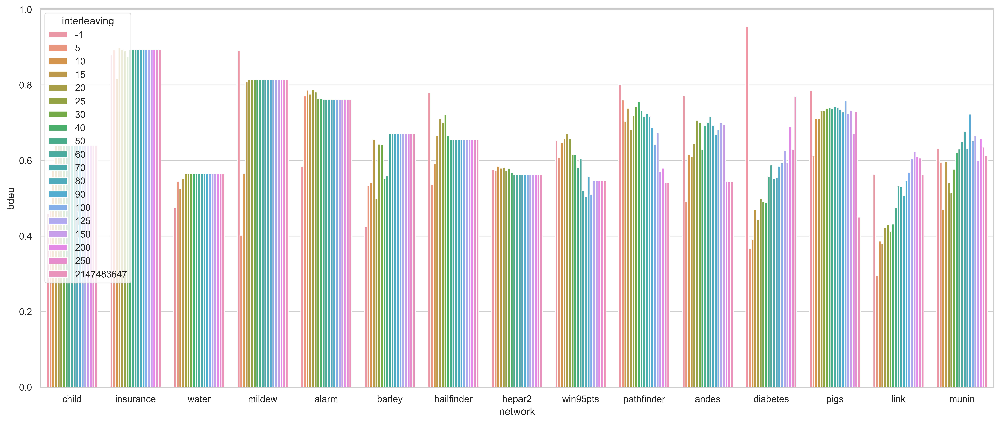

In [27]:
# For algorithm circular_ges_c2 and pges_threads == 2
df2 = df[((df['algorithm'] == 'circular_ges_c2') & (df['pges_threads'] == 2)) | (df['algorithm'] == 'GES')]

# Normalize the values of df2 between the maximun and the minimun value for each network
df2['bdeu'] = df2.groupby('network')['bdeu'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))

# Add the number of nodes of each network
df2['nodes'] = df2['network'].map({'alarm': 37, 'barley' : 48, 'child': 20, 'insurance': 27, 'mildew': 35, 'water': 32, 'hailfinder' : 56, 'hepar2' : 70, 'win95pts' : 76, 'andes' : 223, 'diabetes' : 413, 'link' : 724, 'pathfinder' : 109, 'pigs' : 441, 'munin' : 1041})

# Order by nodes
df2 = df2.sort_values(by=['nodes'])

# Draw a line for each network
sns.set(style="whitegrid")
g = sns.barplot(x="network", y="bdeu", hue="interleaving", data=df2, errorbar=None)

sns.move_legend(g, "upper left")

### SHD, 2 threads

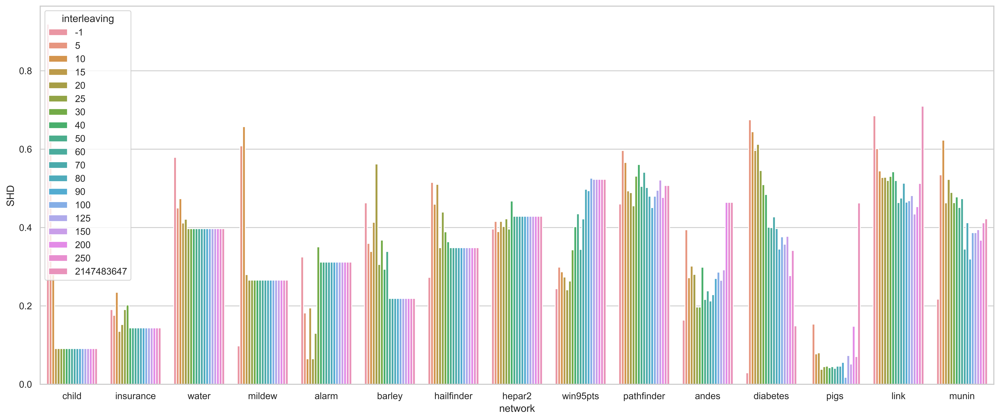

In [29]:
# For algorithm circular_ges_c2 and pges_threads == 2
df2 = df[((df['algorithm'] == 'circular_ges_c2') & (df['pges_threads'] == 2)) | (df['algorithm'] == 'GES')]

# Normalize the values of df2 between the maximun and the minimun value for each network
df2['SHD'] = df2.groupby('network')['SHD'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))

# Add the number of nodes of each network
df2['nodes'] = df2['network'].map({'alarm': 37, 'barley' : 48, 'child': 20, 'insurance': 27, 'mildew': 35, 'water': 32, 'hailfinder' : 56, 'hepar2' : 70, 'win95pts' : 76, 'andes' : 223, 'diabetes' : 413, 'link' : 724, 'pathfinder' : 109, 'pigs' : 441, 'munin' : 1041})

# Order by nodes
df2 = df2.sort_values(by=['nodes'])

# Draw a line for each network
sns.set(style="whitegrid")
g = sns.barplot(x="network", y="SHD", hue="interleaving", data=df2, errorbar=None)

### time(s), 2 threads

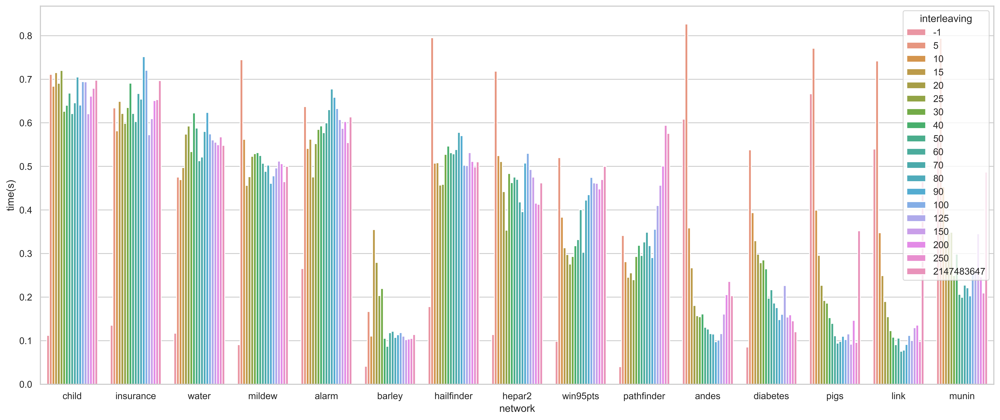

In [30]:
# For algorithm circular_ges_c2 and pges_threads == 2
df2 = df[((df['algorithm'] == 'circular_ges_c2') & (df['pges_threads'] == 2)) | (df['algorithm'] == 'GES')]

# Normalize the values of df2 between the maximun and the minimun value for each network
df2['time(s)'] = df2.groupby('network')['time(s)'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))

# Add the number of nodes of each network
df2['nodes'] = df2['network'].map({'alarm': 37, 'barley' : 48, 'child': 20, 'insurance': 27, 'mildew': 35, 'water': 32, 'hailfinder' : 56, 'hepar2' : 70, 'win95pts' : 76, 'andes' : 223, 'diabetes' : 413, 'link' : 724, 'pathfinder' : 109, 'pigs' : 441, 'munin' : 1041})

# Order by nodes
df2 = df2.sort_values(by=['nodes'])

# Draw a line for each network
sns.set(style="whitegrid")
g = sns.barplot(x="network", y="time(s)", hue="interleaving", data=df2, errorbar=None)

### SHD * time(s), 2 threads

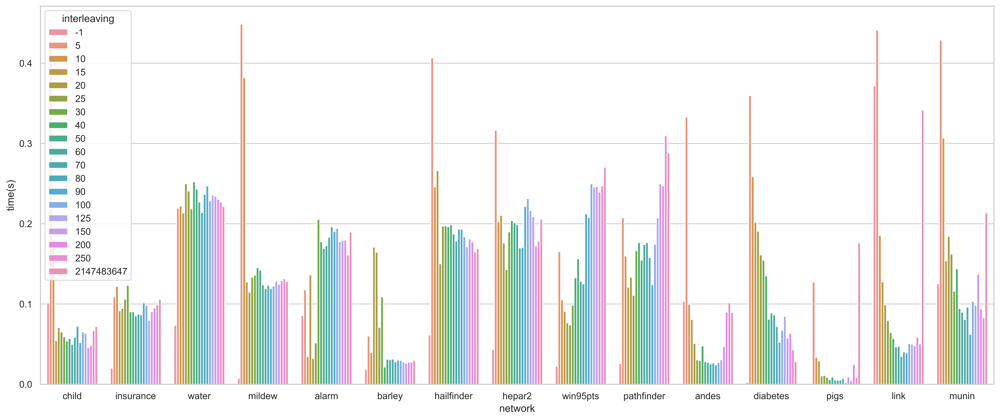

In [31]:
# For algorithm circular_ges_c2 and pges_threads == 2
df2 = df[((df['algorithm'] == 'circular_ges_c2') & (df['pges_threads'] == 2)) | (df['algorithm'] == 'GES')]

# Normalize the values of df2 between the maximun and the minimun value for each network
df2['SHD'] = df2.groupby('network')['SHD'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))
df2['time(s)'] = df2.groupby('network')['time(s)'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))

df2['time(s)'] = df2['time(s)'] * df2['SHD']

# Add the number of nodes of each network
df2['nodes'] = df2['network'].map({'alarm': 37, 'barley' : 48, 'child': 20, 'insurance': 27, 'mildew': 35, 'water': 32, 'hailfinder' : 56, 'hepar2' : 70, 'win95pts' : 76, 'andes' : 223, 'diabetes' : 413, 'link' : 724, 'pathfinder' : 109, 'pigs' : 441, 'munin' : 1041})

# Order by nodes
df2 = df2.sort_values(by=['nodes'])

# Draw a line for each network
sns.set(style="whitegrid")
g = sns.barplot(x="network", y="time(s)", hue="interleaving", data=df2, errorbar=None)

# Gráficas

In [24]:
def plot(network, variable, precision, size, threads=8):    
    df_temp = df[df["network"] == network]
    
    paleta = color

    # Order of the bars: fges, ges, pges
    order = ["Fges", "Fges-faithfulness", "GES", "pGES", "pGES-jc", "circular_ges_c2"]

    # Gráfico de barras, sin leyenda (se crea después)
    if variable == "bdeu":
        ax = sns.barplot(data=df_temp, x="algorithm", hue="pges_threads",ci=None, y=variable, palette=paleta, order=order, errwidth=1)
        min = df_temp[variable].min()*1.01
        max = df_temp[variable].max()*0.97
        ax.set_ylim(min, max)
        texto = "BDeu:  " + network
    elif variable == "SHD":
        # Changue the with of the ci
        ax = sns.barplot(data=df_temp, x="algorithm", hue="pges_threads", ci=None, y=variable, palette=paleta, order=order, errwidth=1)
        texto = "SHD:  " + network
    elif variable == "time(s)":
        #df_temp.loc[df_temp['algorithm'] == 'GES', 'pges_threads'] = df_temp['threads']

        # When pges_threads = 8 and algorithm = GES, change the value to -1
        df_temp.loc[(df_temp['algorithm'] == 'GES') & (df_temp['threads'] == 1), 'pges_threads'] = -1
        
        df_temp = df_temp[(df_temp['algorithm'] == 'Fges') | (df_temp['algorithm'] == 'Fges-faithfulness') | (df_temp['algorithm'] == 'Fges-ges') | (df_temp['algorithm'] == 'GES') | (df_temp['threads'] == threads)]
        ax = sns.barplot(data=df_temp, x="algorithm", y=variable, hue="pges_threads", errorbar=("pi", 100), palette=color, order=order, errwidth=1)
        texto = "tiempo:  " + network + "  (" + str(threads) + " threads)"
    elif variable == "iterations":
        # Changue the with of the ci
        ax = sns.barplot(data=df_temp, x="algorithm", hue="pges_threads", errorbar=("pi", 100), y=variable, palette=paleta, order=order, errwidth=1)
        texto = "iteraciones:  " + network

    ax.set_title('Comparativa ' + texto, fontsize=16)
    ax.set_xlabel('Algoritmo', fontsize=14)
    ax.set_ylabel(variable, fontsize=14)

    # Imprimir valores de las barras en la parte superior
    for p in ax.patches:
        if not np.isnan(p.get_height()):
            altura = p.get_height()
            if variable == "bdeu":
                altura -= (max-min)*0.03

            
            # Imprimir valores de las barras en la parte inferior
            ax.text(p.get_x() + p.get_width()/2., altura, ('{0:.'+str(precision)+'f}').format(p.get_height()), ha='center', va='bottom', fontsize=size) 
    
    # Rotar labels inferiores
    plt.xticks(rotation=45)
        
    plt.plot

## Hailfinder

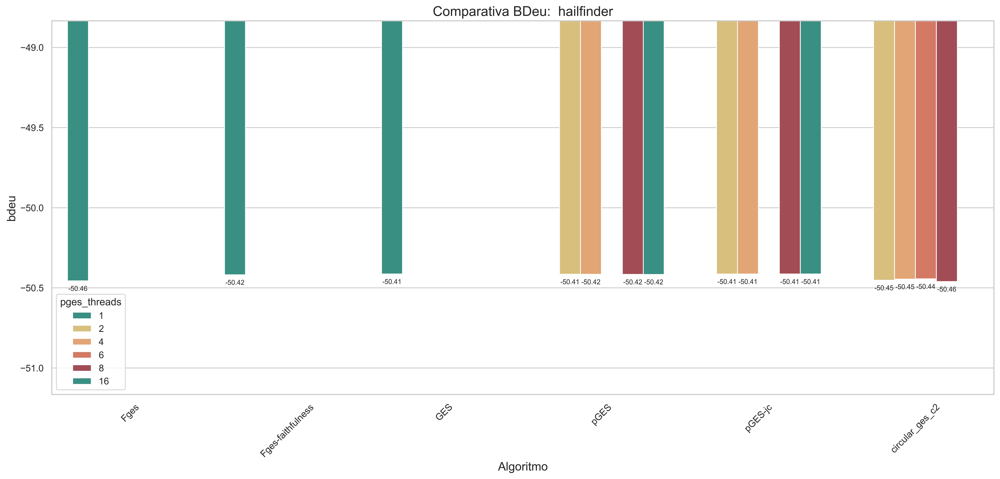

In [25]:
plot("hailfinder", "bdeu", 2, 8)

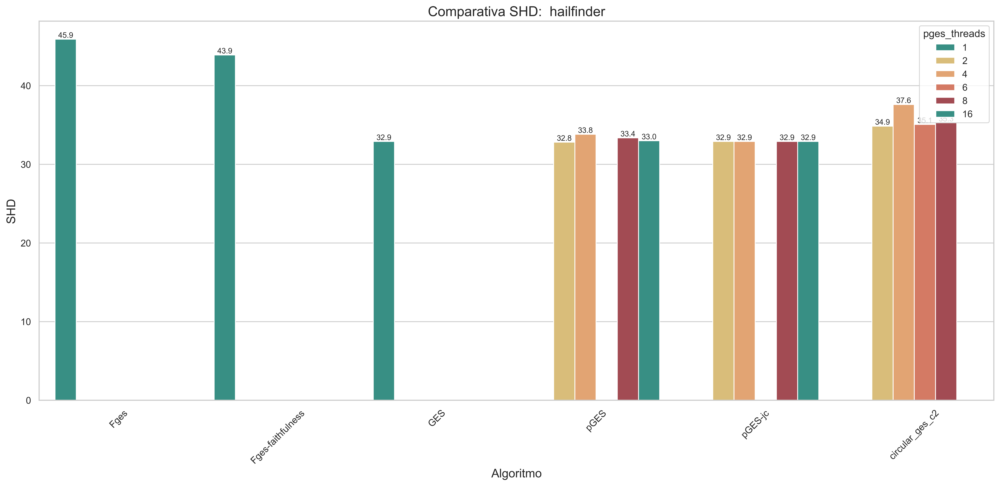

In [26]:
plot("hailfinder", "SHD", 1, 9)

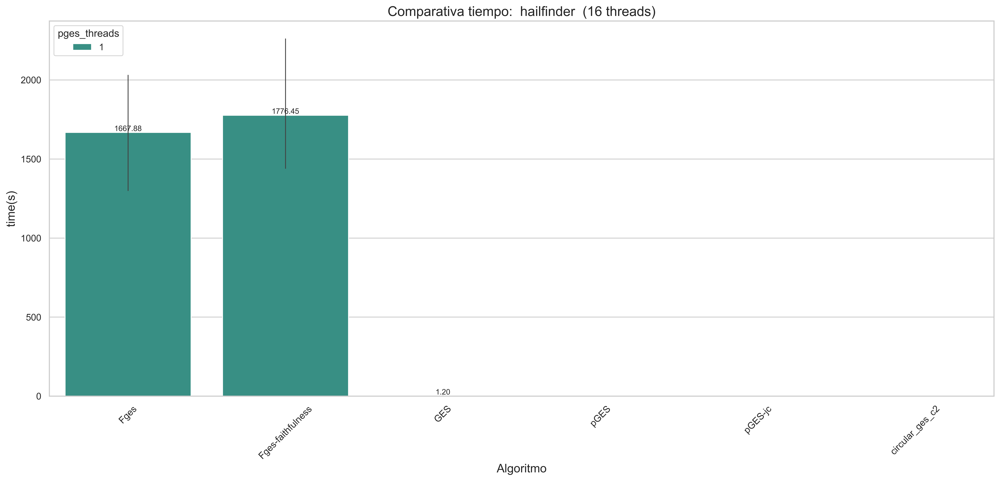

In [27]:
plot("hailfinder", "time(s)", 2, 9, threads=16)

## Pathfinder

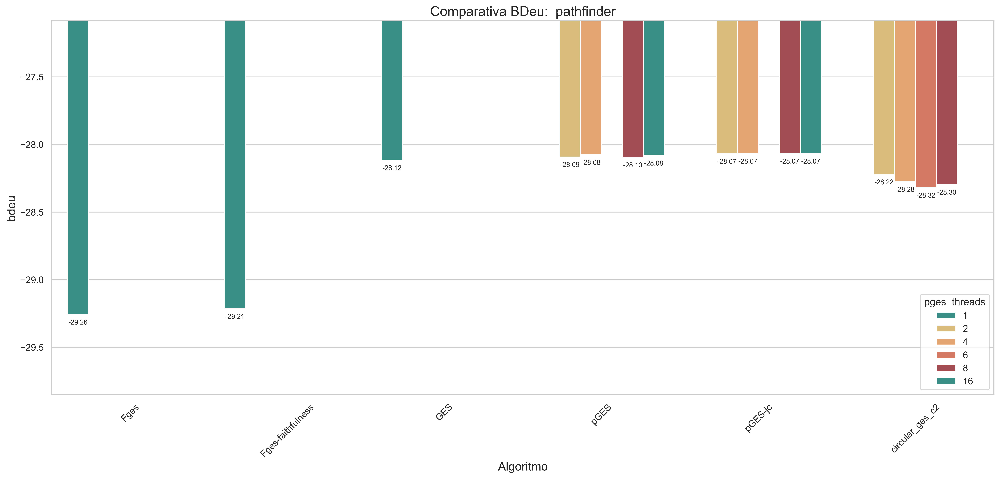

In [28]:
plot("pathfinder", "bdeu", 2, 8)

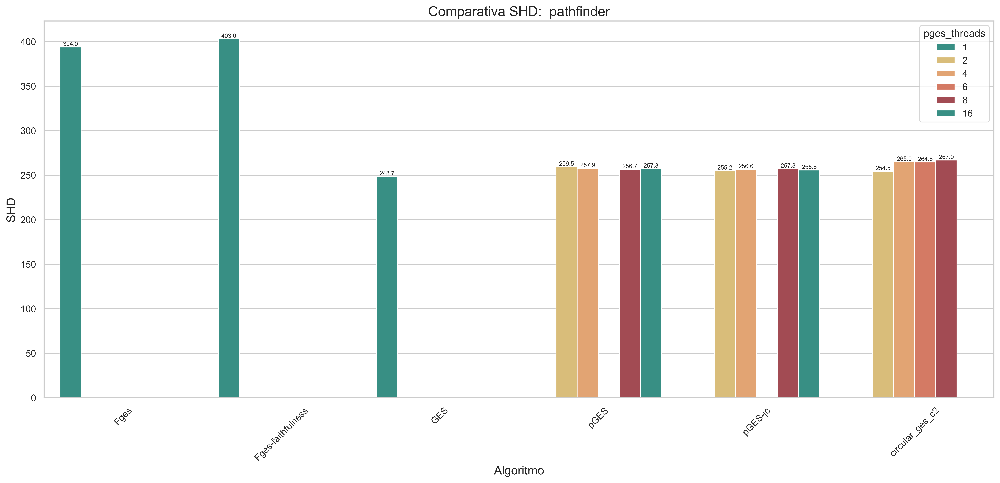

In [29]:
plot("pathfinder", "SHD", 1, 7)

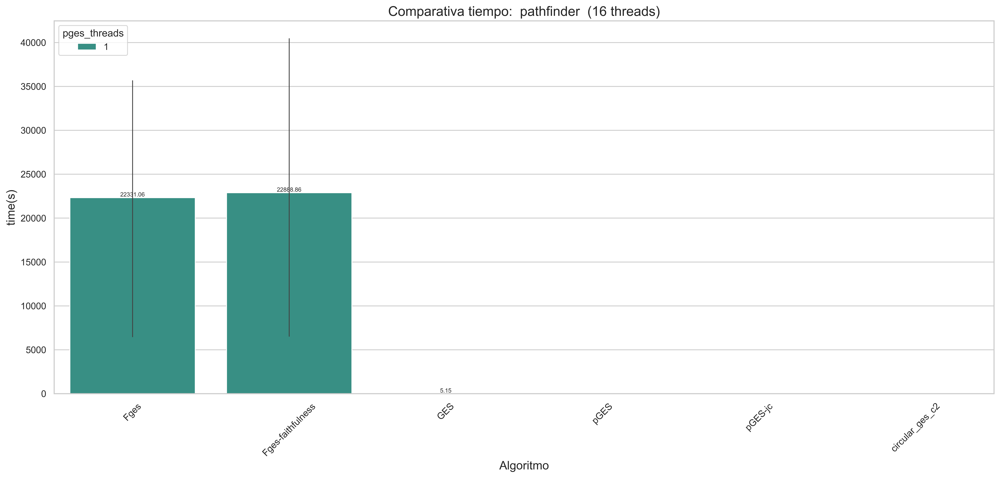

In [30]:
plot("pathfinder", "time(s)", 2, 7, threads=16)

## Andes

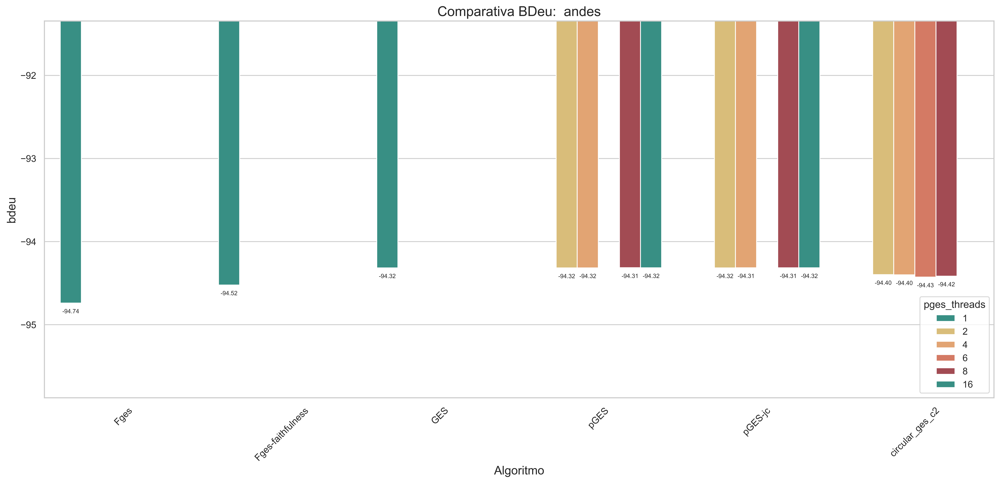

In [31]:
plot("andes", "bdeu", 2, 7)

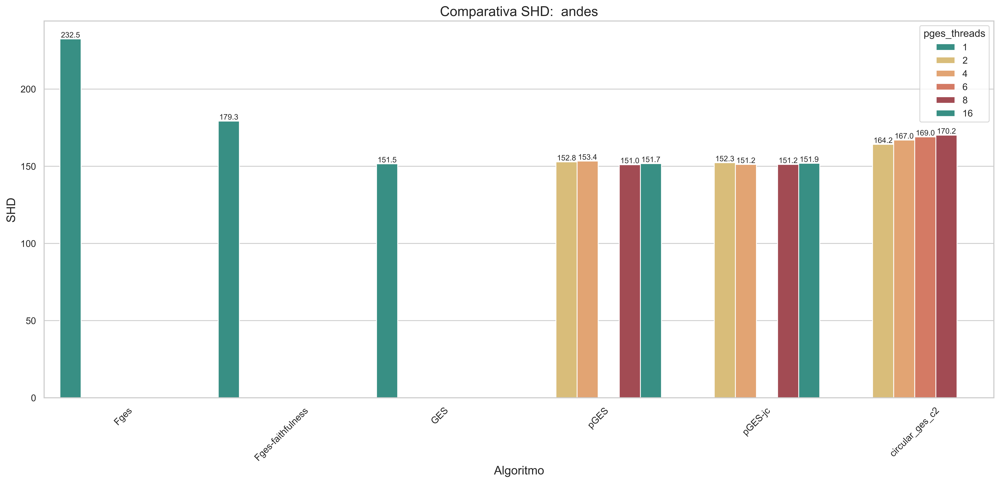

In [ ]:
plot("andes", "SHD", 1, 9)

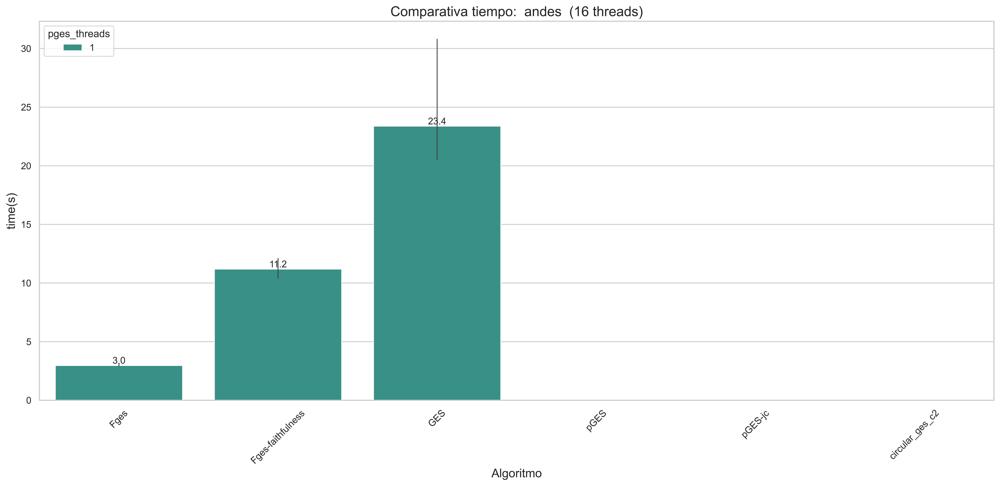

In [ ]:
plot("andes", "time(s)", 1, 11, threads=16)

## Diabetes

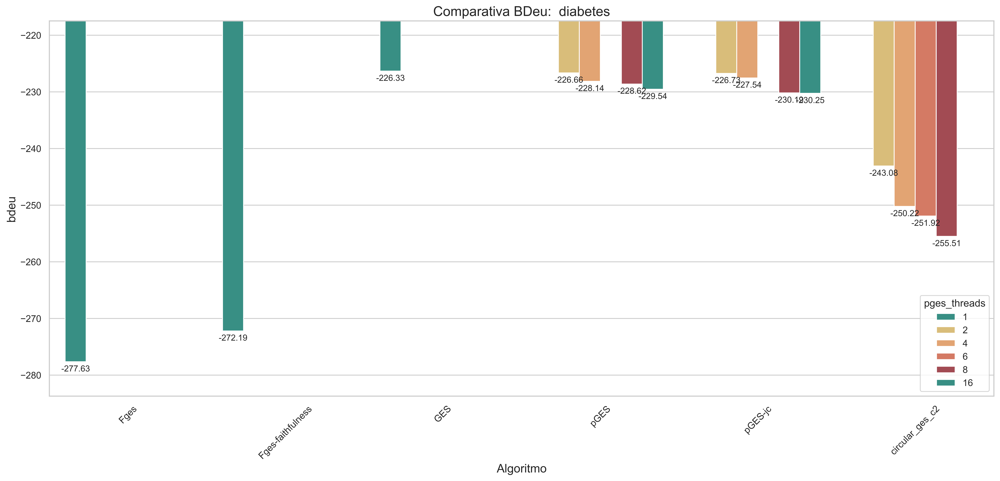

In [ ]:
plot("diabetes", "bdeu", 2, 10)

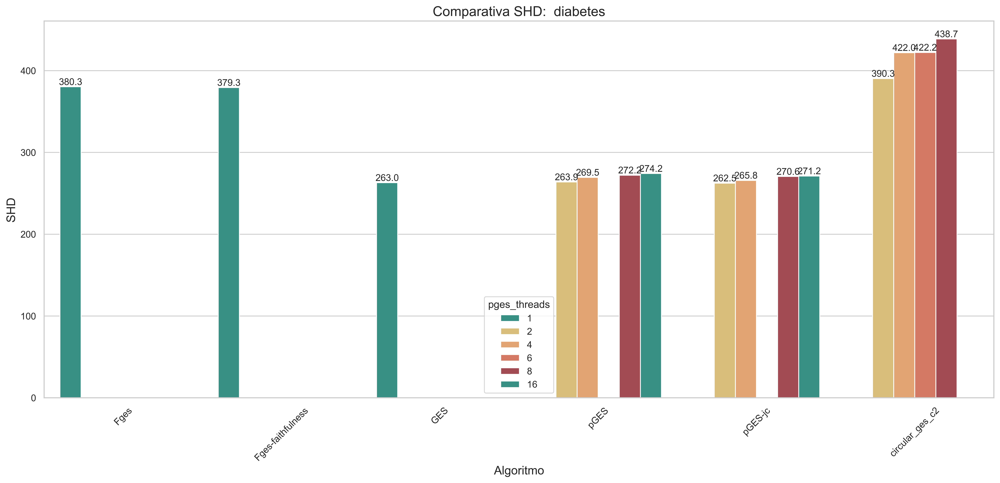

In [ ]:
plot("diabetes", "SHD", 1, 11)

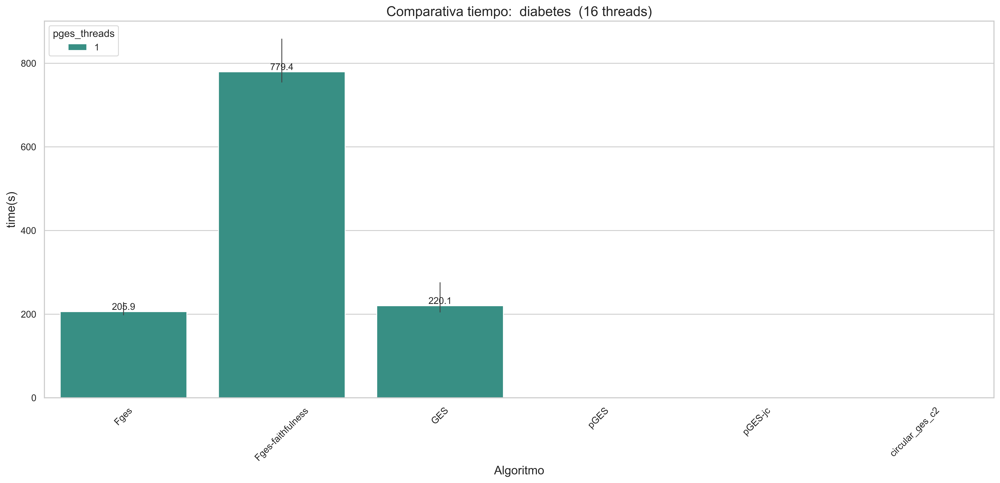

In [ ]:
plot("diabetes", "time(s)", 1, 11, threads=16)

## Pigs

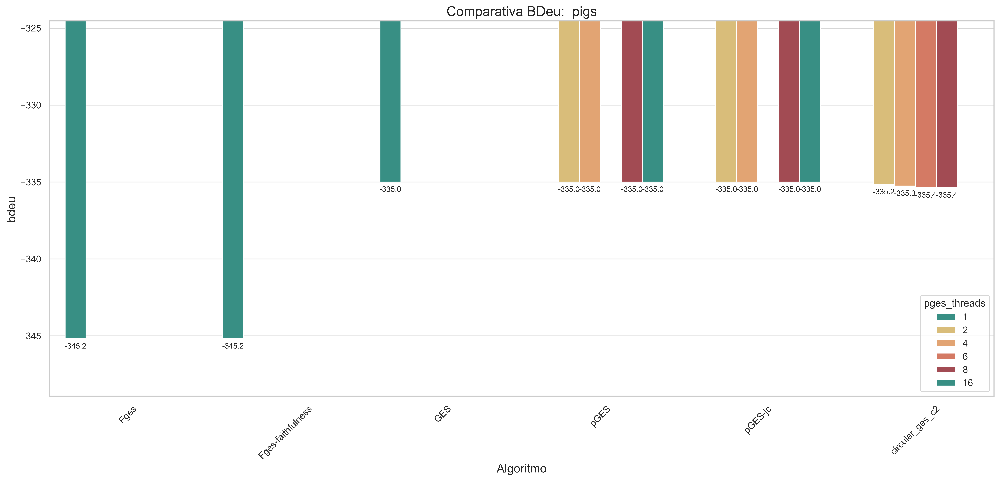

In [ ]:
plot("pigs", "bdeu", 1, 9)

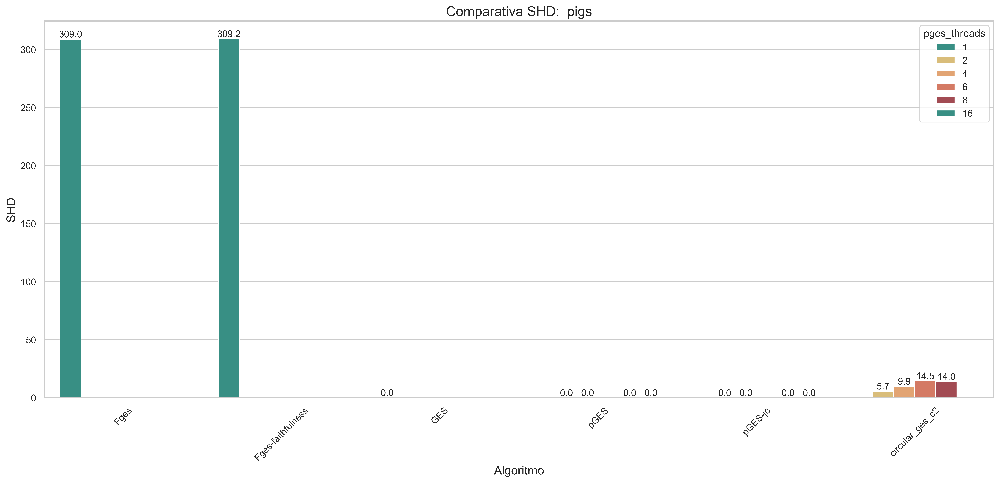

In [ ]:
plot("pigs", "SHD", 1, 11)

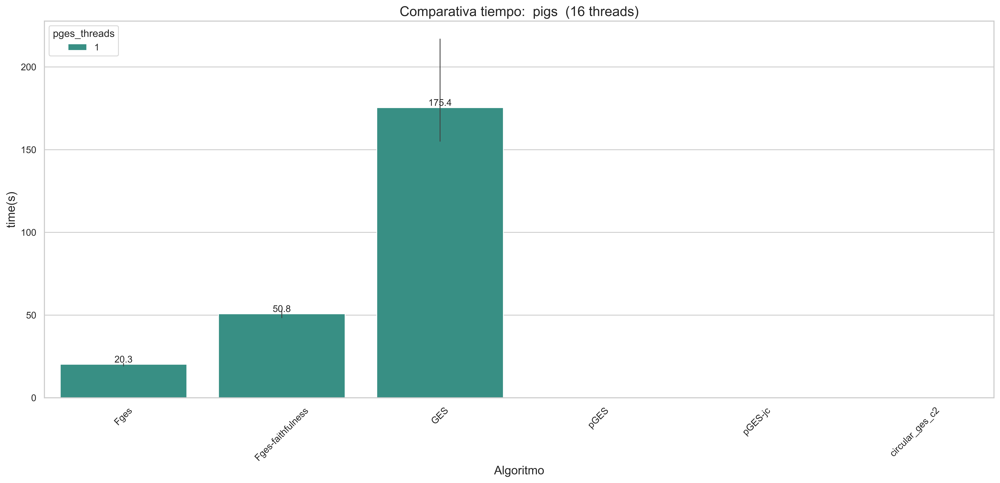

In [ ]:
plot("pigs", "time(s)", 1, 11, threads=16)

## Link

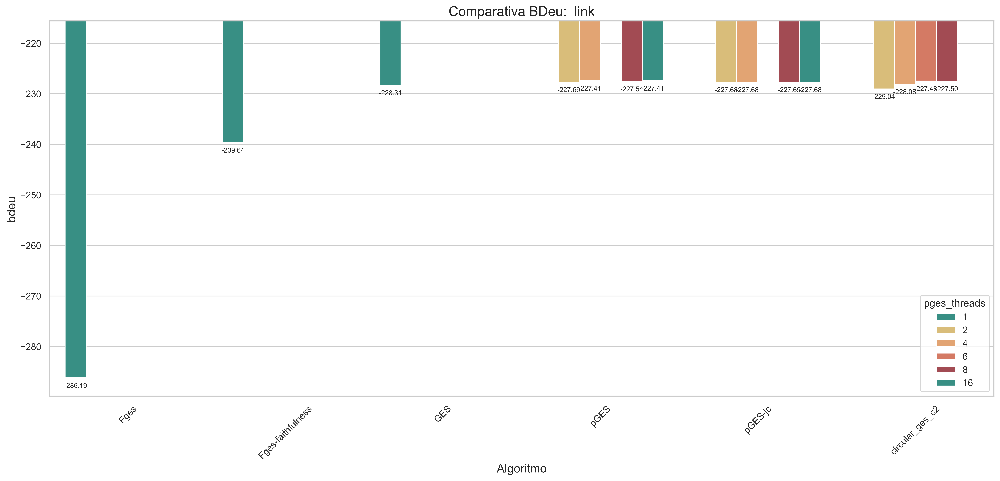

In [ ]:
plot("link", "bdeu", 2, 8)

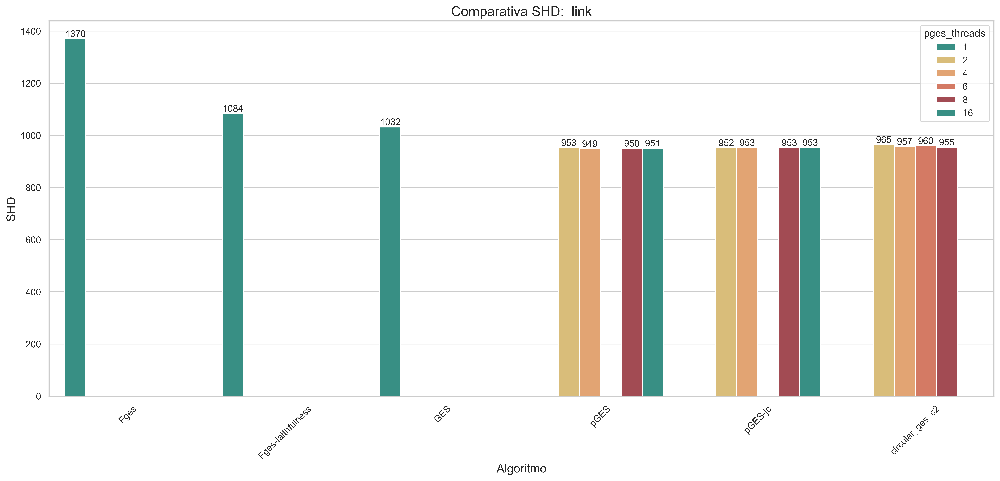

In [ ]:
plot("link", "SHD", 0, 11)

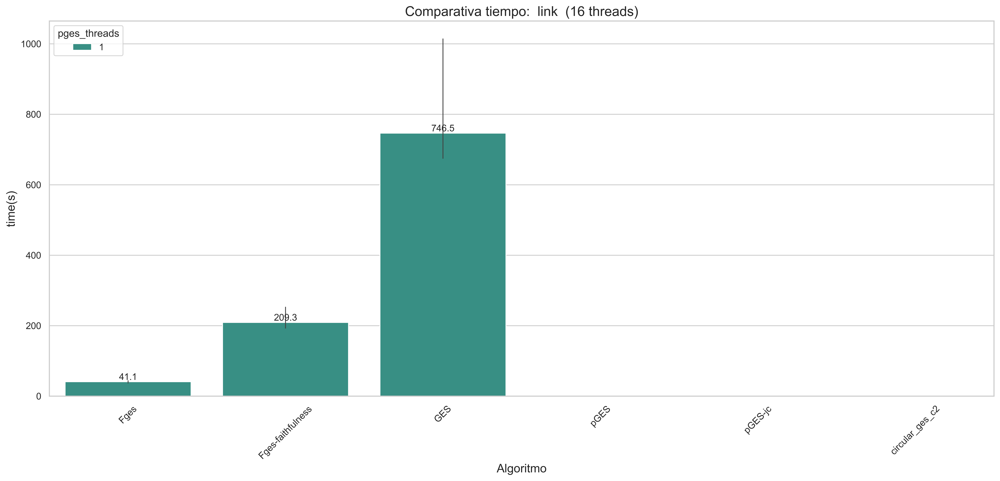

In [ ]:
plot("link", "time(s)", 1, 11, threads=16)

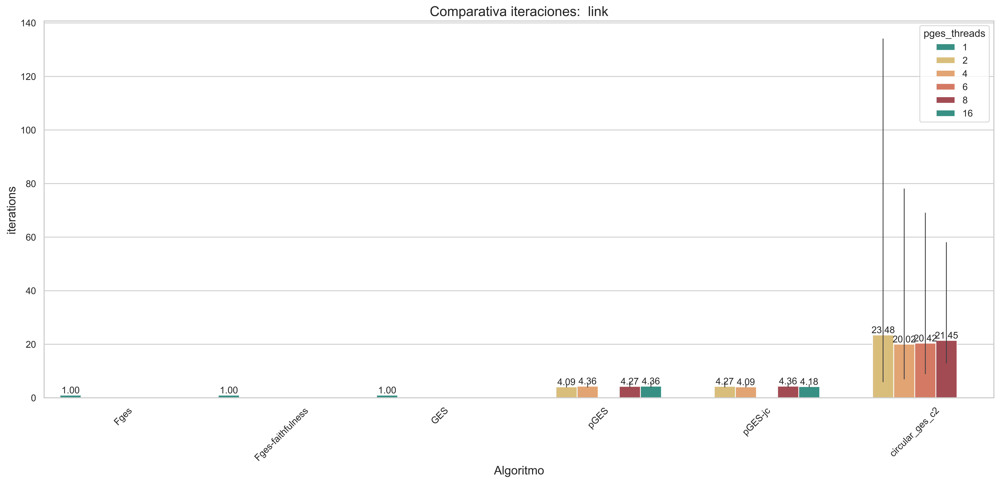

In [ ]:
plot("link", "iterations", 2, 11)

## Munin

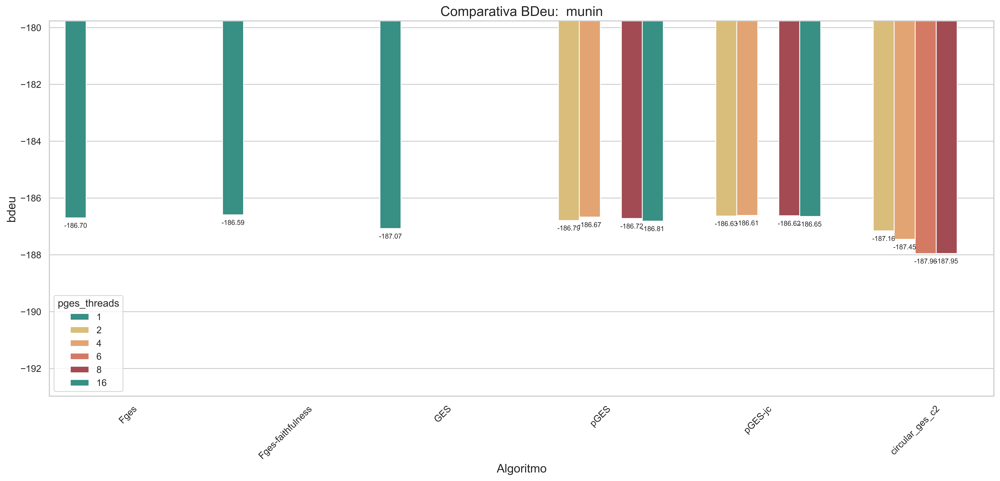

In [ ]:
plot("munin", "bdeu", 2, 8)

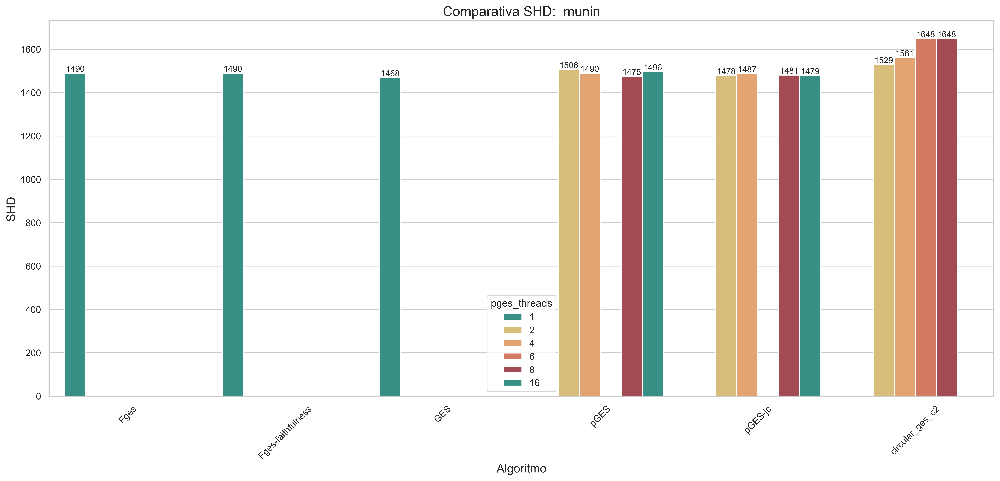

In [ ]:
plot("munin", "SHD", 0, 10)

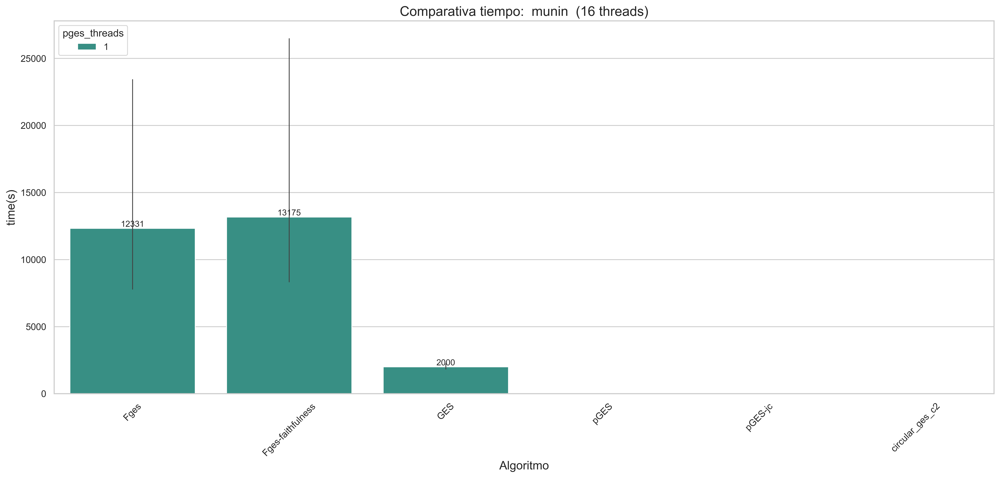

In [ ]:
plot("munin", "time(s)", 0, 10, threads=16)

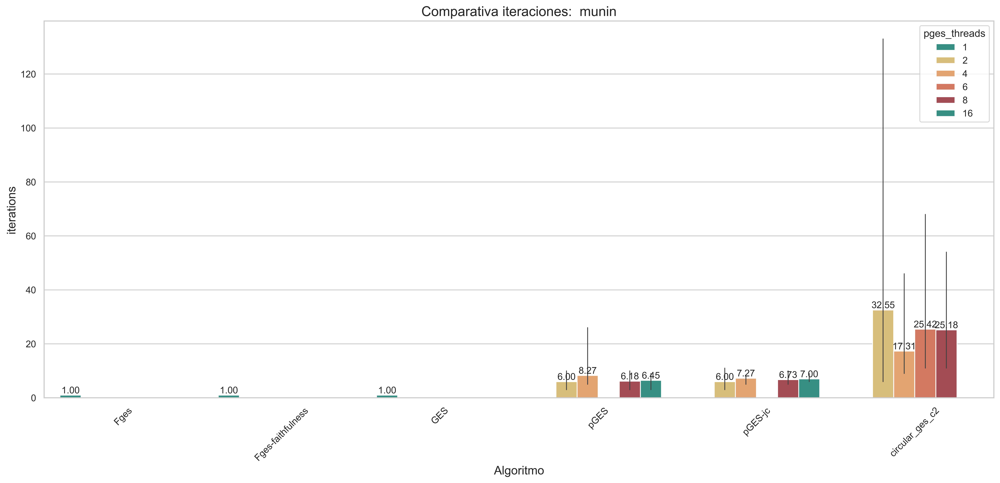

In [ ]:
plot("munin", "iterations", 2, 11)

# Tiempo / Búsqueda

In [ ]:
# Join all of csv files of the folder ../resultados, mantaining the header of the first file
path = r'../results/Resultados_definitivos/empty/' # use your path
all_files = glob.glob(os.path.join(path, "*.csv"))

df_from_each_file = (pd.read_csv(f, sep=',') for f in all_files)
df_empty = pd.concat(df_from_each_file, ignore_index=True)

df_empty.head()

,algorithm,network,bbdd,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMB,deltaMB+,deltaMB-,iterations,time(s)
0,empty,child,child.xbif50004_,8,1,-1,-1,30,-0.860044,-86158.872553,62.0,0.0,62.0,1,0.000
1,empty,water,water.xbif50006_,8,1,-1,-1,123,-0.527222,-85244.462145,288.0,0.0,288.0,1,0.000
2,empty,earthquake,earthquake.xbif50001_,8,1,-1,-1,5,-0.114153,-2899.567885,10.0,0.0,10.0,1,0.000
3,empty,andes,andes.xbif50003_,8,1,-1,-1,626,-0.549681,-613444.621445,1330.0,0.0,1330.0,1,0.026
4,empty,insurance,insurance.xbif50007_,8,1,-1,-1,70,-0.796667,-107494.005568,168.0,0.0,168.0,1,0.000


In [ ]:
df_empty['bdeu'] = df_empty['bdeu']  / 5000

In [ ]:
# Group by network
df_empty = df_empty.groupby(["network"], observed=True).mean()
df_empty

,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMB,deltaMB+,deltaMB-,iterations,time(s)
network,,,,,,,,,,,,
alarm,8.0,1.0,-1.0,-1.0,65.0,-0.551501,-20.575112,144.0,0.0,144.0,1.0,0.002727
andes,8.0,1.0,-1.0,-1.0,626.0,-0.549681,-122.758185,1330.0,0.0,1330.0,1.0,0.006636
barley,8.0,1.0,-1.0,-1.0,126.0,-0.152797,-81.040925,300.0,0.0,300.0,1.0,0.000273
child,8.0,1.0,-1.0,-1.0,30.0,-0.860044,-17.215301,62.0,0.0,62.0,1.0,0.000000
diabetes,8.0,1.0,-1.0,-1.0,819.0,0.000000,-748.997757,1734.0,0.0,1734.0,1.0,0.011000
earthquake,8.0,1.0,-1.0,-1.0,5.0,-0.114153,-0.600616,10.0,0.0,10.0,1.0,0.000000
hailfinder,8.0,1.0,-1.0,-1.0,99.0,-1.245294,-69.830323,206.0,0.0,206.0,1.0,0.000182
hepar2,8.0,1.0,-1.0,-1.0,158.0,-0.502290,-35.214330,466.0,0.0,466.0,1.0,0.001000
insurance,8.0,1.0,-1.0,-1.0,70.0,-0.651818,-21.549766,168.0,0.0,168.0,1.0,0.000000


## Delta BDeu Score

In [ ]:
# Create a new column in df with the difference of df["bdeu"] and the bdeu of their corresponding network in df_empty (df["network"] == df_empty.loc[df["network"], "bdeu"])
df["deltaBDeu"] = df["bdeu"] - df["network"].map(df_empty["bdeu"])

In [ ]:
df_unstack = df_empty.drop(["interleaving", "seed", "SHD", "loglike", "time(s)", "deltaMB", "deltaMB+", "deltaMB-", "iterations"], axis=1)
df_unstack.groupby(["network", "threads", "pges_threads"], observed=True).mean().unstack(0)

bdeu                                                \
network                   alarm       andes     barley      child    diabetes   
threads pges_threads                                                            
8.0     1.0          -20.575112 -122.758185 -81.040925 -17.215301 -748.997757   

                                                                             \
network              earthquake hailfinder    hepar2  insurance        link   
threads pges_threads                                                          
8.0     1.0           -0.600616 -69.830323 -35.21433 -21.549766 -410.458881   

                                                                              \
network                  mildew      munin pathfinder        pigs      water   
threads pges_threads                                                           
8.0     1.0          -62.425935 -345.32911 -62.284031 -459.757121 -16.992854   

                                 
network                win95pts  
threads pges_threads             
8.0     1.0          -19.096872

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

bdeu                        \
network                                     alarm      andes     barley   
algorithm         threads pges_threads                                    
Fges              8       1            -10.788383 -94.740114 -53.357547   
Fges-faithfulness 8       1            -10.788383 -94.523032 -52.838533   
Fges-ges          8       1            -10.790218 -94.520367 -52.829682   
GES               8       1            -10.873071 -94.316279 -53.223129   
GES-new           8       1            -10.872212 -94.316279 -53.223129   
circular_ges_c2   8       2            -10.796527 -94.397149 -52.836402   
                          4            -10.807062 -94.400522 -53.024158   
                          6            -10.818790 -94.427218 -52.784990   
                          8            -10.806100 -94.415681 -53.116403   
pGES              8       2            -10.789202 -94.317145 -52.800118   
                          4            -10.787501 -94.316678 -52.959689   
                          8            -10.787846 -94.314761 -52.917580   
                          16           -10.787357 -94.315374 -53.231814   
pGES-jc           8       2            -10.788219 -94.316018 -52.816724   
                          4            -10.788722 -94.314834 -52.803980   
                          8            -10.788722 -94.314840 -52.820143   
                          16           -10.792013 -94.315887 -52.793388   

                                                                          \
network                                     child    diabetes hailfinder   
algorithm         threads pges_threads                                     
Fges              8       1            -12.458725 -277.629849 -50.456310   
Fges-faithfulness 8       1            -12.454962 -272.192190 -50.418335   
Fges-ges          8       1            -12.454962 -245.982270 -50.430066   
GES               8       1            -12.469196 -226.328180 -50.413431   
GES-new           8       1            -12.469196 -226.328180 -50.413431   
circular_ges_c2   8       2            -12.426740 -243.079908 -50.452607   
                          4            -12.437481 -250.219352 -50.445711   
                          6            -12.434507 -251.921098 -50.443678   
                          8            -12.485318 -255.505853 -50.460743   
pGES              8       2            -12.425288 -226.657539 -50.414648   
                          4            -12.427016 -228.142666 -50.415452   
                          8            -12.428826 -228.617861 -50.416063   
                          16           -12.423665 -229.537223 -50.416204   
pGES-jc           8       2            -12.450807 -226.730426 -50.413431   
                          4            -12.436169 -227.541601 -50.413431   
                          8            -12.423665 -230.187850 -50.413431   
                          16           -12.428307 -230.254337 -50.413431   

                                                                          \
network                                    hepar2  insurance        link   
algorithm         threads pges_threads                                     
Fges              8       1            -33.000432 -13.558246 -286.187711   
Fges-faithfulness 8       1            -32.993694 -13.552390 -239.640090   
Fges-ges          8       1            -32.993694 -13.547209 -239.226295   
GES               8       1            -32.962535 -13.562299 -228.305646   
GES-new           8       1            -32.962535 -13.562299 -228.235095   
circular_ges_c2   8       2            -32.963873 -13.552167 -229.035898   
                          4            -32.963282 -13.574346 -228.079938   
                          6            -32.968217 -13.578833 -227.476739   
                          8            -32.968905 -13.570923 -227.500119   
pGES              8       2            -32.960917 -13.555299 -227.686540   
                          4        

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "loglike", "bdeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

deltaBDeu                        \
network                                    alarm      andes     barley   
algorithm         threads pges_threads                                   
Fges              8       1             9.786729  28.018071  27.683379   
Fges-faithfulness 8       1             9.786729  28.235153  28.202392   
Fges-ges          8       1             9.784894  28.237818  28.211243   
GES               8       1             9.702041  28.441906  27.817796   
GES-new           8       1             9.702900  28.441906  27.817796   
circular_ges_c2   8       2             9.778585  28.361036  28.204523   
                          4             9.768050  28.357663  28.016767   
                          6             9.756322  28.330967  28.255935   
                          8             9.769012  28.342504  27.924522   
pGES              8       2             9.785910  28.441040  28.240807   
                          4             9.787611  28.441507  28.081236   
                          8             9.787266  28.443424  28.123346   
                          16            9.787755  28.442811  27.809111   
pGES-jc           8       2             9.786893  28.442167  28.224201   
                          4             9.786390  28.443351  28.236945   
                          8             9.786390  28.443345  28.220782   
                          16            9.783099  28.442298  28.247537   

                                                                         \
network                                    child    diabetes hailfinder   
algorithm         threads pges_threads                                    
Fges              8       1             4.756576  471.367908  19.374013   
Fges-faithfulness 8       1             4.760339  476.805566  19.411988   
Fges-ges          8       1             4.760339  503.015487  19.400258   
GES               8       1             4.746105  522.669576  19.416892   
GES-new           8       1             4.746105  522.669576  19.416892   
circular_ges_c2   8       2             4.788561  505.917848  19.377716   
                          4             4.777819  498.778404  19.384612   
                          6             4.780794  497.076658  19.386645   
                          8             4.729983  493.491904  19.369580   
pGES              8       2             4.790012  522.340218  19.415675   
                          4             4.788285  520.855090  19.414872   
                          8             4.786475  520.379896  19.414261   
                          16            4.791635  519.460533  19.414119   
pGES-jc           8       2             4.764494  522.267331  19.416892   
                          4             4.779131  521.456156  19.416892   
                          8             4.791635  518.809906  19.416892   
                          16            4.786993  518.743420  19.416892   

                                                                        \
network                                   hepar2 insurance        link   
algorithm         threads pges_threads                                   
Fges              8       1             2.213899  7.991520  124.271170   
Fges-faithfulness 8       1             2.220637  7.997376  170.818790   
Fges-ges          8       1             2.220637  8.002557  171.232585   
GES               8       1             2.251796  7.987467  182.153235   
GES-new           8       1             2.251796  7.987467  182.223785   
circular_ges_c2   8       2             2.250458  7.997598  181.422983   
                          4             2.251048  7.975420  182.378942   
                          6             2.246113  7.970933  182.982142   
                          8             2.245426  7.978843  182.958762   
pGES              8       2             2.253414  7.994467  182.772341   
                          4             2.253487  7.995372  183.044350   
                     

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "loglike", "bdeu", "deltaBDeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

time(s)                        \
network                                    alarm      andes     barley   
algorithm         threads pges_threads                                   
Fges              8       1             0.965727   2.971727   4.732455   
Fges-faithfulness 8       1             1.247000  11.185909  13.225545   
Fges-ges          8       1             1.908818  22.393636  21.433818   
GES               8       1             0.895455  23.378000   2.020364   
GES-new           8       1             0.890455  23.975273   1.658909   
circular_ges_c2   8       2             1.239854  14.689601   2.881237   
                          4             1.513066  12.996576   2.591652   
                          6             1.820222  13.333652   3.771520   
                          8             2.054394  15.156020   4.731843   
pGES              8       2             1.038182   7.959182   2.163545   
                          4             1.139000   5.969636   1.866818   
                          8             1.001091   6.843636   2.249091   
                          16            1.260909   8.277273   2.401455   
pGES-jc           8       2             1.189636  10.848909   2.518000   
                          4             1.197818   6.994636   2.407364   
                          8             1.359818   7.205000   2.925364   
                          16            1.325909   8.605091   2.220455   

                                                                            \
network                                    child     diabetes   hailfinder   
algorithm         threads pges_threads                                       
Fges              8       1             5.228364   205.939909  1667.880636   
Fges-faithfulness 8       1             6.442273   779.395273  1776.449545   
Fges-ges          8       1             6.213455  4531.166727  7474.764455   
GES               8       1             0.364364   220.060273     1.199455   
GES-new           8       1             0.426091   235.103455     1.642273   
circular_ges_c2   8       2             0.786187   303.687061     1.761540   
                          4             0.962030   282.930424     2.152561   
                          6             1.180924   287.021157     2.652606   
                          8             1.298889   324.965969     3.111818   
pGES              8       2             0.721182   143.066182     1.213455   
                          4             0.776818   108.624909     1.224364   
                          8             0.828909    89.900273     1.198545   
                          16            1.083364   119.341636     1.365273   
pGES-jc           8       2             0.649455   198.281455     1.524000   
                          4             0.720364   176.679000     1.400909   
                          8             0.885909   132.018909     1.629273   
                          16            1.028455   128.889545     1.670273   

                                                                        \
network                                   hepar2 insurance        link   
algorithm         threads pges_threads                                   
Fges              8       1             0.812182  0.742182   41.115909   
Fges-faithfulness 8       1             1.850909  0.928455  209.260364   
Fges-ges          8       1             3.592909  1.497182  409.214727   
GES               8       1             1.332636  0.599091  746.542273   
GES-new           8       1             1.742273  0.629545  779.566545   
circular_ges_c2   8       2             1.923348  0.994636  459.427530   
                          4             2.047475  1.439955  331.223101   
                          6             2.627106  1.711813  332.046571   
                          8             3.019611  1.914571  348.836709   
pGES              8       2             1.272455  0.871818  292.689182   
                          4          

In [ ]:
# Create a new column with the division of deltaBDeu by the time(s)
df["delta/s"] =  df["deltaBDeu"] / df["time(s)"]

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "loglike", "bdeu", "time(s)", "deltaBDeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

delta/s                       \
network                                     alarm     andes     barley   
algorithm         threads pges_threads                                   
Fges              8       1             10.524680  9.431851   6.095499   
Fges-faithfulness 8       1              8.106415  2.529201   2.313831   
Fges-ges          8       1              5.364127  1.261649   1.363075   
GES               8       1             11.536228  1.228473  14.004456   
GES-new           8       1             11.013912  1.187326  16.926078   
circular_ges_c2   8       2              8.013086  2.028450  10.665579   
                          4              6.652119  2.267860  11.124807   
                          6              5.552775  2.188652   7.850547   
                          8              4.869087  1.932760   6.065526   
pGES              8       2             10.018363  3.621200  13.580241   
                          4              8.977253  4.787862  15.287032   
                          8             10.009965  4.293394  12.975266   
                          16             8.290502  3.536529  11.954074   
pGES-jc           8       2              8.496485  2.675946  11.505112   
                          4              8.657149  4.088178  12.265047   
                          8              7.415665  3.983327  10.561992   
                          16             7.688286  3.344382  13.123258   

                                                                        \
network                                     child  diabetes hailfinder   
algorithm         threads pges_threads                                   
Fges              8       1              1.075788  2.291988   0.011812   
Fges-faithfulness 8       1              0.844893  0.612618   0.011073   
Fges-ges          8       1              0.884099  0.111027   0.002680   
GES               8       1             13.632867  2.392431  16.981519   
GES-new           8       1             11.710989  2.226287  12.086689   
circular_ges_c2   8       2              6.226656  1.795686  11.228007   
                          4              5.057705  1.999300   9.216432   
                          6              4.179208  2.006825   8.241454   
                          8              3.746385  1.829998   6.803523   
pGES              8       2              6.797941  3.690007  16.453964   
                          4              6.478862  4.830231  16.600169   
                          8              6.114455  5.812867  16.475327   
                          16             4.840616  4.411158  14.418836   
pGES-jc           8       2              7.558028  2.702118  13.269388   
                          4              6.716241  2.989616  14.189616   
                          8              5.642569  3.965621  12.210812   
                          16             5.313605  4.048894  11.829512   

                                                                       \
network                                   hepar2  insurance      link   
algorithm         threads pges_threads                                  
Fges              8       1             2.762322  11.070529  3.029019   
Fges-faithfulness 8       1             1.209235   8.777315  0.820401   
Fges-ges          8       1             0.630818   6.530751  0.441203   
GES               8       1             1.725317  13.674229  0.247242   
GES-new           8       1             1.312142  12.946295  0.234078   
circular_ges_c2   8       2             1.190682   8.149739  0.423158   
                          4             1.130548   5.693126  0.582494   
                          6             0.875323   4.764331  0.581355   
                          8             0.764527   4.317742  0.555594   
pGES              8       2             1.793397   9.425036  0.627141   
                          4             1.751469   9.437506  1.030749   
                          8             1.668222   8.55033

## Delta SHD

In [ ]:
# Create a new column in df with the difference of df["bdeu"] and the bdeu of their corresponding network in df_empty (df["network"] == df_empty.loc[df["network"], "bdeu"])
df["deltaSHD"] = df["network"].map(df_empty["SHD"]) - df["SHD"]

In [ ]:
df_unstack = df_empty.drop(["interleaving", "seed", "bdeu", "loglike", "time(s)", "deltaMB", "deltaMB+", "deltaMB-", "iterations"], axis=1)
df_unstack.groupby(["network", "threads", "pges_threads"], observed=True).mean().unstack(0)

SHD                                                     \
network              alarm  andes barley child diabetes earthquake hailfinder   
threads pges_threads                                                            
8.0     1.0           65.0  626.0  126.0  30.0    819.0        5.0       99.0   

                                                                         \
network              hepar2 insurance    link mildew   munin pathfinder   
threads pges_threads                                                      
8.0     1.0           158.0      70.0  1738.0   80.0  1843.0      208.0   

                                             
network                pigs  water win95pts  
threads pges_threads                         
8.0     1.0           806.0  123.0    225.0

### Distancia frente a la red perfecta

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

SHD                         \
network                                     alarm       andes     barley   
algorithm         threads pges_threads                                     
Fges              8       1              7.909091  232.454545  59.545455   
Fges-faithfulness 8       1              7.909091  179.272727  55.909091   
Fges-ges          8       1              8.000000  180.000000  57.545455   
GES               8       1              9.272727  151.545455  61.181818   
GES-new           8       1              9.090909  151.545455  61.181818   
circular_ges_c2   8       2              8.838384  164.191919  57.318182   
                          4             11.722222  166.984848  61.287879   
                          6             12.439394  168.994949  57.818182   
                          8             11.545455  170.156566  65.010101   
pGES              8       2              8.090909  152.818182  56.000000   
                          4              7.545455  153.363636  57.909091   
                          8              7.545455  151.000000  60.454545   
                          16             7.272727  151.727273  60.545455   
pGES-jc           8       2              7.272727  152.272727  56.454545   
                          4              7.363636  151.181818  56.454545   
                          8              7.363636  151.181818  56.454545   
                          16             7.545455  151.909091  56.090909   

                                                                         \
network                                    child    diabetes hailfinder   
algorithm         threads pges_threads                                    
Fges              8       1             5.363636  380.272727  45.909091   
Fges-faithfulness 8       1             4.454545  379.272727  43.909091   
Fges-ges          8       1             4.454545  321.454545  43.909091   
GES               8       1             8.272727  263.000000  32.909091   
GES-new           8       1             8.272727  263.000000  32.909091   
circular_ges_c2   8       2             1.191919  390.318182  34.858586   
                          4             2.626263  421.989899  37.611111   
                          6             2.580808  422.218274  35.075758   
                          8             5.656566  438.728205  35.282828   
pGES              8       2             1.000000  263.909091  32.818182   
                          4             1.181818  269.454545  33.818182   
                          8             1.727273  272.181818  33.363636   
                          16            0.818182  274.181818  33.000000   
pGES-jc           8       2             4.454545  262.454545  32.909091   
                          4             2.363636  265.818182  32.909091   
                          8             0.818182  270.636364  32.909091   
                          16            1.545455  271.181818  32.909091   

                                                                           \
network                                    hepar2  insurance         link   
algorithm         threads pges_threads                                      
Fges              8       1             92.181818  23.818182  1370.454545   
Fges-faithfulness 8       1             87.000000  22.818182  1083.727273   
Fges-ges          8       1             87.000000  22.545455  1094.272727   
GES               8       1             76.545455  24.909091  1032.363636   
GES-new           8       1             76.545455  24.909091  1030.636364   
circular_ges_c2   8       2             76.929293  23.848485   964.919192   
                          4             75.469697  26.136364   957.313131   
                          6             76.979798  26.060606   960.095960   
                          8             77.898990  24.530303   955.214286   
pGES              8       2             75.636364  23.272727   952.818182   
                       

### Distancia fente a la red vacía

In [ ]:
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "deltaBDeu", "loglike", "bdeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

deltaSHD                         \
network                                     alarm       andes     barley   
algorithm         threads pges_threads                                     
Fges              8       1             57.090909  393.545455  66.454545   
Fges-faithfulness 8       1             57.090909  446.727273  70.090909   
Fges-ges          8       1             57.000000  446.000000  68.454545   
GES               8       1             55.727273  474.454545  64.818182   
GES-new           8       1             55.909091  474.454545  64.818182   
circular_ges_c2   8       2             56.161616  461.808081  68.681818   
                          4             53.277778  459.015152  64.712121   
                          6             52.560606  457.005051  68.181818   
                          8             53.454545  455.843434  60.989899   
pGES              8       2             56.909091  473.181818  70.000000   
                          4             57.454545  472.636364  68.090909   
                          8             57.454545  475.000000  65.545455   
                          16            57.727273  474.272727  65.454545   
pGES-jc           8       2             57.727273  473.727273  69.545455   
                          4             57.636364  474.818182  69.545455   
                          8             57.636364  474.818182  69.545455   
                          16            57.454545  474.090909  69.909091   

                                                                          \
network                                     child    diabetes hailfinder   
algorithm         threads pges_threads                                     
Fges              8       1             24.636364  438.727273  53.090909   
Fges-faithfulness 8       1             25.545455  439.727273  55.090909   
Fges-ges          8       1             25.545455  497.545455  55.090909   
GES               8       1             21.727273  556.000000  66.090909   
GES-new           8       1             21.727273  556.000000  66.090909   
circular_ges_c2   8       2             28.808081  428.681818  64.141414   
                          4             27.373737  397.010101  61.388889   
                          6             27.419192  396.781726  63.924242   
                          8             24.343434  380.271795  63.717172   
pGES              8       2             29.000000  555.090909  66.181818   
                          4             28.818182  549.545455  65.181818   
                          8             28.272727  546.818182  65.636364   
                          16            29.181818  544.818182  66.000000   
pGES-jc           8       2             25.545455  556.545455  66.090909   
                          4             27.636364  553.181818  66.090909   
                          8             29.181818  548.363636  66.090909   
                          16            28.454545  547.818182  66.090909   

                                                                          \
network                                    hepar2  insurance        link   
algorithm         threads pges_threads                                     
Fges              8       1             65.818182  46.181818  367.545455   
Fges-faithfulness 8       1             71.000000  47.181818  654.272727   
Fges-ges          8       1             71.000000  47.454545  643.727273   
GES               8       1             81.454545  45.090909  705.636364   
GES-new           8       1             81.454545  45.090909  707.363636   
circular_ges_c2   8       2             81.070707  46.151515  773.080808   
                          4             82.530303  43.863636  780.686869   
                          6             81.020202  43.939394  777.904040   
                          8             80.101010  45.469697  782.785714   
pGES              8       2             82.363636  46.727273  785.181818   
           

### "Porcentaje de SHD" que el algoritmo consigue alcanzar

In [ ]:
# Divide the deltaSHD by the empty SHD of df_empty
df["deltaSHD/emptySHD"] = df["deltaSHD"] / df["network"].map(df_empty["SHD"])
df["deltaSHD/emptySHD"] = df["deltaSHD/emptySHD"] * 100
df_unstack = df.drop(["bbdd", "interleaving", "seed", "SHD", "deltaBDeu", "loglike", "bdeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads"], observed=True).mean().unstack(0)

deltaSHD/emptySHD             \
network                                            alarm      andes   
algorithm         threads pges_threads                                
Fges              8       1                    87.832168  62.866686   
Fges-faithfulness 8       1                    87.832168  71.362184   
Fges-ges          8       1                    87.692308  71.246006   
GES               8       1                    85.734266  75.791461   
GES-new           8       1                    86.013986  75.791461   
circular_ges_c2   8       2                    86.402486  73.771259   
                          4                    81.965812  73.325104   
                          6                    80.862471  73.004002   
                          8                    82.237762  72.818440   
pGES              8       2                    87.552448  75.588150   
                          4                    88.391608  75.501017   
                          8                    88.391608  75.878594   
                          16                   88.811189  75.762416   
pGES-jc           8       2                    88.811189  75.675283   
                          4                    88.671329  75.849550   
                          8                    88.671329  75.849550   
                          16                   88.391608  75.733372   

                                                                         \
network                                    barley      child   diabetes   
algorithm         threads pges_threads                                    
Fges              8       1             52.741703  82.121212  53.568654   
Fges-faithfulness 8       1             55.627706  85.151515  53.690754   
Fges-ges          8       1             54.329004  85.151515  60.750361   
GES               8       1             51.443001  72.424242  67.887668   
GES-new           8       1             51.443001  72.424242  67.887668   
circular_ges_c2   8       2             54.509380  96.026936  52.342102   
                          4             51.358826  91.245791  48.474982   
                          6             54.112554  91.397306  48.447097   
                          8             48.404682  81.144781  46.431233   
pGES              8       2             55.555556  96.666667  67.776668   
                          4             54.040404  96.060606  67.099567   
                          8             52.020202  94.242424  66.766567   
                          16            51.948052  97.272727  66.522367   
pGES-jc           8       2             55.194805  85.151515  67.954268   
                          4             55.194805  92.121212  67.543568   
                          8             55.194805  97.272727  66.955267   
                          16            55.483405  94.848485  66.888667   

                                                                         \
network                                hailfinder     hepar2  insurance   
algorithm         threads pges_threads                                    
Fges              8       1             53.627181  41.657077  65.974026   
Fges-faithfulness 8       1             55.647383  44.936709  67.402597   
Fges-ges          8       1             55.647383  44.936709  67.792208   
GES               8       1             66.758494  51.553510  64.415584   
GES-new           8       1             66.758494  51.553510  64.415584   
circular_ges_c2   8       2             64.789307  51.310574  65.930736   
                          4             62.008979  52.234369  62.662338   
                          6             64.569942  51.278609  62.770563   
                          8             64.360780  50.696842  64.956710   
pGES              8       2             66.850321  52.128884  66.753247   
                          4             65.840220  52.128884  64.805195   
                          8             66.299357  52.071346  61.94

# Gráficas deltas

In [ ]:
def plot(network, variable, precision, size, threads=8):    
    if (network != "all"):
        df_temp = df[df["network"] == network]
    else:
        df_temp = df
        network = "Todas las bases"
    
    paleta = color

    # Order of the bars: fges, ges, pges
    order = ["Fges", "Fges-faithfulness", "Fges-ges", "GES", "pGES", "pGES-jc"]

    # Gráfico de barras, sin leyenda (se crea después)
    if variable == "deltaSHD/emptySHD":
        ax = sns.barplot(data=df_temp, x="algorithm", hue="pges_threads",ci=None, y=variable, palette=paleta, order=order, errwidth=1)
        texto = "Relación entre el SHD obtenido y el de la red vacía:  " + network
    elif variable == "delta/s":
        ax = sns.barplot(data=df_temp, x="algorithm", hue="pges_threads", ci=None, y=variable, palette=paleta, order=order, errwidth=1)
        texto = "BDeu Score obtenida por unidad de tiempo:  " + network

    ax.set_title('Comparativa ' + texto, fontsize=16)
    ax.set_xlabel('Algoritmo', fontsize=14)
    ax.set_ylabel(variable, fontsize=14)

    # Imprimir valores de las barras en la parte superior
    for p in ax.patches:
        if not np.isnan(p.get_height()):
            altura = p.get_height()

            # Imprimir valores de las barras en la parte inferior
            ax.text(p.get_x() + p.get_width()/2., altura, ('{0:.'+str(precision)+'f}').format(p.get_height()), ha='center', va='bottom', fontsize=size) 
    
    # Rotar labels inferiores
    plt.xticks(rotation=45)
        
    plt.plot

## BDeu

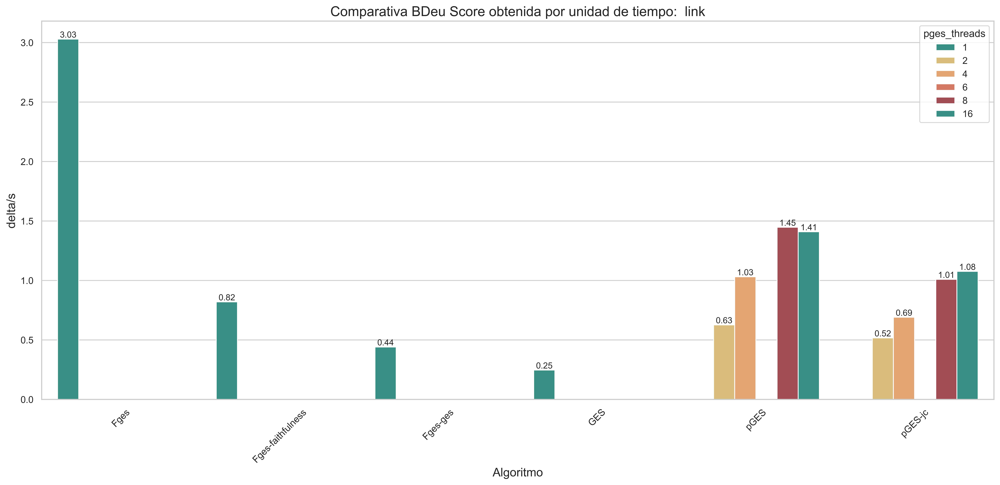

In [ ]:
plot("link", "delta/s", 2, 10)

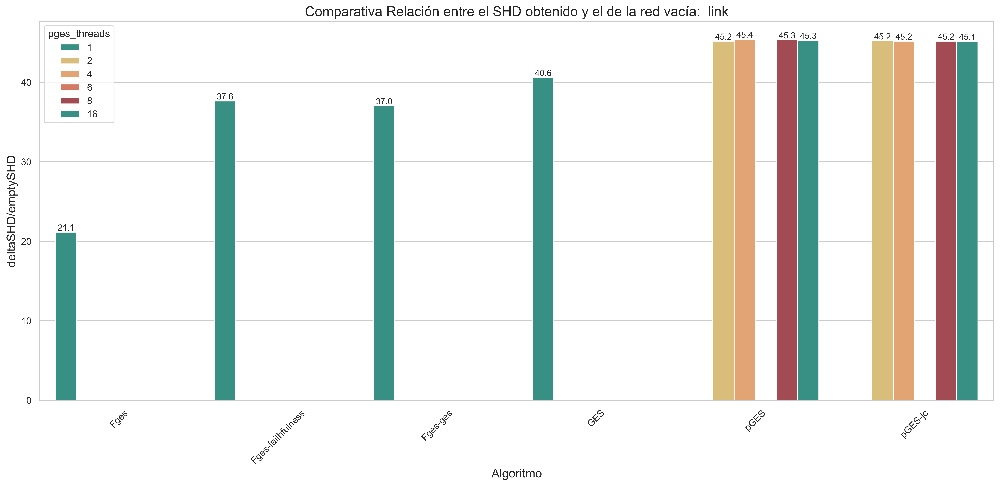

In [ ]:
plot("link", "deltaSHD/emptySHD", 1, 10)

## SHD

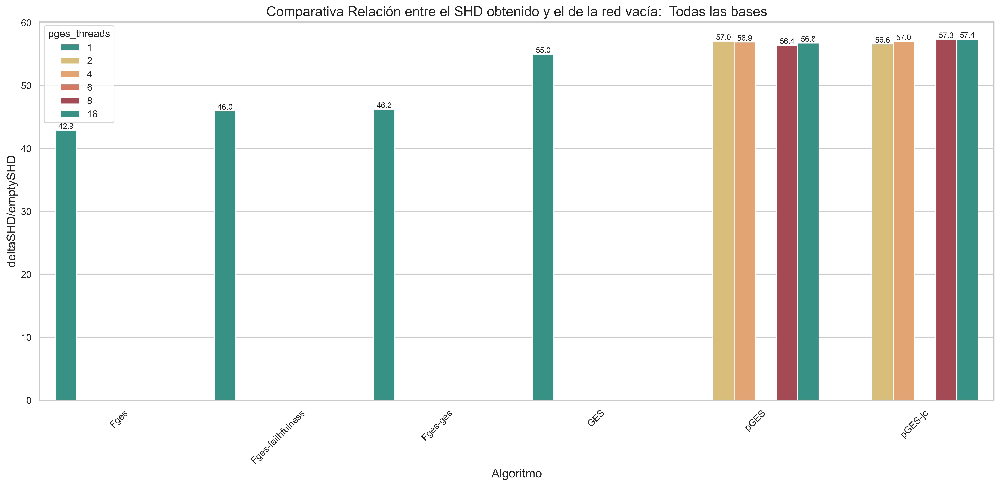

In [ ]:
plot("all", "deltaSHD/emptySHD", 1, 9)

# exreport

In [ ]:
df2 = df[df['algorithm'].isin([
    'Fges', 
    'Fges-faithfulness',
    #'Fges-ges',
    'GES',
    'circular_ges_c1',
    'circular_ges_c2',
    'circular_ges_c3',
    'circular_ges_c4'])]

df2 = df2.drop(["threads","seed","interleaving","iterations"], axis=1)

# Mean of all the bbdd
df2 = df2.groupby(["network", "algorithm", "pges_threads"], observed=True).mean().reset_index()

# Delete the character / from the header
df2.columns = df2.columns.str.replace('/', '')

# Redondear a 4 decimales
df2 = df2.round(4)

# Write csv 
df2.to_csv('./exreport/exreport.csv', index=False)

# Delete folder exreport_output and its content if exists
if os.path.exists('./exreport/exreport_output'):
    shutil.rmtree('./exreport/exreport_output')

# Execute exreport.r
os.system('Rscript ./exreport/exreport.r')

'data.frame':	103 obs. of  14 variables:
 $ network         : chr  "alarm" "alarm" "alarm" "alarm" ...
 $ algorithm       : chr  "Fges" "Fges-faithfulness" "GES" "circular_ges_c2" ...
 $ pges_threads    : int  1 1 1 2 4 6 8 1 1 1 ...
 $ SHD             : num  7.91 7.91 9.27 8.84 11.72 ...
 $ loglike         : num  -0.282 -0.282 -0.41 -0.376 -0.383 ...
 $ bdeu            : num  -10.8 -10.8 -10.9 -10.8 -10.8 ...
 $ deltaMM         : num  16.4 16.4 19.1 17.9 25.1 ...
 $ deltaMM.        : num  1.82 1.82 4.73 3.16 7.81 ...
 $ deltaMM..1      : num  14.5 14.5 14.4 14.7 17.3 ...
 $ time.s.         : num  0.966 1.247 0.895 1.24 1.513 ...
 $ deltaBDeu       : num  9.79 9.79 9.7 9.78 9.77 ...
 $ deltas          : num  10.52 8.11 11.54 8.01 6.65 ...
 $ deltaSHD        : num  57.1 57.1 55.7 56.2 53.3 ...
 $ deltaSHDemptySHD: num  87.8 87.8 85.7 86.4 82 ...
1 ) Experiment pGES loaded from a data set.

#Experiment name: pGES

#algorithm: circular_ges_c2, Fges, Fges-faithfulness, GES

#network: alarm

Warning message:
The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as
of ggplot2 3.3.4.
ℹ The deprecated feature was likely used in the exreport package.
  Please report the issue to the authors. 


[1] "Distribution of ranks for output \"bdeu\""
---------------------------------------------------------------------
Friedman test, objetive minimize output variable SHD. Obtained p-value: 9.6035e-03
Chi squared with 6 degrees of freedom statistic: 16.9143
Test rejected: p-value: 9.6035e-03 < 0.0500
---------------------------------------------------------------------
Control post hoc test for output SHD
Adjust method: Holm

Control method: circular_ges_c2,2
p-values:
          GES,1	0.7353
Fges-faithfulness,1	0.1384
circular_ges_c2,4	0.1384
circular_ges_c2,6	0.1384
circular_ges_c2,8	0.0203
         Fges,1	0.0106
---------------------------------------------------------------------
$testMultiple
                              algorithm     pvalue     rank win tie loss
circular_ges_c2,2     circular_ges_c2,2         NA 2.600000  NA  NA   NA
GES,1                             GES,1 0.73531669 2.866667   6   0    9
Fges-faithfulness,1 Fges-faithfulness,1 0.13844223 4.133333   9   0    6
ci

0

In [ ]:
# Order df by algorithm, network, bbdd, pges_threads
df = df.sort_values(by=["algorithm", "network", "bbdd", "pges_threads"])

In [ ]:
# pangouin t-test between pGES and pGES-jc for each pges_threads
for i in [2, 4, 8, 16]:
    df_temp = df[(df["pges_threads"] == i) | (df["pges_threads"] == 1)]
    df_temp = df_temp[df_temp["algorithm"].isin(["pGES", "pGES-jc"])]
    print("\n\n- pGES vs pGES-jc, pges_threads = " + str(i))

    # SHD
    print("\n    SHD")
    
    pges = df_temp[df_temp["algorithm"] == "pGES"]["SHD"].to_numpy()
    pgesjc = df_temp[df_temp["algorithm"] == "pGES-jc"]["SHD"].to_numpy()

    print("",pges,"\n",pgesjc)

    display(pg.ttest(pges, pgesjc, paired=True, alternative="greater"))

    # BDeu
    print("\n    BDeu")

    pges = df_temp[df_temp["algorithm"] == "pGES"]["bdeu"].to_numpy()
    pgesjc = df_temp[df_temp["algorithm"] == "pGES-jc"]["bdeu"].to_numpy()

    #print("",pges,"\n",pgesjc)

    display(pg.ttest(pges, pgesjc, paired=True, alternative="less"))



- pGES vs pGES-jc, pges_threads = 2

    SHD
 [   7    7    8    7    7    7   16    7    7    8    8  164  150  136
  156  156  142  146  158  166  150  157   55   56   55   55   54   56
   55   62   56   56   56    5    0    0    0    3    0    0    0    0
    0    3  262  253  272  263  270  263  269  272  250  270  259   40
   30   38   36   34   31   37   28   28   31   28   78   71   76   80
   78   76   71   75   72   76   79   24   28   21   20   22   20   24
   24   24   25   24  910  985  963  987  968  952  978  929  987  925
  897   42   44   40   42   42   46   40   40   46   46   42 1456 1516
 1525 1502 1521 1483 1493 1467 1550 1539 1514  226  251  269  271  260
  222  308  264  262  254  268    0    0    0    0    0    0    0    0
    0    0    0   88   84   87   86   89   88   82   91   94   88   83
   85   51   44   82   69   53   73   63   45   70   53] 
 [   7    7    8    7    7    7    7    7    7    8    8  164  150  136
  156  150  142  154  158  166  150  149 

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,3.085412,164,greater,0.001193,"[1.04, inf]",0.005493,16.445,0.057675



    BDeu


,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,-0.198933,164,less,0.421281,"[-inf, 0.04]",0.00006,0.177,0.050079




- pGES vs pGES-jc, pges_threads = 4

    SHD
 [   7    7    8    7    7   10    7    7    7    8    8  164  150  142
  156  150  142  160  164  160  150  149   57   58   57   57   57   58
   57   62   56   58   60    3    2    0    2    3    0    0    0    0
    0    3  279  252  269  263  273  270  275  279  263  272  269   40
   30   38   33   34   34   40   28   28   35   32   78   71   76   80
   78   76   71   75   72   76   79   28   24   21   24   26   24   24
   24   24   28   24  910  974  963  968  968  952  978  930  987  919
  886   42   44   40   46   46   46   44   44   46   46   42 1449 1451
 1455 1500 1493 1502 1532 1446 1524 1517 1517  223  252  270  282  255
  220  293  266  258  252  266    0    0    0    0    0    0    0    0
    0    0    0   88   86   85   86   89   88   82   91   91   88   83
   79   51   42   64   52   35   64   55   44   55   71] 
 [   7    7    8    7    7    7    7    7    7    9    8  164  150  142
  156  150  142  142  158  160  150  149 

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,0.795466,164,greater,0.213746,"[-0.48, inf]",0.001083,0.237,0.051445



    BDeu


,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,-0.899942,164,less,0.184735,"[-inf, 0.03]",0.000396,0.258,0.050524




- pGES vs pGES-jc, pges_threads = 8

    SHD
 [   7    7    8    7   10    7    7    7    7    8    8  164  150  136
  156  150  142  146  158  160  150  149   59   58   64   63   61   62
   55   56   60   64   63    3    2    8    0    3    0    0    0    0
    0    3  272  257  276  266  283  269  273  284  259  281  274   40
   30   38   36   34   31   37   28   28   37   28   78   71   76   80
   78   76   71   75   72   77   79   30   26   21   24   22   25   30
   29   30   26   30  910  953  963  987  968  952  978  932  992  925
  892   42   44   40   46   46   46   44   44   46   46   42 1403 1457
 1475 1477 1523 1481 1487 1425 1518 1457 1522  223  255  274  278  256
  223  291  265  260  237  262    0    0    0    0    0    0    0    0
    0    0    0   93   84   89   86   89   86   82   93   91   88   81
   75   65   42   69   70   35   64   62   39   55   91] 
 [   7    7    8    7    7    7    7    7    7    9    8  164  150  142
  156  150  142  142  158  160  150  149 

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,0.275188,164,greater,0.391759,"[-0.91, inf]",0.000447,0.18,0.050593



    BDeu


,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,1.27265,164,less,0.897528,"[-inf, 0.22]",0.000944,0.384,0.048767




- pGES vs pGES-jc, pges_threads = 16

    SHD
 [   7    7    8    7    7    7    7    7    7    8    8  164  150  136
  162  150  142  142  158  166  150  149   63   58   55   61   62   59
   60   56   67   62   63    3    0    0    0    3    0    0    0    0
    0    3  281  267  273  271  280  265  283  287  264  278  267   36
   30   38   40   34   31   37   28   28   33   28   78   71   76   80
   78   76   71   75   72   77   79   29   25   21   25   22   25   27
   29   29   29   29  910  955  961  987  968  952  978  929 1023  925
  875   42   44   40   46   46   46   44   44   46   46   42 1429 1469
 1507 1487 1535 1472 1510 1468 1528 1504 1543  223  253  273  288  253
  221  291  260  261  245  262    0    0    0    0    0    0    0    0
    0    0    0   89   84   87   86   89   86   82   96   91   88   81
   75   51   60   40   56   45   53   51   43   44   84] 
 [   7    7    8    7    7    7    7    7    9    9    8  172  150  142
  156  150  142  142  158  160  150  149

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,2.491585,164,greater,0.006856,"[0.58, inf]",0.004258,3.474,0.055874



    BDeu


,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,0.310519,164,less,0.62172,"[-inf, 0.14]",0.000214,0.182,0.049718


# Tables to LaTeX

In [ ]:
# Orden de las redes (igual que en bnlearn)
orderNET = ['alarm', 'barley', 'child', 'insurance', 'mildew', 'water', # Medium networks
            'hailfinder', 'hepar2', 'win95pts',                         # Large networks
            'andes', 'diabetes', 'link', 'pathfinder', 'pigs',          # Very Large networks
            'munin']                                                    # Massive networks           

orderCOL = ['Fges', 'Fges-faith', 'GES', 'pGES 2', 'pGES 4', 'pGES 8', 'pGES 16', 'pGES-jc 2', 'pGES-jc 4', 'pGES-jc 8', 'pGES-jc 16']

In [ ]:
# Drop fges-ges
df = df.drop(df[df["algorithm"] == "Fges-ges"].index)
df_original = df_original.drop(df_original[df_original["algorithm"] == "Fges-ges"].index)

## BDeu

In [ ]:
df_unstack = df.drop(["threads", "bbdd", "interleaving", "seed", "SHD", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.4f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &      Fges &  Fges-faith &       GES &    pGES 2 &    pGES 4 &    pGES 8 &   pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &           &             &           &           &           &           &           &            &            &            &             \\
\midrule
\textsc{Alarm}      &  -10.7884 &    -10.7884 &  -10.8731 &  -10.7892 &  -10.7875 &  -10.7878 &  -10.7874 &   -10.7882 &   -10.7887 &   -10.7887 &    -10.7920 \\
\textsc{Barley}     &  -53.3575 &    -52.8385 &  -53.2231 &  -52.8001 &  -52.9597 &  -52.9176 &  -53.2318 &   -52.8167 &   -52.8040 &   -52.8201 &    -52.7934 \\
\textsc{Child}      &  -12.4587 &    -12.4550 &  -12.4692 &  -12.4253 &  -12.4270 &  -12.4288 &  -12.4237 &   -12.4508 &   -12.4362 &   -12.4237 &    -12.4283 \\
\textsc{Insurance}  &  -13.5582 &    -13.5524 &  -13.5623 &  -13.5553 &  -13.5544 &  -13.5621 &  -13.5549 &   -13.5666 &   -13.5594 &   -13.5519 &    -1

## SHD

In [ ]:
df_unstack = df.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &    Fges &  Fges-faith &     GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &         &             &         &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      &    7.91 &        7.91 &    9.27 &    8.09 &    7.55 &    7.55 &     7.27 &       7.27 &       7.36 &       7.36 &        7.55 \\
\textsc{Barley}     &   59.55 &       55.91 &   61.18 &   56.00 &   57.91 &   60.45 &    60.55 &      56.45 &      56.45 &      56.45 &       56.09 \\
\textsc{Child}      &    5.36 &        4.45 &    8.27 &    1.00 &    1.18 &    1.73 &     0.82 &       4.45 &       2.36 &       0.82 &        1.55 \\
\textsc{Insurance}  &   23.82 &       22.82 &   24.91 &   23.27 &   24.64 &   26.64 &    26.36 &      24.73 &      24.55 &      23.36 &       22.82 \\
\textsc{Mildew}     &         &             &   41.27 & 

## deltaSHD/emptySHD

In [ ]:
df_unstack = df.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &   Fges &  Fges-faith &    GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &        &             &        &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      &  87.83 &       87.83 &  85.73 &   87.55 &   88.39 &   88.39 &    88.81 &      88.81 &      88.67 &      88.67 &       88.39 \\
\textsc{Barley}     &  52.74 &       55.63 &  51.44 &   55.56 &   54.04 &   52.02 &    51.95 &      55.19 &      55.19 &      55.19 &       55.48 \\
\textsc{Child}      &  82.12 &       85.15 &  72.42 &   96.67 &   96.06 &   94.24 &    97.27 &      85.15 &      92.12 &      97.27 &       94.85 \\
\textsc{Insurance}  &  65.97 &       67.40 &  64.42 &   66.75 &   64.81 &   61.95 &    62.34 &      64.68 &      64.94 &      66.62 &       67.40 \\
\textsc{Mildew}     &        &             &  48.41 &   46.59 &   44

## time(s)

In [ ]:
df_unstack = df_original.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)



In [ ]:
df_unstack = df_original.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order by network
bdeu_table = bdeu_table.reindex(pd.MultiIndex.from_product([orderNET, bdeu_table.index.levels[1]], names=['network', 'threads']), fill_value=0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

# Capitalize the first letter of the network
bdeu_table.index = pd.MultiIndex.from_product([bdeu_table.index.levels[0].str.capitalize().str.replace(r'(\w+)', r'\\textsc{\1}'), bdeu_table.index.levels[1]], names=['network', 'threads'])

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{llrrrrrrrrrrr}
\toprule
                  & {} & \multicolumn{11}{l}{time(s)} \\
                  & algorithm &     Fges & Fges-faith &     GES &  pGES 2 &  pGES 4 &  pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
network & threads &          &            &         &         &         &         &         &           &           &           &            \\
\midrule
\textsc{Alarm} & 1  &     0.96 &       1.50 &    1.45 &    1.41 &    1.34 &    1.61 &    2.03 &      1.56 &      1.58 &      1.46 &       2.38 \\
                  & 2  &     0.95 &       1.66 &    1.75 &    2.03 &    2.11 &    2.55 &    2.98 &      2.11 &      2.14 &      2.83 &       3.08 \\
                  & 4  &     0.99 &       1.39 &    0.71 &    0.89 &    0.84 &    0.97 &    1.23 &      0.88 &      0.96 &      1.13 &       1.50 \\
                  & 8  &     0.97 &       1.25 &    0.90 &    1.04 &    1.14 &    1.00 &    1.26 &      1.19 &      1.20 &      1.36 &       1.33 \\
 

## Speedup vs 1th

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original[df_original["network"].isin(["andes", "diabetes", "link", "pathfinder", "munin", "pigs"])]

# Remove Fges-ges
df_original2 = df_original2[df_original2["algorithm"] != "Fges-ges"]


df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

bdeu_table

time(s)                                          \
algorithm                   Fges    Fges-faith          GES      GES-new   
network    threads                                                         
andes      1            2.946273     10.689273    44.502273          NaN   
           2            2.940636     11.100909    49.467273          NaN   
           4            2.931909     10.647091    28.103273          NaN   
           8            2.971727     11.185909    23.378000    23.975273   
           16           2.974909     10.404545    19.177000          NaN   
diabetes   1          206.563182    869.271818   614.545727          NaN   
           2          206.335182    908.074000   538.449818          NaN   
           4          205.801273    808.488000   312.936364          NaN   
           8          205.939909    779.395273   220.060273   235.103455   
           16         206.197273    765.165455   167.752909          NaN   
link       1           41.168364    202.902727  1390.462727          NaN   
           2           41.677818    227.323727  1420.716455          NaN   
           4           41.640364    209.164182   971.245455          NaN   
           8           41.115909    209.260364   746.542273   779.566545   
           16          41.045455    199.077000   637.166636          NaN   
munin      1        12333.627364  14991.850273  4510.151364          NaN   
           2        12331.791727  14359.383455  4635.518818          NaN   
           4        12336.677273  13298.070455  2973.873091          NaN   
           8        12331.305636  13174.838273  1999.998455  1981.306000   
           16       12331.844182  12911.289455  1681.730455          NaN   
pathfinder 1        22330.153000  23618.856818    13.858182          NaN   
           2        22319.171273  24625.590818    13.351636          NaN   
           4        22318.687273  24317.001727     6.612636          NaN   
           8        22331.063636  22888.861636     5.145818     6.723818   
           16       22320.988091  22868.785455     4.934273          NaN   
pigs       1           20.088182     48.518455   306.149455          NaN   
           2           20.271909     52.345909   335.857364          NaN   
           4           20.440727     49.421727   222.311636          NaN   
           8           20.262455     50.807727   175.428273   178.160364   
           16          20.229000     47.772727   142.018000          NaN   

                                                                           \
algorithm          circular_ges_c2      pGES 16       pGES 2       pGES 4   
network    threads                                                          
andes      1                   NaN    13.350000    12.629273    10.283545   
           2                   NaN    15.413636    14.112909    12.446455   
           4                   NaN     9.059364     8.718545     7.176727   
           8             14.043962     8.277273     7.959182     5.969636   
           16                  NaN     7.737182     7.278455     5.881091   
diabetes   1                   NaN   519.603636   417.040091   387.213273   
           2                   NaN   480.944545   337.559182   340.319273   
           4                   NaN   185.068818   204.601545   160.032000   
           8            299.570805   119.341636   143.066182   108.624909   
           16                  NaN    88.611182   106.937182    85.670273   
link       1                   NaN   226.732636   418.999727   280.513818   
           2                   NaN   283.604273   455.684364   329.275273   
           4                   NaN   159.734182   367.205273   214.257545   
           8            367.931697   132.368273   292.689182   179.394727   
           16                  NaN   116.651091   273.051545   163.210727   
munin      1                   NaN  2963.046909  2022.003000  1599.381545   
           2                   NaN  2820.542091  2055

In [ ]:
# For each network, if threads == 2, 4, 8 or 16, then divide by the value of threads == 1
for net in bdeu_table.index.levels[0]:
    for th in [2, 4, 8, 16]:
        bdeu_table.loc[(net, th), :] = bdeu_table.loc[(net, 1), :] / bdeu_table.loc[(net, th), :]
    
# Put the value of threads == 1 to 1
for net in bdeu_table.index.levels[0]:
    bdeu_table.loc[(net, 1), :] = 1

In [ ]:
bdeu_table

time(s)                                               \
algorithm               Fges Fges-faith       GES GES-new circular_ges_c2   
network    threads                                                          
andes      1        1.000000   1.000000  1.000000     1.0             1.0   
           2        1.001917   0.962919  0.899631     NaN             NaN   
           4        1.004899   1.003962  1.583526     NaN             NaN   
           8        0.991434   0.955602  1.903596     NaN             NaN   
           16       0.990374   1.027366  2.320607     NaN             NaN   
diabetes   1        1.000000   1.000000  1.000000     1.0             1.0   
           2        1.001105   0.957270  1.141324     NaN             NaN   
           4        1.003702   1.075182  1.963804     NaN             NaN   
           8        1.003026   1.115316  2.792625     NaN             NaN   
           16       1.001775   1.136057  3.663398     NaN             NaN   
link       1        1.000000   1.000000  1.000000     1.0             1.0   
           2        0.987776   0.892572  0.978705     NaN             NaN   
           4        0.988665   0.970064  1.431629     NaN             NaN   
           8        1.001276   0.969619  1.862537     NaN             NaN   
           16       1.002994   1.019217  2.182259     NaN             NaN   
munin      1        1.000000   1.000000  1.000000     1.0             1.0   
           2        1.000149   1.044046  0.972955     NaN             NaN   
           4        0.999753   1.127370  1.516592     NaN             NaN   
           8        1.000188   1.137915  2.255077     NaN             NaN   
           16       1.000145   1.161143  2.681852     NaN             NaN   
pathfinder 1        1.000000   1.000000  1.000000     1.0             1.0   
           2        1.000492   0.959118  1.037939     NaN             NaN   
           4        1.000514   0.971290  2.095712     NaN             NaN   
           8        0.999959   1.031893  2.693096     NaN             NaN   
           16       1.000411   1.032799  2.808556     NaN             NaN   
pigs       1        1.000000   1.000000  1.000000     1.0             1.0   
           2        0.990937   0.926881  0.911546     NaN             NaN   
           4        0.982753   0.981723  1.377118     NaN             NaN   
           8        0.991399   0.954942  1.745155     NaN             NaN   
           16       0.993039   1.015610  2.155709     NaN             NaN   

                                                                       \
algorithm            pGES 16    pGES 2    pGES 4    pGES 8 pGES-jc 16   
network    threads                                                      
andes      1        1.000000  1.000000  1.000000  1.000000   1.000000   
           2        0.866116  0.894874  0.826223  0.855623   0.882719   
           4        1.473613  1.448553  1.432902  1.574061   1.585456   
           8        1.612850  1.586755  1.722642  1.640595   1.651517   
           16       1.725434  1.735159  1.748578  1.827658   1.785767   
diabetes   1        1.000000  1.000000  1.000000  1.000000   1.000000   
           2        1.080382  1.235458  1.137794  0.997969   1.073393   
           4        2.807624  2.038304  2.419599  2.810069   2.712709   
           8        4.353917  2.915015  3.564682  4.897417   4.491329   
           16       5.863861  3.899860  4.519809  5.673846   5.649817   
link       1        1.000000  1.000000  1.000000  1.000000   1.000000   
           2        0.799468  0.919496  0.851913  0.868280   0.919321   
           4        1.419437  1.141050  1.309237  1.466556   1.481774   
           8        1.712893  1.431552  1.563668  1.891763   1.846835   
           16       1.943682  1.534508  1.718722  2.175747   2.099290   
munin      1        1.000000  1.000000  1.000000  1.000000   1.000000   
           2        1.050524  0.983791  0.913862  1.074155   1.153590   
           4       

In [ ]:
orderNET = ["andes", "diabetes", "link", "pathfinder", "pigs" , "munin"] 

# Order by network
bdeu_table = bdeu_table.reindex(pd.MultiIndex.from_product([orderNET, bdeu_table.index.levels[1]], names=['network', 'threads']), fill_value=0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

# Capitalize the first letter of the network
bdeu_table.index = pd.MultiIndex.from_product([bdeu_table.index.levels[0].str.capitalize().str.replace(r'(\w+)', r'\\textsc{\1}'), bdeu_table.index.levels[1]], names=['network', 'threads'])

table = bdeu_table.to_latex(float_format="%.3f", escape=False, na_rep="")

print(table)

\begin{tabular}{llrrrrrrrrrrr}
\toprule
              & {} & \multicolumn{11}{l}{time(s)} \\
              & algorithm &    Fges & Fges-faith &   GES & pGES 2 & pGES 4 & pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
network & threads &         &            &       &        &        &        &         &           &           &           &            \\
\midrule
\textsc{Andes} & 1  &   1.000 &      1.000 & 1.000 &  1.000 &  1.000 &  1.000 &   1.000 &     1.000 &     1.000 &     1.000 &      1.000 \\
              & 2  &   1.002 &      0.963 & 0.900 &  0.895 &  0.826 &  0.856 &   0.866 &     0.877 &     0.768 &     0.878 &      0.883 \\
              & 4  &   1.005 &      1.004 & 1.584 &  1.449 &  1.433 &  1.574 &   1.474 &     1.401 &     1.434 &     1.615 &      1.585 \\
              & 8  &   0.991 &      0.956 & 1.904 &  1.587 &  1.723 &  1.641 &   1.613 &     1.390 &     1.606 &     1.731 &      1.652 \\
              & 16 &   0.990 &      1.027 & 2.321 &  1.73

In [ ]:
# calculate the mean of the values of each network
print(bdeu_table.groupby(["threads"], observed=True).mean().to_latex(float_format="%.3f", escape=False, na_rep=""))

\begin{tabular}{lrrrrrrrrrrr}
\toprule
{} & \multicolumn{11}{l}{time(s)} \\
algorithm &    Fges & Fges-faith &   GES & pGES 2 & pGES 4 & pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
threads &         &            &       &        &        &        &         &           &           &           &            \\
\midrule
1       &   1.000 &      1.000 & 1.000 &  1.000 &  1.000 &  1.000 &   1.000 &     1.000 &     1.000 &     1.000 &      1.000 \\
2       &   0.997 &      0.957 & 0.990 &  1.034 &  0.953 &  0.951 &   0.981 &     1.031 &     1.016 &     1.038 &      1.050 \\
4       &   0.997 &      1.022 & 1.661 &  1.527 &  1.716 &  1.974 &   1.940 &     1.494 &     1.639 &     2.008 &      1.958 \\
8       &   0.998 &      1.028 & 2.209 &  1.913 &  2.153 &  2.744 &   2.542 &     1.788 &     2.129 &     2.752 &      2.601 \\
16      &   0.998 &      1.065 & 2.635 &  2.212 &  2.472 &  3.059 &   3.090 &     2.090 &     2.347 &     3.080 &      3.111 \\
\bottomrule
\end{

## Speedup vs GES

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original[df_original["network"].isin(["andes", "diabetes", "link", "pathfinder", "munin", "pigs"])]

# Remove Fges and Fges-faith and Fges-ges
df_original2 = df_original2[df_original2["algorithm"] != "Fges"]
df_original2 = df_original2[df_original2["algorithm"] != "Fges-faithfulness"]
df_original2 = df_original2[df_original2["algorithm"] != "Fges-ges"]

df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

bdeu_table

time(s)                                         \
algorithm                   GES       pGES 2       pGES 4       pGES 8   
network    threads                                                       
andes      1          44.502273    12.629273    10.283545    11.227636   
           2          49.467273    14.112909    12.446455    13.122182   
           4          28.103273     8.718545     7.176727     7.132909   
           8          23.378000     7.959182     5.969636     6.843636   
           16         19.177000     7.278455     5.881091     6.143182   
diabetes   1         614.545727   417.040091   387.213273   440.279091   
           2         538.449818   337.559182   340.319273   441.175273   
           4         312.936364   204.601545   160.032000   156.679091   
           8         220.060273   143.066182   108.624909    89.900273   
           16        167.752909   106.937182    85.670273    77.598000   
link       1        1390.462727   418.999727   280.513818   244.861727   
           2        1420.716455   455.684364   329.275273   282.007636   
           4         971.245455   367.205273   214.257545   166.963818   
           8         746.542273   292.689182   179.394727   129.435727   
           16        637.166636   273.051545   163.210727   112.541455   
munin      1        4510.151364  2022.003000  1599.381545  2475.825400   
           2        4635.518818  2055.317182  1750.135455  2304.904636   
           4        2973.873091  1547.088545  1043.737909  1298.958273   
           8        1999.998455  1183.267273   810.018182   809.860636   
           16       1681.730455   992.179091   652.931364   683.424636   
pathfinder 1          13.858182    14.402818    12.820636    14.089364   
           2          13.351636    11.468636    12.255818    15.211364   
           4           6.612636     7.488818     6.317273     6.580909   
           8           5.145818     6.346455     5.924364     5.785636   
           16          4.934273     6.023182     5.549364     5.868909   
pigs       1         306.149455    77.014000    62.974636    66.852909   
           2         335.857364    84.035182    66.727727    68.007818   
           4         222.311636    59.188364    40.071364    34.380000   
           8         175.428273    49.103000    32.661909    26.319455   
           16        142.018000    46.046636    30.194000    25.175000   

                                                                        \
algorithm               pGES 16    pGES-jc 2    pGES-jc 4    pGES-jc 8   
network    threads                                                       
andes      1          13.350000    15.084455    11.233455    12.474636   
           2          15.413636    17.200636    14.628364    14.201364   
           4           9.059364    10.764364     7.835182     7.725364   
           8           8.277273    10.848909     6.994636     7.205000   
           16          7.737182     8.750182     6.619273     6.489455   
diabetes   1         519.603636   536.502545   631.678545   602.903364   
           2         480.944545   445.934091   511.418273   567.102636   
           4         185.068818   277.579909   263.142545   229.562727   
           8         119.341636   198.281455   176.679000   132.018909   
           16         88.611182   153.099273   145.563182   113.993091   
link       1         226.732636   486.389636   388.921909   342.486182   
           2         283.604273   544.678636   460.976364   387.156455   
           4         159.734182   408.677273   326.164091   231.171000   
           8         132.368273   363.824545   270.744273   183.163364   
           16        116.651091   321.284182   243.358636   162.770455   
munin      1        2963.046909  3227.561000  3626.904545  4243.538727   
           2        2820.542091  2925.487545  2954.520909  3598.148364   
           4        1519.221545  2344.553000  2437.629818  2099.730000   
           8        1043.33

In [ ]:
# For each network, divide by the value of GES with threads == 1
for net in bdeu_table.index.levels[0]:
    # Get the value of GES with threads == 1
    ges1 = bdeu_table.loc[(net, 1), :][0]
    
    # Divide all the values of the network by ges1
    bdeu_table.loc[(net, 1), :] = ges1 / bdeu_table.loc[(net, 1), :]
    bdeu_table.loc[(net, 2), :] = ges1 / bdeu_table.loc[(net, 2), :]
    bdeu_table.loc[(net, 4), :] = ges1 / bdeu_table.loc[(net, 4), :]
    bdeu_table.loc[(net, 8), :] = ges1 / bdeu_table.loc[(net, 8), :]
    bdeu_table.loc[(net, 16), :] = ges1 / bdeu_table.loc[(net, 16), :]

In [ ]:
bdeu_table

time(s)                                             \
algorithm                GES    pGES 2     pGES 4     pGES 8    pGES 16   
network    threads                                                        
andes      1        1.000000  3.523740   4.327522   3.963637   3.333504   
           2        0.899631  3.153303   3.575498   3.391378   2.887201   
           4        1.583526  5.104323   6.200915   6.239007   4.912296   
           8        1.903596  5.591312   7.454771   6.502723   5.376442   
           16       2.320607  6.114248   7.567010   7.244173   5.751742   
diabetes   1        1.000000  1.473589   1.587099   1.395809   1.182720   
           2        1.141324  1.820557   1.805792   1.392974   1.277789   
           4        1.963804  3.003622   3.840143   3.922321   3.320634   
           8        2.792625  4.295535   5.657503   6.835861   5.149466   
           16       3.663398  5.746792   7.173384   7.919608   6.935307   
link       1        1.000000  3.318529   4.956842   5.678563   6.132610   
           2        0.978705  3.051372   4.222797   4.930585   4.902827   
           4        1.431629  3.786609   6.489679   8.327928   8.704854   
           8        1.862537  4.750646   7.750856  10.742496  10.504502   
           16       2.182259  5.092309   8.519432  12.355116  11.919843   
munin      1        1.000000  2.230536   2.819935   1.821676   1.522133   
           2        0.972955  2.194382   2.577030   1.956763   1.599037   
           4        1.516592  2.915251   4.321153   3.472130   2.968725   
           8        2.255077  3.811608   5.567963   5.569046   4.322813   
           16       2.681852  4.545703   6.907543   6.599340   5.597528   
pathfinder 1        1.000000  0.962185   1.080928   0.983592   0.895079   
           2        1.037939  1.208355   1.130743   0.911041   0.911990   
           4        2.095712  1.850517   2.193697   2.105816   1.791304   
           8        2.693096  2.183610   2.339185   2.395274   1.944710   
           16       2.808556  2.300807   2.497256   2.361288   2.127268   
pigs       1        1.000000  3.975244   4.861472   4.579449   4.023311   
           2        0.911546  3.643111   4.588040   4.501680   4.318013   
           4        1.377118  5.172460   7.640106   8.904871   8.008171   
           8        1.745155  6.234842   9.373287  11.632059  10.308252   
           16       2.155709  6.648682  10.139414  12.160852  11.877055   

                                                             
algorithm          pGES-jc 2 pGES-jc 4 pGES-jc 8 pGES-jc 16  
network    threads                                           
andes      1        2.950208  3.961584  3.567420   3.131437  
           2        2.587246  3.042191  3.133662   2.764179  
           4        4.134222  5.679801  5.760541   4.964757  
           8        4.102004  6.362343  6.176582   5.171621  
           16       5.085868  6.723136  6.857629   5.592015  
diabetes   1        1.145467  0.972877  1.019310   1.061602  
           2        1.378109  1.201650  1.083659   1.139515  
           4        2.213942  2.335410  2.677027   2.879816  
           8        3.099361  3.478318  4.654983   4.768003  
           16       4.014034  4.221849  5.391079   5.997856  
link       1        2.858743  3.575172  4.059909   4.349155  
           2        2.552813  3.016343  3.591475   3.998269  
           4        3.402349  4.263077  6.014867   6.444466  
           8        3.821795  5.135705  7.591380   8.032169  
           16       4.327828  5.713636  8.542476   9.130138  
munin      1        1.397387  1.243526  1.062828   0.998199  
           2        1.541675  1.526525  1.253465   1.151513  
           4        1.923672  1.850220  2.147967   1.891164  
           8        2.338445  2.551324  3.227571   2.509971  
           16       2.728559  2.810016  3.754357   3.361498  
pathfinder 1        0.977411  0.863023  0.609701   0.481830  
           2        1.170419  0.940175  0.705421   0.6187

In [ ]:
# calculate the mean of the values of each network
bdeu_table.groupby(["threads"], observed=True).mean()

time(s)                                                    \
algorithm       GES    pGES 2    pGES 4    pGES 8   pGES 16 pGES-jc 2   
threads                                                                 
1          1.000000  2.580637  3.272300  3.070454  2.848226  2.090792   
2          0.990350  2.511847  2.983317  2.847404  2.649476  2.025669   
4          1.661397  3.638797  5.114282  5.495346  4.950997  2.899639   
8          2.208681  4.477926  6.357261  7.279576  6.267697  3.343857   
16         2.635397  5.074757  7.134006  8.106729  7.368124  3.898537   

                                          
algorithm pGES-jc 4 pGES-jc 8 pGES-jc 16  
threads                                   
1          2.386934  2.323318   2.345067  
2          2.197583  2.272005   2.278751  
4          3.483452  4.175491   4.181011  
8          4.330088  5.369599   5.217951  
16         4.751902  6.030529   6.176260

In [ ]:
print(bdeu_table.groupby(["threads"], observed=True).mean().to_latex(float_format="%.3f", escape=False, na_rep=""))

\begin{tabular}{lrrrrrrrrr}
\toprule
{} & \multicolumn{9}{l}{time(s)} \\
algorithm &     GES & pGES 2 & pGES 4 & pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
threads &         &        &        &        &         &           &           &           &            \\
\midrule
1       &   1.000 &  2.581 &  3.272 &  3.070 &   2.848 &     2.091 &     2.387 &     2.323 &      2.345 \\
2       &   0.990 &  2.512 &  2.983 &  2.847 &   2.649 &     2.026 &     2.198 &     2.272 &      2.279 \\
4       &   1.661 &  3.639 &  5.114 &  5.495 &   4.951 &     2.900 &     3.483 &     4.175 &      4.181 \\
8       &   2.209 &  4.478 &  6.357 &  7.280 &   6.268 &     3.344 &     4.330 &     5.370 &      5.218 \\
16      &   2.635 &  5.075 &  7.134 &  8.107 &   7.368 &     3.899 &     4.752 &     6.031 &      6.176 \\
\bottomrule
\end{tabular}



# 55000 instancias

In [ ]:
# Join all of csv files of the folder ../resultados, mantaining the header of the first file
path = r'../results/Resultados_definitivos/55000/' # use your path
all_files = glob.glob(os.path.join(path, "*.csv"))

df_from_each_file = (pd.read_csv(f, sep=',') for f in all_files)
dfAll = pd.concat(df_from_each_file, ignore_index=True)

dfAll['algorithm'] = dfAll['algorithm'].replace('fges', 'Fges')
dfAll['algorithm'] = dfAll['algorithm'].replace('fges-faithfulness', 'Fges-faithfulness')
dfAll['algorithm'] = dfAll['algorithm'].replace('ges-tetrad', 'Fges-ges')
dfAll['algorithm'] = dfAll['algorithm'].replace('ges', 'GES')
dfAll['algorithm'] = dfAll['algorithm'].replace('ges-noParallel', 'GES-np')
dfAll['algorithm'] = dfAll['algorithm'].replace('ges parallel', 'GES')
dfAll['algorithm'] = dfAll['algorithm'].replace('pges', 'pGES')
dfAll['algorithm'] = dfAll['algorithm'].replace('pges-jc', 'pGES-jc')
dfAll['algorithm'] = dfAll['algorithm'].replace('pges-noParallel', 'pGES-np')
dfAll['algorithm'] = dfAll['algorithm'].replace('pges-jc-noParallel', 'pGES-jc-np')

dfAll.head()

,algorithm,network,bbdd,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMM,deltaMM+,deltaMM-,iterations,time(s)
0,pGES,win95pts,win95pts.ALL,1,2,2147483647,2,31,-0.220299,-4.994620e+05,96.0,60.0,36.0,3,8.435
1,pGES-jc,earthquake,earthquake.ALL,16,2,2147483647,2,0,-0.048654,-2.486274e+04,0.0,0.0,0.0,3,0.423
2,pGES,hailfinder,hailfinder.ALL,16,4,2147483647,2,16,-1.047388,-2.714243e+06,34.0,12.0,22.0,3,2.087
3,pGES-jc,pathfinder,pathfinder.ALL,4,2,2147483647,2,205,-0.383373,-1.353132e+06,532.0,256.0,276.0,5,21.803
4,pGES-jc,child,child.ALL,4,4,2147483647,2,0,-0.768803,-6.717502e+05,0.0,0.0,0.0,6,1.146


In [ ]:
dfAll['bdeu'] = dfAll['bdeu'] / 55000

In [ ]:
# Remove Fges-faithfulness with pges_threads == 0
dfAll = dfAll[~((dfAll['algorithm'] == 'Fges-faithfulness') & (dfAll['pges_threads'] == 0))]

dfAll = dfAll[~((dfAll['algorithm'] == 'Fges-faithfulness') & (dfAll['pges_threads'] == 0))]

# Replace pges_threads threads in Fges, Fges-faithfulness, GES to 1
dfAll.loc[dfAll['algorithm'] == 'Fges', 'pges_threads'] = 1
dfAll.loc[dfAll['algorithm'] == 'Fges-faithfulness', 'pges_threads'] = 1
dfAll.loc[dfAll['algorithm'] == 'Fges-ges', 'pges_threads'] = 1
dfAll.loc[dfAll['algorithm'] == 'GES', 'pges_threads'] = 1
dfAll.loc[dfAll['algorithm'] == 'ges-noParallel', 'pges_threads'] = 1
dfAll.loc[dfAll['algorithm'] == 'ges-tetrad', 'pges_threads'] = 1

In [ ]:
# Remove pGES-jc with seed = -1
dfAll = dfAll[~((dfAll['algorithm'] == 'pGES-jc') & (dfAll['seed'] == -1))]

# Remove Fges-ges with seed = -1
dfAll = dfAll[~((dfAll['algorithm'] == 'Fges-ges') & (dfAll['seed'] == -1))]

# Changue seed to 2
dfAll['seed'] = dfAll['seed'].replace(-1, 2)

# Remove earthquake database
dfAll = dfAll[dfAll['network'] != 'earthquake']

dfAll = dfAll[~dfAll['algorithm'].isin(['pGES-np', 'pGES-jc-np', 'GES-np'])]

In [ ]:
df_unstack = dfAll.drop(["bbdd", "interleaving", "SHD", "loglike", "bdeu", "deltaMM", "deltaMM+", "deltaMM-", "iterations"], axis=1)
df_unstack.groupby(["network", "algorithm", "threads", "pges_threads" , "seed"], observed=True).mean().unstack(0)

time(s)                           \
network                                       alarm    andes  barley   child   
algorithm         threads pges_threads seed                                    
Fges              1       1            2      5.566   32.030  12.430  32.454   
                  2       1            2      5.597   32.032  12.433  32.414   
                  4       1            2      5.546   32.090  12.105  32.441   
                  8       1            2      5.640   32.039  12.423  32.414   
                  16      1            2      5.651   32.881  12.063  32.514   
Fges-faithfulness 1       1            2      7.424  105.923  16.399  32.671   
                  2       1            2      6.995  105.965  16.865  32.641   
                  4       1            2      6.924  106.042  16.324  31.660   
                  8       1            2      7.348  105.964  16.418  32.713   
                  16      1            2      6.927  105.926  16.851  33.424   
GES               1       1            2      1.839   77.460   7.390   0.563   
                  2       1            2      1.631   61.613   5.480   0.536   
                  4       1            2      1.181   44.629   4.069   0.427   
                  8       1            2      0.936   32.440   2.932   0.406   
                  16      1            2      1.146   27.130   2.578   0.437   
pGES              1       2            2      2.020   52.522   9.280   0.986   
                          4            2      2.418   45.836   5.970   1.019   
                          8            2      2.287   46.750   6.641   1.178   
                          16           2      2.512   50.714   8.012   1.134   
                  2       2            2      1.945   38.182   6.690   0.870   
                          4            2      2.024   30.700   4.786   0.948   
                          8            2      1.815   32.879   4.909   1.112   
                          16           2      2.080   35.755   6.104   1.009   
                  4       2            2      1.597   28.692   5.389   0.982   
                          4            2      1.842   22.530   3.850   0.996   
                          8            2      1.616   21.897   3.415   1.105   
                          16           2      1.787   25.152   4.361   0.943   
                  8       2            2      1.487   21.142   4.623   0.962   
                          4            2      1.827   16.690   3.870   1.001   
                          8            2      1.619   15.993   3.186   1.012   
                          16           2      1.901   17.785   4.457   1.024   
                  16      2            2      1.818   18.614   4.886   1.330   
                          4            2      2.164   15.113   3.951   1.405   
                          8            2      2.035   14.645   3.311   1.535   
                          16           2      2.050   16.417   4.352   1.269   
pGES-jc           1       2            2      2.383   49.644   7.096   1.066   
                          4            2      2.337   50.686   7.239   1.180   
                          8            2      2.597   49.700   7.533   1.084   
                          16           2      2.782   51.656  10.199   1.028   
                  2       2            2      1.913   39.502   6.739   1.038   
                          4            2      1.875   32.557   6.299   1.026   
                          8            2      2.101   34.021   5.783   1.138   
                          16           2      2.257   36.623   6.893   0.945   
                  4       2            2      1.564   31.494   5.152   0.905   
                          4            2      1.525   25.851   4.271   1.146   
                          8            2      1.766   25.746   4.191   1.112   
                          16           2      2.096   25.591   5.057   0.925   
                  8       2            2    

## Deltas

In [ ]:
# Join all of csv files of the folder ../resultados, mantaining the header of the first file
path = r'../results/Resultados_definitivos/55000/empty/' # use your path
all_files = glob.glob(os.path.join(path, "*.csv"))

df_from_each_file = (pd.read_csv(f, sep=',') for f in all_files)
df_empty = pd.concat(df_from_each_file, ignore_index=True)

df_empty.head()

,algorithm,network,bbdd,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMB,deltaMB+,deltaMB-,iterations,time(s)
0,empty,link,link.ALL,8,1,-1,-1,1738,-0.564852,-2.252556e+07,3892.0,0.0,3892.0,1,0.102
1,empty,win95pts,win95pts.ALL,8,1,-1,-1,225,-0.248053,-1.046641e+06,494.0,0.0,494.0,1,0.010
2,empty,munin,munin.ALL,8,1,-1,-1,1843,-0.326821,-1.887248e+07,4126.0,0.0,4126.0,1,0.159
3,empty,hepar2,hepar2.ALL,8,1,-1,-1,158,-0.502290,-1.932584e+06,466.0,0.0,466.0,1,0.008
4,empty,insurance,insurance.ALL,8,1,-1,-1,70,-0.796667,-1.182702e+06,168.0,0.0,168.0,1,0.002


In [ ]:
df_empty['bdeu'] = df_empty['bdeu']  / 55000

In [ ]:
# Group by network
df_empty = df_empty.groupby(["network"], observed=True).mean()
df_empty

,threads,pges_threads,interleaving,seed,SHD,loglike,bdeu,deltaMB,deltaMB+,deltaMB-,iterations,time(s)
network,,,,,,,,,,,,
alarm,8.0,1.0,-1.0,-1.0,65.0,-0.551501,-20.521634,144.0,0.0,144.0,1.0,0.037
andes,8.0,1.0,-1.0,-1.0,626.0,-0.549681,-122.561098,1330.0,0.0,1330.0,1.0,0.036
barley,8.0,1.0,-1.0,-1.0,126.0,-1.680771,-80.772013,300.0,0.0,300.0,1.0,0.006
child,8.0,1.0,-1.0,-1.0,30.0,-0.860044,-17.183702,62.0,0.0,62.0,1.0,0.002
diabetes,8.0,1.0,-1.0,-1.0,819.0,0.000000,-745.845374,1734.0,0.0,1734.0,1.0,0.041
earthquake,8.0,1.0,-1.0,-1.0,5.0,-0.114153,-0.596374,10.0,0.0,10.0,1.0,0.001
hailfinder,8.0,1.0,-1.0,-1.0,99.0,-1.245294,-69.698576,206.0,0.0,206.0,1.0,0.004
hepar2,8.0,1.0,-1.0,-1.0,158.0,-0.502290,-35.137898,466.0,0.0,466.0,1.0,0.008
insurance,8.0,1.0,-1.0,-1.0,70.0,-0.796667,-21.503675,168.0,0.0,168.0,1.0,0.002


In [ ]:
# Create a new column in df with the difference of df["bdeu"] and the bdeu of their corresponding network in df_empty (df["network"] == df_empty.loc[df["network"], "bdeu"])
dfAll["deltaBDeu"] = dfAll["bdeu"] - dfAll["network"].map(df_empty["bdeu"])

In [ ]:
# Create a new column with the division of deltaBDeu by the time(s)
dfAll["delta/s"] =  dfAll["deltaBDeu"] / dfAll["time(s)"]

In [ ]:
# Create a new column in df with the difference of df["bdeu"] and the bdeu of their corresponding network in df_empty (df["network"] == df_empty.loc[df["network"], "bdeu"])
dfAll["deltaSHD"] = dfAll["network"].map(df_empty["SHD"]) - dfAll["SHD"]

In [ ]:
# Divide the deltaSHD by the empty SHD of df_empty
dfAll["deltaSHD/emptySHD"] = dfAll["deltaSHD"] / dfAll["network"].map(df_empty["SHD"])
dfAll["deltaSHD/emptySHD"] = dfAll["deltaSHD/emptySHD"] * 100

## BDeu

In [ ]:
# Orden de las redes (igual que en bnlearn)
orderNET = ['alarm', 'barley', 'child', 'insurance', 'mildew', 'water', # Medium networks
            'hailfinder', 'hepar2', 'win95pts',                         # Large networks
            'andes', 'diabetes', 'link', 'pathfinder', 'pigs',          # Very Large networks
            'munin']                                                    # Massive networks           

orderCOL = ['Fges', 'Fges-faith', 'GES', 'pGES 2', 'pGES 4', 'pGES 8', 'pGES 16', 'pGES-jc 2', 'pGES-jc 4', 'pGES-jc 8', 'pGES-jc 16']

In [ ]:
# Orden de las redes (igual que en bnlearn)
orderNET = ['alarm', 'barley', 'child', 'insurance', 'mildew', 'water', # Medium networks
            'hailfinder', 'hepar2', 'win95pts',                         # Large networks
            'andes', 'diabetes', 'link', 'pathfinder', 'pigs',          # Very Large networks
            'munin']                                                    # Massive networks           

orderCOL = ['Fges', 'Fges-faith', 'GES', 'pGES 2', 'pGES 4', 'pGES 8', 'pGES 16', 'pGES-jc 2', 'pGES-jc 4', 'pGES-jc 8', 'pGES-jc 16']

In [ ]:
df_original55000 = dfAll.copy()
dfAll = dfAll[dfAll['threads'] == 16]

In [ ]:
# Drop fges-ges
dfAll = dfAll.drop(dfAll[dfAll["algorithm"] == "Fges-ges"].index)
df_original55000 = df_original55000.drop(df_original55000[df_original55000["algorithm"] == "Fges-ges"].index)

In [ ]:
df_unstack = df_original55000.drop(["threads", "bbdd", "interleaving", "seed", "SHD", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.4f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &      Fges &  Fges-faith &       GES &    pGES 2 &    pGES 4 &    pGES 8 &   pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &           &             &           &           &           &           &           &            &            &            &             \\
\midrule
\textsc{Alarm}      &  -10.5342 &    -10.5342 &  -10.5460 &  -10.5368 &  -10.5342 &  -10.5342 &  -10.5342 &   -10.5362 &   -10.5358 &   -10.5342 &    -10.5342 \\
\textsc{Barley}     &  -49.2200 &    -49.2200 &  -49.2467 &  -49.3456 &  -49.2397 &  -49.2522 &  -49.2501 &   -49.2320 &   -49.2243 &   -49.2243 &    -49.2276 \\
\textsc{Child}      &  -12.2365 &    -12.2365 &  -12.2747 &  -12.2136 &  -12.2136 &  -12.2210 &  -12.2703 &   -12.2136 &   -12.2136 &   -12.2136 &    -12.2703 \\
\textsc{Insurance}  &  -13.1508 &    -13.1508 &  -13.5503 &  -13.1508 &  -13.1508 &  -13.1795 &  -13.1795 &   -13.1533 &   -13.1533 &   -13.1508 &    -1

## SHD

In [ ]:
df_unstack = df_original55000.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &    Fges &  Fges-faith &     GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &         &             &         &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      &    7.00 &        7.00 &   11.00 &   13.80 &    7.00 &    7.00 &     7.00 &       8.60 &      13.00 &       7.00 &        7.00 \\
\textsc{Barley}     &   35.00 &       35.00 &   38.00 &   42.40 &   39.00 &   35.00 &    41.00 &      37.00 &      37.00 &      37.00 &       37.00 \\
\textsc{Child}      &    2.00 &        2.00 &    7.00 &    0.00 &    0.00 &    3.20 &     6.00 &       0.00 &       0.00 &       0.00 &        6.00 \\
\textsc{Insurance}  &   10.00 &       10.00 &   13.00 &   10.00 &   10.00 &   13.00 &    13.00 &      10.00 &      10.00 &      10.00 &       12.00 \\
\textsc{Mildew}     &   11.00 &       11.00 &   11.00 & 

## deltaSHD/emptySHD

In [ ]:
df_unstack = df_original55000.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)

# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &  Fges &  Fges-faith &    GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &       &             &        &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      & 89.23 &       89.23 &  83.08 &   78.77 &   89.23 &   89.23 &    89.23 &      86.77 &      80.00 &      89.23 &       89.23 \\
\textsc{Barley}     & 72.22 &       72.22 &  69.84 &   66.35 &   69.05 &   72.22 &    67.46 &      70.63 &      70.63 &      70.63 &       70.63 \\
\textsc{Child}      & 93.33 &       93.33 &  76.67 &  100.00 &  100.00 &   89.33 &    80.00 &     100.00 &     100.00 &     100.00 &       80.00 \\
\textsc{Insurance}  & 85.71 &       85.71 &  81.43 &   85.71 &   85.71 &   81.43 &    81.43 &      85.71 &      85.71 &      85.71 &       82.86 \\
\textsc{Mildew}     & 86.25 &       86.25 &  86.25 &   86.25 &   86.25 &  

## time(s)

In [ ]:
df_unstack = df_original55000.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "deltaSHD/emptySHD", "deltaSHD", "delta/s"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

time(s)                                            \
algorithm                Fges  Fges-faith       GES   pGES 16    pGES 2   
network    threads                                                        
alarm      1            5.566       7.424     1.839     2.512     2.020   
           2            5.597       6.995     1.631     2.080     1.945   
           4            5.546       6.924     1.181     1.787     1.597   
           8            5.640       7.348     0.936     1.901     1.487   
           16           5.651       6.927     1.146     2.050     1.818   
andes      1           32.030     105.923    77.460    50.714    52.522   
           2           32.032     105.965    61.613    35.755    38.182   
           4           32.090     106.042    44.629    25.152    28.692   
           8           32.039     105.964    32.440    17.785    21.142   
           16          32.881     105.926    27.130    16.417    18.614   
barley     1           12.430      16.399     7.390     8.012     9.280   
           2           12.433      16.865     5.480     6.104     6.690   
           4           12.105      16.324     4.069     4.361     5.389   
           8           12.423      16.418     2.932     4.457     4.623   
           16          12.063      16.851     2.578     4.352     4.886   
child      1           32.454      32.671     0.563     1.134     0.986   
           2           32.414      32.641     0.536     1.009     0.870   
           4           32.441      31.660     0.427     0.943     0.982   
           8           32.414      32.713     0.406     1.024     0.962   
           16          32.514      33.424     0.437     1.269     1.330   
diabetes   1         1299.640    2669.315   776.027  1515.892   850.242   
           2         1302.309    2665.301   591.780   954.784   621.231   
           4         1299.369    2670.182   412.093   637.102   426.305   
           8         1307.049    2670.882   274.336   434.586   284.813   
           16        1304.645    2674.420   210.581   358.752   217.800   
hailfinder 1              NaN  136552.514     3.428     3.904     3.512   
           2              NaN  136462.691     3.051     2.970     2.792   
           4        61843.940  136607.309     1.997     2.310     2.437   
           8              NaN         NaN     1.759     2.163     2.359   
           16       61852.689  136481.293     1.892     2.214     2.455   
hepar2     1            7.339      14.490     5.897     6.817     6.022   
           2            7.449      14.431     4.792     5.548     4.907   
           4            7.226      14.508     3.535     4.429     3.967   
           8            7.337      14.455     2.885     3.886     3.679   
           16           7.352      14.467     2.660     3.945     3.518   
insurance  1           40.277      49.277     1.375     2.068     1.856   
           2           41.149      50.757     1.127     1.703     1.636   
           4           39.242      49.362     0.879     1.406     1.538   
           8           40.296      49.866     0.718     1.457     1.618   
           16          40.303      50.896     0.742     1.739     1.840   
link       1          450.925    1684.918  1838.893  1142.330  1165.165   
           2          451.785    1724.758  1700.515   824.886   991.543   
           4          449.513    1719.746  1259.049   628.557   785.145   
           8          449.109    1682.354   974.025   464.109   589.278   
           16         450.434    1704.642   870.155   428.282   559.518   
mildew     1           39.180      45.433    12.279    16.558    13.248   
           2           39.296      45.461    10.594    12.262    11.329   
           4           39.266      45.456     7.790    11.523     9.080   
           8           39.195      45.524     7.026    10.424     8.205   
           16          39.159      45.507     6.685    10.128     7.869   
munin      1        24607.467   26510.973  5633

In [ ]:
df_unstack = df_original55000.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "deltaSHD/emptySHD", "deltaSHD", "delta/s"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order by network
bdeu_table = bdeu_table.reindex(pd.MultiIndex.from_product([orderNET, bdeu_table.index.levels[1]], names=['network', 'threads']), fill_value=0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

# Capitalize the first letter of the network
bdeu_table.index = pd.MultiIndex.from_product([bdeu_table.index.levels[0].str.capitalize().str.replace(r'(\w+)', r'\\textsc{\1}'), bdeu_table.index.levels[1]], names=['network', 'threads'])

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{llrrrrrrrrrrr}
\toprule
                  & {} & \multicolumn{11}{l}{time(s)} \\
                  & algorithm &     Fges & Fges-faith &     GES &  pGES 2 &  pGES 4 &  pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
network & threads &          &            &         &         &         &         &         &           &           &           &            \\
\midrule
\textsc{Alarm} & 1  &     5.57 &       7.42 &    1.84 &    2.02 &    2.42 &    2.29 &    2.51 &      2.38 &      2.34 &      2.60 &       2.78 \\
                  & 2  &     5.60 &       7.00 &    1.63 &    1.95 &    2.02 &    1.81 &    2.08 &      1.91 &      1.88 &      2.10 &       2.26 \\
                  & 4  &     5.55 &       6.92 &    1.18 &    1.60 &    1.84 &    1.62 &    1.79 &      1.56 &      1.52 &      1.77 &       2.10 \\
                  & 8  &     5.64 &       7.35 &    0.94 &    1.49 &    1.83 &    1.62 &    1.90 &      1.57 &      1.59 &      1.91 &       2.10 \\
 

# Comparación 5000 vs 55000

## SHD

In [ ]:
df_unstack = df_original55000.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)




df_unstack2 = df.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack2.loc[df_unstack2["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack2["pges_threads"].astype(str)
df_unstack2.loc[df_unstack2["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack2["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack2.loc[df_unstack2["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack2 = df_unstack2.drop(["pges_threads"], axis=1)

bdeu_table2 = df_unstack2.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table2 = bdeu_table2.transpose()

# Changue index to network
bdeu_table2.index = bdeu_table2.index.droplevel(0)
 
# Order by network
bdeu_table2 = bdeu_table2.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table2 = bdeu_table2.reindex(columns=orderCOL)





bdeu_table =  bdeu_table2 - bdeu_table




# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &    Fges &  Fges-faith &    GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &         &             &        &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      &    0.91 &        0.91 &  -1.73 &   -5.71 &    0.55 &    0.55 &     0.27 &      -1.33 &      -5.64 &       0.36 &        0.55 \\
\textsc{Barley}     &   24.55 &       20.91 &  23.18 &   13.60 &   18.91 &   25.45 &    19.55 &      19.45 &      19.45 &      19.45 &       19.09 \\
\textsc{Child}      &    3.36 &        2.45 &   1.27 &    1.00 &    1.18 &   -1.47 &    -5.18 &       4.45 &       2.36 &       0.82 &       -4.45 \\
\textsc{Insurance}  &   13.82 &       12.82 &  11.91 &   13.27 &   14.64 &   13.64 &    13.36 &      14.73 &      14.55 &      13.36 &       10.82 \\
\textsc{Mildew}     &         &             &  30.27 &   31.73

## deltaSHD  55000-5000

In [ ]:
df_unstack = df_original55000.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table = bdeu_table.transpose()

# Changue index to network
bdeu_table.index = bdeu_table.index.droplevel(0)
 
# Order by network
bdeu_table = bdeu_table.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL)




df_unstack2 = df.drop(["threads", "bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaBDeu", "time(s)", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "delta/s", "deltaSHD", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack2.loc[df_unstack2["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack2["pges_threads"].astype(str)
df_unstack2.loc[df_unstack2["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack2["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack2.loc[df_unstack2["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack2 = df_unstack2.drop(["pges_threads"], axis=1)

bdeu_table2 = df_unstack2.groupby(["network", "algorithm"], observed=True).mean().unstack(0)

bdeu_table2 = bdeu_table2.transpose()

# Changue index to network
bdeu_table2.index = bdeu_table2.index.droplevel(0)
 
# Order by network
bdeu_table2 = bdeu_table2.reindex(orderNET)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table2 = bdeu_table2.reindex(columns=orderCOL)





bdeu_table = bdeu_table - bdeu_table2




# Capitalize the first letter of the network
bdeu_table.index = bdeu_table.index.str.capitalize()

# Fill network between /textsc{ and }
bdeu_table.index = bdeu_table.index.str.replace(r'(\w+)', r'\\textsc{\1}')

table = bdeu_table.to_latex(float_format="%.2f", escape=False, na_rep="")

print(table)

\begin{tabular}{lrrrrrrrrrrr}
\toprule
algorithm &   Fges &  Fges-faith &   GES &  pGES 2 &  pGES 4 &  pGES 8 &  pGES 16 &  pGES-jc 2 &  pGES-jc 4 &  pGES-jc 8 &  pGES-jc 16 \\
network             &        &             &       &         &         &         &          &            &            &            &             \\
\midrule
\textsc{Alarm}      &   1.40 &        1.40 & -2.66 &   -8.78 &    0.84 &    0.84 &     0.42 &      -2.04 &      -8.67 &       0.56 &        0.84 \\
\textsc{Barley}     &  19.48 &       16.59 & 18.40 &   10.79 &   15.01 &   20.20 &    15.51 &      15.44 &      15.44 &      15.44 &       15.15 \\
\textsc{Child}      &  11.21 &        8.18 &  4.24 &    3.33 &    3.94 &   -4.91 &   -17.27 &      14.85 &       7.88 &       2.73 &      -14.85 \\
\textsc{Insurance}  &  19.74 &       18.31 & 17.01 &   18.96 &   20.91 &   19.48 &    19.09 &      21.04 &      20.78 &      19.09 &       15.45 \\
\textsc{Mildew}     &        &             & 37.84 &   39.66 &   41.48 &  

## Speedup vs 1th

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original55000[df_original55000["network"].isin(["andes", "diabetes", "link", "munin", "pigs"])]

# Remove Fges-ges
df_original2 = df_original2[df_original2["algorithm"] != "Fges-ges"]


df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

bdeu_table

time(s)                                           \
algorithm              Fges Fges-faith       GES   pGES 16    pGES 2   
network  threads                                                       
andes    1           32.030    105.923    77.460    50.714    52.522   
         2           32.032    105.965    61.613    35.755    38.182   
         4           32.090    106.042    44.629    25.152    28.692   
         8           32.039    105.964    32.440    17.785    21.142   
         16          32.881    105.926    27.130    16.417    18.614   
diabetes 1         1299.640   2669.315   776.027  1515.892   850.242   
         2         1302.309   2665.301   591.780   954.784   621.231   
         4         1299.369   2670.182   412.093   637.102   426.305   
         8         1307.049   2670.882   274.336   434.586   284.813   
         16        1304.645   2674.420   210.581   358.752   217.800   
link     1          450.925   1684.918  1838.893  1142.330  1165.165   
         2          451.785   1724.758  1700.515   824.886   991.543   
         4          449.513   1719.746  1259.049   628.557   785.145   
         8          449.109   1682.354   974.025   464.109   589.278   
         16         450.434   1704.642   870.155   428.282   559.518   
munin    1        24607.467  26510.973  5633.627  8857.790  3806.809   
         2        24619.887  26137.137  4720.936  6481.783  3100.955   
         4        24882.501  26369.822  3538.570  4200.442  2448.396   
         8        24796.513  26188.135  2654.580  2910.838  1809.259   
         16       24745.984  26053.105  2097.552  2780.503  1602.345   
pigs     1          242.411    461.134   412.538   315.828   223.224   
         2          242.282    473.066   341.865   240.563   176.871   
         4          242.456    470.427   249.378   167.566   139.109   
         8          236.379    460.795   191.396   122.139   105.695   
         16         242.248    471.274   159.462   113.530    91.394   

                                                                               
algorithm           pGES 4    pGES 8 pGES-jc 16 pGES-jc 2 pGES-jc 4 pGES-jc 8  
network  threads                                                               
andes    1          45.836    46.750     51.656    49.644    50.686    49.700  
         2          30.700    32.879     36.623    39.502    32.557    34.021  
         4          22.530    21.897     25.591    31.494    25.851    25.746  
         8          16.690    15.993     18.325    23.154    17.833    16.856  
         16         15.113    14.645     16.995    20.770    16.113    15.535  
diabetes 1         769.225   809.158    814.779   809.189   708.123   873.126  
         2         465.753   494.240    541.891   585.833   473.617   548.866  
         4         334.197   306.197    348.148   418.389   309.997   359.520  
         8         217.121   189.569    223.161   296.672   219.941   216.367  
         16        177.553   168.659    185.188   227.063   174.918   193.276  
link     1        1244.943  1398.307   1289.775  1146.982  1098.080  1263.198  
         2         910.853  1007.223    925.976   948.071   871.023   910.172  
         4         708.353   726.422    656.853   750.120   647.917   628.368  
         8         545.905   558.391    471.315   595.116   502.826   475.057  
         16        492.386   507.055    468.138   536.794   490.469   453.283  
munin    1        3440.982  6488.865  10071.794  6129.350  7613.134  8963.332  
         2        2592.538  4377.212   6472.261  4927.946  5284.890  6120.368  
         4        1883.759  2955.776   4856.030  3983.815  4106.745  3944.182  
         8        1432.126  1992.841   3361.644  3024.441  2994.103  2673.791  
         16       1325.649  1708.036   3166.599  2698.686  2626.522  2480.470  
pigs     1         217.421   257.396    248.422   228.369   228.274   249.322  
         2         148.102   183.348    176.990   195.896   152.940   172.229  
   

In [ ]:
# For each network, if threads == 2, 4, 8 or 16, then divide by the value of threads == 1
for net in bdeu_table.index.levels[0]:
    for th in [2, 4, 8, 16]:
        # if exists  bdeu_table.loc[(net, 1), :] and bdeu_table.loc[(net, th), :]
        if (net, 1) in bdeu_table.index and (net, th) in bdeu_table.index:
            bdeu_table.loc[(net, th), :] = bdeu_table.loc[(net, 1), :] / bdeu_table.loc[(net, th), :]
    
# Put the value of threads == 1 to 1
for net in bdeu_table.index.levels[0]:
    bdeu_table.loc[(net, 1), :] = 1

In [ ]:
# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

# Capitalize the first letter of the network
bdeu_table.index = pd.MultiIndex.from_product([bdeu_table.index.levels[0].str.capitalize().str.replace(r'(\w+)', r'\\textsc{\1}'), bdeu_table.index.levels[1]], names=['network', 'threads'])

table = bdeu_table.to_latex(float_format="%.3f", escape=False, na_rep="")

bdeu_table

time(s)                                           \
algorithm                      Fges Fges-faith       GES    pGES 2    pGES 4   
network           threads                                                      
\textsc{Andes}    1        1.000000   1.000000  1.000000  1.000000  1.000000   
                  2        0.999938   0.999604  1.257202  1.375570  1.493029   
                  4        0.998130   0.998878  1.735643  1.830545  2.034443   
                  8        0.999719   0.999613  2.387793  2.484249  2.746315   
                  16       0.974119   0.999972  2.855142  2.821640  3.032886   
\textsc{Diabetes} 1        1.000000   1.000000  1.000000  1.000000  1.000000   
                  2        0.997951   1.001506  1.311344  1.368641  1.651573   
                  4        1.000209   0.999675  1.883136  1.994445  2.301711   
                  8        0.994332   0.999413  2.828747  2.985264  3.542840   
                  16       0.996164   0.998091  3.685171  3.903774  4.332368   
\textsc{Link}     1        1.000000   1.000000  1.000000  1.000000  1.000000   
                  2        0.998096   0.976901  1.081374  1.175103  1.366788   
                  4        1.003141   0.979748  1.460541  1.484013  1.757518   
                  8        1.004044   1.001524  1.887932  1.977276  2.280512   
                  16       1.001090   0.988429  2.113294  2.082444  2.528388   
\textsc{Munin}    1        1.000000   1.000000  1.000000  1.000000  1.000000   
                  2        0.999496   1.014303  1.193328  1.227625  1.327264   
                  4        0.988947   1.005353  1.592063  1.554818  1.826657   
                  8        0.992376   1.012328  2.122229  2.104071  2.402709   
                  16       0.994402   1.017574  2.685810  2.375774  2.595696   
\textsc{Pigs}     1        1.000000   1.000000  1.000000  1.000000  1.000000   
                  2        1.000532   0.974777  1.206728  1.262072  1.468049   
                  4        0.999814   0.980246  1.654268  1.604670  1.930400   
                  8        1.025518   1.000736  2.155416  2.111964  2.715963   
                  16       1.000673   0.978484  2.587061  2.442436  3.108946   

                                                                             \
algorithm                    pGES 8   pGES 16 pGES-jc 2 pGES-jc 4 pGES-jc 8   
network           threads                                                     
\textsc{Andes}    1        1.000000  1.000000  1.000000  1.000000  1.000000   
                  2        1.421880  1.418375  1.256746  1.556839  1.460862   
                  4        2.134996  2.016301  1.576300  1.960698  1.930397   
                  8        2.923154  2.851504  2.144079  2.842259  2.948505   
                  16       3.192216  3.089115  2.390178  3.145659  3.199228   
\textsc{Diabetes} 1        1.000000  1.000000  1.000000  1.000000  1.000000   
                  2        1.637176  1.587681  1.381262  1.495138  1.590782   
                  4        2.642606  2.379355  1.934059  2.284290  2.428588   
                  8        4.268409  3.488129  2.727554  3.219604  4.035394   
                  16       4.797598  4.225459  3.563720  4.048314  4.517509   
\textsc{Link}     1        1.000000  1.000000  1.000000  1.000000  1.000000   
                  2        1.388279  1.384834  1.209806  1.260679  1.387867   
                  4        1.924924  1.817385  1.529065  1.694785  2.010284   
                  8        2.504172  2.461340  1.927325  2.183817  2.659045   
                  16       2.757703  2.667238  2.136727  2.238837  2.786776   
\textsc{Munin}    1        1.000000  1.000000  1.000000  1.000000  1.000000   
                  2        1.482420  1.366567  1.243794  1.440547  1.464509   
                  4        2.195317  2.108776  1.538563  1.853812  2.272545   
                  8        3.256088  3.043038  2.026606  2.542709  3.352293   
                  16       3.799021  3.185679  2.

In [ ]:
# calculate the mean of the values of each network
print(bdeu_table.groupby(["threads"], observed=True).mean().to_latex(float_format="%.3f", escape=False, na_rep=""))

\begin{tabular}{lrrrrrrrrrrr}
\toprule
{} & \multicolumn{11}{l}{time(s)} \\
algorithm &    Fges & Fges-faith &   GES & pGES 2 & pGES 4 & pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
threads &         &            &       &        &        &        &         &           &           &           &            \\
\midrule
1       &   1.000 &      1.000 & 1.000 &  1.000 &  1.000 &  1.000 &   1.000 &     1.000 &     1.000 &     1.000 &      1.000 \\
2       &   0.999 &      0.993 & 1.210 &  1.282 &  1.461 &  1.467 &   1.414 &     1.251 &     1.449 &     1.470 &      1.453 \\
4       &   0.998 &      0.993 & 1.665 &  1.694 &  1.970 &  2.237 &   2.041 &     1.630 &     1.958 &     2.190 &      2.113 \\
8       &   1.003 &      1.003 & 2.276 &  2.333 &  2.738 &  3.266 &   2.886 &     2.162 &     2.692 &     3.301 &      3.073 \\
16      &   0.993 &      0.997 & 2.785 &  2.725 &  3.120 &  3.673 &   3.190 &     2.482 &     3.086 &     3.595 &      3.402 \\
\bottomrule
\end{

## Speedup vs GES

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original55000[df_original55000["network"].isin(["andes", "diabetes", "link", "munin", "pigs"])]

# Remove Fges and Fges-faith and Fges-ges
df_original2 = df_original2[df_original2["algorithm"] != "Fges"]
df_original2 = df_original2[df_original2["algorithm"] != "Fges-faithfulness"]
df_original2 = df_original2[df_original2["algorithm"] != "Fges-ges"]

df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

bdeu_table

time(s)                                                    \
algorithm              GES    pGES 2    pGES 4    pGES 8   pGES 16 pGES-jc 2   
network  threads                                                               
andes    1          77.460    52.522    45.836    46.750    50.714    49.644   
         2          61.613    38.182    30.700    32.879    35.755    39.502   
         4          44.629    28.692    22.530    21.897    25.152    31.494   
         8          32.440    21.142    16.690    15.993    17.785    23.154   
         16         27.130    18.614    15.113    14.645    16.417    20.770   
diabetes 1         776.027   850.242   769.225   809.158  1515.892   809.189   
         2         591.780   621.231   465.753   494.240   954.784   585.833   
         4         412.093   426.305   334.197   306.197   637.102   418.389   
         8         274.336   284.813   217.121   189.569   434.586   296.672   
         16        210.581   217.800   177.553   168.659   358.752   227.063   
link     1        1838.893  1165.165  1244.943  1398.307  1142.330  1146.982   
         2        1700.515   991.543   910.853  1007.223   824.886   948.071   
         4        1259.049   785.145   708.353   726.422   628.557   750.120   
         8         974.025   589.278   545.905   558.391   464.109   595.116   
         16        870.155   559.518   492.386   507.055   428.282   536.794   
munin    1        5633.627  3806.809  3440.982  6488.865  8857.790  6129.350   
         2        4720.936  3100.955  2592.538  4377.212  6481.783  4927.946   
         4        3538.570  2448.396  1883.759  2955.776  4200.442  3983.815   
         8        2654.580  1809.259  1432.126  1992.841  2910.838  3024.441   
         16       2097.552  1602.345  1325.649  1708.036  2780.503  2698.686   
pigs     1         412.538   223.224   217.421   257.396   315.828   228.369   
         2         341.865   176.871   148.102   183.348   240.563   195.896   
         4         249.378   139.109   112.630   112.475   167.566   145.345   
         8         191.396   105.695    80.053    76.240   122.139   114.946   
         16        159.462    91.394    69.934    67.406   113.530   111.434   

                                                 
algorithm        pGES-jc 4 pGES-jc 8 pGES-jc 16  
network  threads                                 
andes    1          50.686    49.700     51.656  
         2          32.557    34.021     36.623  
         4          25.851    25.746     25.591  
         8          17.833    16.856     18.325  
         16         16.113    15.535     16.995  
diabetes 1         708.123   873.126    814.779  
         2         473.617   548.866    541.891  
         4         309.997   359.520    348.148  
         8         219.941   216.367    223.161  
         16        174.918   193.276    185.188  
link     1        1098.080  1263.198   1289.775  
         2         871.023   910.172    925.976  
         4         647.917   628.368    656.853  
         8         502.826   475.057    471.315  
         16        490.469   453.283    468.138  
munin    1        7613.134  8963.332  10071.794  
         2        5284.890  6120.368   6472.261  
         4        4106.745  3944.182   4856.030  
         8        2994.103  2673.791   3361.644  
         16       2626.522  2480.470   3166.599  
pigs     1         228.274   249.322    248.422  
         2         152.940   172.229    176.990  
         4         114.206   108.040    114.665  
         8          85.376    71.065     78.518  
         16         73.617    64.593     68.307

In [ ]:
# For each network, divide by the value of GES with threads == 1
for net in bdeu_table.index.levels[0]:
    # if exists  bdeu_table.loc[(net, 1), :] and bdeu_table.loc[(net, th), :]
    if (net, 1) in bdeu_table.index:
        # Get the value of GES with threads == 1
        ges1 = bdeu_table.loc[(net, 1), :][0]
        
        # Divide all the values of the network by ges1
        bdeu_table.loc[(net, 1), :] = ges1 / bdeu_table.loc[(net, 1), :]
        if (net, 2) in bdeu_table.index:
            bdeu_table.loc[(net, 2), :] = ges1 / bdeu_table.loc[(net, 2), :]
        if (net, 4) in bdeu_table.index:
            bdeu_table.loc[(net, 4), :] = ges1 / bdeu_table.loc[(net, 4), :]
        if (net, 8) in bdeu_table.index:
            bdeu_table.loc[(net, 8), :] = ges1 / bdeu_table.loc[(net, 8), :]
        if (net, 16) in bdeu_table.index:
            bdeu_table.loc[(net, 16), :] = ges1 / bdeu_table.loc[(net, 16), :]


In [ ]:
bdeu_table

time(s)                                                    \
algorithm              GES    pGES 2    pGES 4    pGES 8   pGES 16 pGES-jc 2   
network  threads                                                               
andes    1        1.000000  1.474811  1.689938  1.656898  1.527389  1.560309   
         2        1.257202  2.028705  2.523127  2.355911  2.166410  1.960913   
         4        1.735643  2.699707  3.438083  3.537471  3.079676  2.459516   
         8        2.387793  3.663797  4.641102  4.843369  4.355356  3.345426   
         16       2.855142  4.161384  5.125389  5.289177  4.718280  3.729417   
diabetes 1        1.000000  0.912713  1.008843  0.959055  0.511928  0.959018   
         2        1.311344  1.249176  1.666177  1.570142  0.812778  1.324656   
         4        1.883136  1.820356  2.322065  2.534404  1.218058  1.854798   
         8        2.828747  2.724690  3.574168  4.093639  1.785670  2.615774   
         16       3.685171  3.563026  4.370678  4.601160  2.163129  3.417673   
link     1        1.000000  1.578225  1.477090  1.315085  1.609774  1.603245   
         2        1.081374  1.854577  2.018869  1.825706  2.229269  1.939615   
         4        1.460541  2.342106  2.596012  2.531439  2.925579  2.451465   
         8        1.887932  3.120587  3.368522  3.293200  3.962201  3.089974   
         16       2.113294  3.286566  3.734657  3.626614  4.293650  3.425696   
munin    1        1.000000  1.479882  1.637215  0.868199  0.636008  0.919123   
         2        1.193328  1.816739  2.173016  1.287035  0.869148  1.143200   
         4        1.592063  2.300946  2.990630  1.905972  1.341199  1.414129   
         8        2.122229  3.113776  3.933751  2.826933  1.935397  1.862700   
         16       2.685810  3.515864  4.249712  3.298307  2.026118  2.087544   
pigs     1        1.000000  1.848090  1.897416  1.602737  1.306211  1.806454   
         2        1.206728  2.332423  2.785499  2.250027  1.714885  2.105903   
         4        1.654268  2.965574  3.662772  3.667820  2.461943  2.838336   
         8        2.155416  3.903099  5.153311  5.411044  3.377611  3.588972   
         16       2.587061  4.513841  5.898962  6.120197  3.633736  3.702084   

                                                 
algorithm        pGES-jc 4 pGES-jc 8 pGES-jc 16  
network  threads                                 
andes    1        1.528233  1.558551   1.499535  
         2        2.379212  2.276829   2.115064  
         4        2.996402  3.008623   3.026845  
         8        4.343633  4.595396   4.227012  
         16       4.807298  4.986160   4.557811  
diabetes 1        1.095893  0.888792   0.952439  
         2        1.638512  1.413873   1.432072  
         4        2.503337  2.158509   2.229015  
         8        3.528342  3.586624   3.477431  
         16       4.436519  4.015123   4.190482  
link     1        1.674644  1.455744   1.425747  
         2        2.111188  2.020380   1.985897  
         4        2.838161  2.926459   2.799550  
         8        3.657116  3.870889   3.901622  
         16       3.749254  4.056832   3.928100  
munin    1        0.739988  0.628519   0.559347  
         2        1.065988  0.920472   0.870426  
         4        1.371799  1.428338   1.160130  
         8        1.881574  2.106981   1.675855  
         16       2.144900  2.271193   1.779078  
pigs     1        1.807205  1.654639   1.660634  
         2        2.697385  2.395288   2.330855  
         4        3.612227  3.818382   3.597767  
         8        4.832014  5.805080   5.254056  
         16       5.603842  6.386729   6.039469

In [ ]:
# calculate the mean of the values of each network
bdeu_table.groupby(["threads"], observed=True).mean()

time(s)                                                    \
algorithm       GES    pGES 2    pGES 4    pGES 8   pGES 16 pGES-jc 2   
threads                                                                 
1          1.000000  1.458744  1.542100  1.280395  1.118262  1.369630   
2          1.209995  1.856324  2.233338  1.857764  1.558498  1.694857   
4          1.665130  2.425738  3.001912  2.835421  2.205291  2.203649   
8          2.276423  3.305190  4.134171  4.093637  3.083247  2.900569   
16         2.785296  3.808136  4.675880  4.587091  3.366983  3.272483   

                                          
algorithm pGES-jc 4 pGES-jc 8 pGES-jc 16  
threads                                   
1          1.369193  1.237249   1.219540  
2          1.978457  1.805368   1.746863  
4          2.664385  2.668062   2.562662  
8          3.648536  3.992994   3.707195  
16         4.148363  4.343208   4.098988

In [ ]:
print(bdeu_table.groupby(["threads"], observed=True).mean().to_latex(float_format="%.3f", escape=False, na_rep=""))

\begin{tabular}{lrrrrrrrrr}
\toprule
{} & \multicolumn{9}{l}{time(s)} \\
algorithm &     GES & pGES 2 & pGES 4 & pGES 8 & pGES 16 & pGES-jc 2 & pGES-jc 4 & pGES-jc 8 & pGES-jc 16 \\
threads &         &        &        &        &         &           &           &           &            \\
\midrule
1       &   1.000 &  1.459 &  1.542 &  1.280 &   1.118 &     1.370 &     1.369 &     1.237 &      1.220 \\
2       &   1.210 &  1.856 &  2.233 &  1.858 &   1.558 &     1.695 &     1.978 &     1.805 &      1.747 \\
4       &   1.665 &  2.426 &  3.002 &  2.835 &   2.205 &     2.204 &     2.664 &     2.668 &      2.563 \\
8       &   2.276 &  3.305 &  4.134 &  4.094 &   3.083 &     2.901 &     3.649 &     3.993 &      3.707 \\
16      &   2.785 &  3.808 &  4.676 &  4.587 &   3.367 &     3.272 &     4.148 &     4.343 &      4.099 \\
\bottomrule
\end{tabular}



## Speedup 55000 vs 5000

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original55000[df_original55000["network"].isin(["andes", "diabetes", "link", "munin", "pigs"])]

df_original2 = df_original2[df_original2["algorithm"] != "Fges-ges"]

df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

bdeu_table

time(s)                                           \
algorithm              Fges Fges-faith       GES    pGES 2    pGES 4   
network  threads                                                       
andes    1           32.030    105.923    77.460    52.522    45.836   
         2           32.032    105.965    61.613    38.182    30.700   
         4           32.090    106.042    44.629    28.692    22.530   
         8           32.039    105.964    32.440    21.142    16.690   
         16          32.881    105.926    27.130    18.614    15.113   
diabetes 1         1299.640   2669.315   776.027   850.242   769.225   
         2         1302.309   2665.301   591.780   621.231   465.753   
         4         1299.369   2670.182   412.093   426.305   334.197   
         8         1307.049   2670.882   274.336   284.813   217.121   
         16        1304.645   2674.420   210.581   217.800   177.553   
link     1          450.925   1684.918  1838.893  1165.165  1244.943   
         2          451.785   1724.758  1700.515   991.543   910.853   
         4          449.513   1719.746  1259.049   785.145   708.353   
         8          449.109   1682.354   974.025   589.278   545.905   
         16         450.434   1704.642   870.155   559.518   492.386   
munin    1        24607.467  26510.973  5633.627  3806.809  3440.982   
         2        24619.887  26137.137  4720.936  3100.955  2592.538   
         4        24882.501  26369.822  3538.570  2448.396  1883.759   
         8        24796.513  26188.135  2654.580  1809.259  1432.126   
         16       24745.984  26053.105  2097.552  1602.345  1325.649   
pigs     1          242.411    461.134   412.538   223.224   217.421   
         2          242.282    473.066   341.865   176.871   148.102   
         4          242.456    470.427   249.378   139.109   112.630   
         8          236.379    460.795   191.396   105.695    80.053   
         16         242.248    471.274   159.462    91.394    69.934   

                                                                               
algorithm           pGES 8   pGES 16 pGES-jc 2 pGES-jc 4 pGES-jc 8 pGES-jc 16  
network  threads                                                               
andes    1          46.750    50.714    49.644    50.686    49.700     51.656  
         2          32.879    35.755    39.502    32.557    34.021     36.623  
         4          21.897    25.152    31.494    25.851    25.746     25.591  
         8          15.993    17.785    23.154    17.833    16.856     18.325  
         16         14.645    16.417    20.770    16.113    15.535     16.995  
diabetes 1         809.158  1515.892   809.189   708.123   873.126    814.779  
         2         494.240   954.784   585.833   473.617   548.866    541.891  
         4         306.197   637.102   418.389   309.997   359.520    348.148  
         8         189.569   434.586   296.672   219.941   216.367    223.161  
         16        168.659   358.752   227.063   174.918   193.276    185.188  
link     1        1398.307  1142.330  1146.982  1098.080  1263.198   1289.775  
         2        1007.223   824.886   948.071   871.023   910.172    925.976  
         4         726.422   628.557   750.120   647.917   628.368    656.853  
         8         558.391   464.109   595.116   502.826   475.057    471.315  
         16        507.055   428.282   536.794   490.469   453.283    468.138  
munin    1        6488.865  8857.790  6129.350  7613.134  8963.332  10071.794  
         2        4377.212  6481.783  4927.946  5284.890  6120.368   6472.261  
         4        2955.776  4200.442  3983.815  4106.745  3944.182   4856.030  
         8        1992.841  2910.838  3024.441  2994.103  2673.791   3361.644  
         16       1708.036  2780.503  2698.686  2626.522  2480.470   3166.599  
pigs     1         257.396   315.828   228.369   228.274   249.322    248.422  
         2         183.348   240.563   195.896   152.940   172.229    176.990  
   

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original3 = df_original[df_original["network"].isin(["andes", "diabetes", "link", "munin", "pigs"])]

df_original3 = df_original3[df_original3["algorithm"] != "Fges-ges"]

df_unstack = df_original3.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table2 = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table2 = bdeu_table2.reindex(columns=orderCOL, level=1)

bdeu_table2

time(s)                                          \
algorithm                 Fges    Fges-faith          GES       pGES 2   
network  threads                                                         
andes    1            2.946273     10.689273    44.502273    12.629273   
         2            2.940636     11.100909    49.467273    14.112909   
         4            2.931909     10.647091    28.103273     8.718545   
         8            2.971727     11.185909    23.378000     7.959182   
         16           2.974909     10.404545    19.177000     7.278455   
diabetes 1          206.563182    869.271818   614.545727   417.040091   
         2          206.335182    908.074000   538.449818   337.559182   
         4          205.801273    808.488000   312.936364   204.601545   
         8          205.939909    779.395273   220.060273   143.066182   
         16         206.197273    765.165455   167.752909   106.937182   
link     1           41.168364    202.902727  1390.462727   418.999727   
         2           41.677818    227.323727  1420.716455   455.684364   
         4           41.640364    209.164182   971.245455   367.205273   
         8           41.115909    209.260364   746.542273   292.689182   
         16          41.045455    199.077000   637.166636   273.051545   
munin    1        12333.627364  14991.850273  4510.151364  2022.003000   
         2        12331.791727  14359.383455  4635.518818  2055.317182   
         4        12336.677273  13298.070455  2973.873091  1547.088545   
         8        12331.305636  13174.838273  1999.998455  1183.267273   
         16       12331.844182  12911.289455  1681.730455   992.179091   
pigs     1           20.088182     48.518455   306.149455    77.014000   
         2           20.271909     52.345909   335.857364    84.035182   
         4           20.440727     49.421727   222.311636    59.188364   
         8           20.262455     50.807727   175.428273    49.103000   
         16          20.229000     47.772727   142.018000    46.046636   

                                                                      \
algorithm              pGES 4       pGES 8      pGES 16    pGES-jc 2   
network  threads                                                       
andes    1          10.283545    11.227636    13.350000    15.084455   
         2          12.446455    13.122182    15.413636    17.200636   
         4           7.176727     7.132909     9.059364    10.764364   
         8           5.969636     6.843636     8.277273    10.848909   
         16          5.881091     6.143182     7.737182     8.750182   
diabetes 1         387.213273   440.279091   519.603636   536.502545   
         2         340.319273   441.175273   480.944545   445.934091   
         4         160.032000   156.679091   185.068818   277.579909   
         8         108.624909    89.900273   119.341636   198.281455   
         16         85.670273    77.598000    88.611182   153.099273   
link     1         280.513818   244.861727   226.732636   486.389636   
         2         329.275273   282.007636   283.604273   544.678636   
         4         214.257545   166.963818   159.734182   408.677273   
         8         179.394727   129.435727   132.368273   363.824545   
         16        163.210727   112.541455   116.651091   321.284182   
munin    1        1599.381545  2475.825400  2963.046909  3227.561000   
         2        1750.135455  2304.904636  2820.542091  2925.487545   
         4        1043.737909  1298.958273  1519.221545  2344.553000   
         8         810.018182   809.860636  1043.337182  1928.696909   
         16        652.931364   683.424636   805.739909  1652.942818   
pigs     1          62.974636    66.852909    76.093909    95.209455   
         2          66.727727    68.007818    70.900545   104.711182   
         4          40.071364    34.380000    38.229636    77.981545   
         8          32.661909    26.319455    29.699455    67.377455   
      

In [ ]:
finalTable = bdeu_table / bdeu_table2
finalTable

time(s)                                           \
algorithm              Fges Fges-faith       GES    pGES 2    pGES 4   
network  threads                                                       
andes    1        10.871363   9.909280  1.740585  4.158751  4.457218   
         2        10.892880   9.545615  1.245531  2.705466  2.466566   
         4        10.945087   9.959716  1.588036  3.290916  3.139314   
         8        10.781272   9.472990  1.387629  2.656303  2.795815   
         16       11.052775  10.180743  1.414716  2.557411  2.569761   
diabetes 1         6.291731   3.070748  1.262765  2.038754  1.986567   
         2         6.311619   2.935114  1.099044  1.840362  1.368577   
         4         6.313707   3.302686  1.316859  2.083586  2.088314   
         8         6.346749   3.426865  1.246640  1.990778  1.998814   
         16        6.327169   3.495218  1.255305  2.036710  2.072516   
link     1        10.953192   8.304068  1.322504  2.780825  4.438081   
         2        10.839939   7.587233  1.196942  2.175943  2.766236   
         4        10.795127   8.221991  1.296324  2.138164  3.306082   
         8        10.922998   8.039525  1.304715  2.013323  3.043038   
         16       10.974029   8.562727  1.365663  2.049130  3.016873   
munin    1         1.995152   1.768359  1.249099  1.882692  2.151445   
         2         1.996457   1.820213  1.018427  1.508748  1.481336   
         4         2.016953   1.982981  1.189886  1.582583  1.804820   
         8         2.010859   1.987739  1.327291  1.529037  1.768017   
         16        2.006673   2.017855  1.247258  1.614976  2.030304   
pigs     1        12.067344   9.504301  1.347505  2.898486  3.452517   
         2        11.951612   9.037306  1.017887  2.104726  2.219497   
         4        11.861417   9.518627  1.121750  2.350276  2.810735   
         8        11.665862   9.069388  1.091021  2.152516  2.450959   
         16       11.975283   9.864917  1.122830  1.984814  2.316156   

                                                                               
algorithm           pGES 8   pGES 16 pGES-jc 2 pGES-jc 4 pGES-jc 8 pGES-jc 16  
network  threads                                                               
andes    1        4.163833  3.798801  3.291070  4.512058  3.984084   3.634814  
         2        2.505605  2.319699  2.296543  2.225608  2.395615   2.274772  
         4        3.069855  2.776354  2.925765  3.299349  3.332659   2.854980  
         8        2.336916  2.148655  2.134224  2.549525  2.339486   2.129553  
         16       2.383944  2.121832  2.373665  2.434255  2.393884   2.135538  
diabetes 1        1.837830  2.917401  1.508267  1.121018  1.448202   1.407496  
         2        1.120280  1.985227  1.313721  0.926085  0.967842   1.004796  
         4        1.954294  3.442514  1.507274  1.178057  1.566108   1.631453  
         8        2.108659  3.641529  1.496217  1.244862  1.638909   1.731413  
         16       2.173497  4.048609  1.483110  1.201664  1.695506   1.807401  
link     1        5.710598  5.038225  2.358155  2.823395  3.688318   4.034219  
         2        3.571616  2.908581  1.740606  1.889518  2.350915   2.662640  
         4        4.350775  3.935019  1.835483  1.986476  2.718196   3.044358  
         8        4.314041  3.506195  1.635723  1.857199  2.593625   2.722606  
         16       4.505495  3.671479  1.670776  2.015416  2.784799   3.073915  
munin    1        2.620890  2.989419  1.899066  2.099072  2.112231   2.229118  
         2        1.899086  2.298063  1.684487  1.788747  1.700977   1.652471  
         4        2.275497  2.764865  1.699179  1.684729  1.878423   2.036195  
         8        2.460721  2.789930  1.568127  1.693718  1.913428   1.870808  
         16       2.499231  3.450869  1.632655  1.636435  2.064802   2.360124  
pigs     1        3.850184  4.150503  2.398596  2.762869  2.948659   3.284856  
         2        2.695984  3.392964  1.870822  1.727784  2.173947   2.312619  
   

In [ ]:
# calculate the mean of the values of each network
finalTable.groupby(["threads"], observed=True).mean()

time(s)                                                     \
algorithm      Fges Fges-faith       GES    pGES 2    pGES 4    pGES 8   
threads                                                                  
1          8.435757   6.511351  1.384492  2.751902  3.297165  3.636667   
2          8.398501   6.185096  1.115566  2.067049  2.060442  2.358514   
4          8.386458   6.597200  1.302571  2.289105  2.629853  2.984389   
8          8.345548   6.399301  1.271459  2.068391  2.411329  2.823411   
16         8.467186   6.824292  1.281154  2.048608  2.401122  2.847933   

                                                              
algorithm   pGES 16 pGES-jc 2 pGES-jc 4 pGES-jc 8 pGES-jc 16  
threads                                                       
1          3.778870  2.291031  2.663682  2.836299   2.918101  
2          2.580907  1.781236  1.711548  1.917859   1.981460  
4          3.460379  1.966308  2.009987  2.393684   2.503849  
8          3.239762  1.708058  1.826093  2.106385   2.178143  
16         3.539436  1.795798  1.797874  2.204083   2.391943

In [ ]:
# Mean of finalTable
finalTable.mean()

         algorithm 
time(s)  Fges          8.406690
         Fges-faith    6.503448
         GES           1.271048
         pGES 2        2.245011
         pGES 4        2.559982
         pGES 8        2.930183
         pGES 16       3.319871
         pGES-jc 2     1.908486
         pGES-jc 4     2.001837
         pGES-jc 8     2.291662
         pGES-jc 16    2.394699
dtype: float64

In [ ]:
# Add a instance to df_original55000 with Fges and hailfinder database
df_original55000 = df_original55000.append({"algorithm": "Fges", "network": "hailfinder", "pges_threads":0, "threads": 1, "bdeu": 0.0, "time(s)": ((61843.940 + 61852.689)/2), "loglike": 0.0, "deltaMM": 0.0, "deltaMM+": 0.0, "deltaMM-": 0.0, "iterations": 0.0, "SHD": 0.0, "deltaBDeu": 0.0, "delta/s": 0.0, "deltaSHD": 0.0, "deltaSHD/emptySHD": 0.0}, ignore_index=True)
df_original55000 = df_original55000.append({"algorithm": "Fges", "network": "hailfinder", "pges_threads":0,"threads": 2, "bdeu": 0.0, "time(s)": ((61843.940 + 61852.689)/2), "loglike": 0.0, "deltaMM": 0.0, "deltaMM+": 0.0, "deltaMM-": 0.0, "iterations": 0.0, "SHD": 0.0, "deltaBDeu": 0.0, "delta/s": 0.0, "deltaSHD": 0.0, "deltaSHD/emptySHD": 0.0}, ignore_index=True)
df_original55000 = df_original55000.append({"algorithm": "Fges", "network": "hailfinder", "pges_threads":0,"threads": 8, "bdeu": 0.0, "time(s)": ((61843.940 + 61852.689)/2), "loglike": 0.0, "deltaMM": 0.0, "deltaMM+": 0.0, "deltaMM-": 0.0, "iterations": 0.0, "SHD": 0.0, "deltaBDeu": 0.0, "delta/s": 0.0, "deltaSHD": 0.0, "deltaSHD/emptySHD": 0.0}, ignore_index=True)

df_original55000 = df_original55000.append({"algorithm": "Fges-faithfulness", "network": "hailfinder", "pges_threads":0,"threads": 8, "bdeu": 0.0, "time(s)": ((136552.514 + 136462.691 + 136607.309 + 136481.293)/4), "loglike": 0.0, "deltaMM": 0.0, "deltaMM+": 0.0, "deltaMM-": 0.0, "iterations": 0.0, "SHD": 0.0, "deltaBDeu": 0.0, "delta/s": 0.0, "deltaSHD": 0.0, "deltaSHD/emptySHD": 0.0}, ignore_index=True)


In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original2 = df_original55000[df_original55000["algorithm"] != "Fges-ges"]

df_original2 = df_original2[(df_original2["network"] != "mildew") & (df_original2["network"] != "pathfinder")]

df_unstack = df_original2.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD", "deltaBDeu", "delta/s", "deltaSHD", "deltaSHD/emptySHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table = bdeu_table.reindex(columns=orderCOL, level=1)

# Put the value of Fges in network hailfinder, only in Fges algorithm
#bdeu_table.loc[("hailfinder", 1), :] = (bdeu_table.loc[("hailfinder", 4), :] + bdeu_table.loc[("hailfinder", 16), :]) / 2

bdeu_table

time(s)                                              \
algorithm                 Fges    Fges-faith       GES    pGES 2    pGES 4   
network    threads                                                           
alarm      1            5.5660       7.42400     1.839     2.020     2.418   
           2            5.5970       6.99500     1.631     1.945     2.024   
           4            5.5460       6.92400     1.181     1.597     1.842   
           8            5.6400       7.34800     0.936     1.487     1.827   
           16           5.6510       6.92700     1.146     1.818     2.164   
andes      1           32.0300     105.92300    77.460    52.522    45.836   
           2           32.0320     105.96500    61.613    38.182    30.700   
           4           32.0900     106.04200    44.629    28.692    22.530   
           8           32.0390     105.96400    32.440    21.142    16.690   
           16          32.8810     105.92600    27.130    18.614    15.113   
barley     1           12.4300      16.39900     7.390     9.280     5.970   
           2           12.4330      16.86500     5.480     6.690     4.786   
           4           12.1050      16.32400     4.069     5.389     3.850   
           8           12.4230      16.41800     2.932     4.623     3.870   
           16          12.0630      16.85100     2.578     4.886     3.951   
child      1           32.4540      32.67100     0.563     0.986     1.019   
           2           32.4140      32.64100     0.536     0.870     0.948   
           4           32.4410      31.66000     0.427     0.982     0.996   
           8           32.4140      32.71300     0.406     0.962     1.001   
           16          32.5140      33.42400     0.437     1.330     1.405   
diabetes   1         1299.6400    2669.31500   776.027   850.242   769.225   
           2         1302.3090    2665.30100   591.780   621.231   465.753   
           4         1299.3690    2670.18200   412.093   426.305   334.197   
           8         1307.0490    2670.88200   274.336   284.813   217.121   
           16        1304.6450    2674.42000   210.581   217.800   177.553   
hailfinder 1        61848.3145  136552.51400     3.428     3.512     3.071   
           2        61848.3145  136462.69100     3.051     2.792     2.403   
           4        61843.9400  136607.30900     1.997     2.437     1.844   
           8        61848.3145  136525.95175     1.759     2.359     1.985   
           16       61852.6890  136481.29300     1.892     2.455     2.087   
hepar2     1            7.3390      14.49000     5.897     6.022     5.583   
           2            7.4490      14.43100     4.792     4.907     4.588   
           4            7.2260      14.50800     3.535     3.967     3.657   
           8            7.3370      14.45500     2.885     3.679     3.328   
           16           7.3520      14.46700     2.660     3.518     3.401   
insurance  1           40.2770      49.27700     1.375     1.856     2.049   
           2           41.1490      50.75700     1.127     1.636     1.762   
           4           39.2420      49.36200     0.879     1.538     1.607   
           8           40.2960      49.86600     0.718     1.618     1.641   
           16          40.3030      50.89600     0.742     1.840     1.836   
link       1          450.9250    1684.91800  1838.893  1165.165  1244.943   
           2          451.7850    1724.75800  1700.515   991.543   910.853   
           4          449.5130    1719.74600  1259.049   785.145   708.353   
           8          449.1090    1682.35400   974.025   589.278   545.905   
           16         450.4340    1704.64200   870.155   559.518   492.386   
munin      1        24607.4670   26510.97300  5633.627  3806.809  3440.982   
           2        24619.8870   26137.13700  4720.936  3100.955  2592.538   
           4        24882.5010   26369.82200  3538.570  2448.396  1883.759   
           8        24796.5130   26188.13500 

In [ ]:
# We only want andes, diabetes, link, pathfinder and munin networks
df_original3 = df_original[df_original["algorithm"] != "Fges-ges"]

# Remove hailfinder database
df_original3 = df_original3[(df_original3["network"] != "mildew") & (df_original3["network"] != "pathfinder")]

df_unstack = df_original3.drop(["bbdd", "interleaving", "seed", "bdeu", "loglike", "deltaMM", "deltaMM+", "deltaMM-", "iterations", "SHD"], axis=1)

# Add the number of pges_threads to pGES and pGES-jc
df_unstack.loc[df_unstack["algorithm"] == "pGES", "algorithm"] = "pGES " + df_unstack["pges_threads"].astype(str)
df_unstack.loc[df_unstack["algorithm"] == "pGES-jc", "algorithm"] = "pGES-jc " + df_unstack["pges_threads"].astype(str)

# Changue name of Fges-faithfulness to Fges-faith
df_unstack.loc[df_unstack["algorithm"] == "Fges-faithfulness", "algorithm"] = "Fges-faith"

df_unstack = df_unstack.drop(["pges_threads"], axis=1)

bdeu_table2 = df_unstack.groupby(["algorithm", "network", "threads"], observed=True).mean().unstack(0)

# Order of the columns: Fges, Fges-faith, GES, pGES, pGES-jc
bdeu_table2 = bdeu_table2.reindex(columns=orderCOL, level=1)

bdeu_table2

time(s)                                          \
algorithm                   Fges    Fges-faith          GES       pGES 2   
network    threads                                                         
alarm      1            0.955364      1.496182     1.451636     1.407636   
           2            0.945636      1.661909     1.747364     2.029636   
           4            0.989818      1.391000     0.711182     0.894818   
           8            0.965727      1.247000     0.895455     1.038182   
           16           0.949182      1.113455     0.785636     1.035545   
andes      1            2.946273     10.689273    44.502273    12.629273   
           2            2.940636     11.100909    49.467273    14.112909   
           4            2.931909     10.647091    28.103273     8.718545   
           8            2.971727     11.185909    23.378000     7.959182   
           16           2.974909     10.404545    19.177000     7.278455   
barley     1            4.697818     12.908909     4.486000     4.580273   
           2            4.728364     12.703727     3.971818     3.909909   
           4            4.812364     13.422091     2.096455     2.162000   
           8            4.732455     13.225545     2.020364     2.163545   
           16           4.699727     12.166000     1.622364     1.782909   
child      1            5.258818      6.296909     0.414909     0.684545   
           2            5.277091      6.092364     0.561636     0.983182   
           4            5.406909      6.472818     0.351727     0.552000   
           8            5.228364      6.442273     0.364364     0.721182   
           16           5.243818      5.895364     0.381273     0.898364   
diabetes   1          206.563182    869.271818   614.545727   417.040091   
           2          206.335182    908.074000   538.449818   337.559182   
           4          205.801273    808.488000   312.936364   204.601545   
           8          205.939909    779.395273   220.060273   143.066182   
           16         206.197273    765.165455   167.752909   106.937182   
hailfinder 1         1671.622909   1700.130000     2.086000     1.695636   
           2         1658.619000   2488.558000     2.379636     2.224909   
           4         1647.850727   1771.401909     1.177545     1.115182   
           8         1667.880636   1776.449545     1.199455     1.213455   
           16        1669.145273   1669.348364     1.188727     1.148636   
hepar2     1            0.806091      1.772091     2.282818     1.868818   
           2            0.842727      1.732818     3.010182     2.777182   
           4            0.834545      1.965091     1.324455     1.250818   
           8            0.812182      1.850909     1.332636     1.272455   
           16           0.820273      1.678364     1.351364     1.464909   
insurance  1            0.722455      0.896273     0.764909     1.008636   
           2            0.695455      0.881455     1.131727     1.405455   
           4            0.726000      0.997727     0.561455     0.755091   
           8            0.742182      0.928455     0.599091     0.871818   
           16           0.732182      0.843545     0.559455     0.951000   
link       1           41.168364    202.902727  1390.462727   418.999727   
           2           41.677818    227.323727  1420.716455   455.684364   
           4           41.640364    209.164182   971.245455   367.205273   
           8           41.115909    209.260364   746.542273   292.689182   
           16          41.045455    199.077000   637.166636   273.051545   
munin      1        12333.627364  14991.850273  4510.151364  2022.003000   
           2        12331.791727  14359.383455  4635.518818  2055.317182   
           4        12336.677273  13298.070455  2973.873091  1547.088545   
           8        12331.305636  13174.838273  1999.998455  1183.267273   
           16       12331.844182  12911.289455  1681.730455   992.179091 

In [ ]:
finalTable = bdeu_table / bdeu_table2
finalTable

time(s)                                           \
algorithm                Fges Fges-faith       GES    pGES 2    pGES 4   
network    threads                                                       
alarm      1         5.826054   4.961964  1.266846  1.435030  1.810866   
           2         5.918766   4.209015  0.933406  0.958300  0.957591   
           4         5.603049   4.977714  1.660616  1.784720  2.192857   
           8         5.840158   5.892542  1.045279  1.432312  1.604039   
           16        5.953549   6.221179  1.458690  1.755597  2.005392   
andes      1        10.871363   9.909280  1.740585  4.158751  4.457218   
           2        10.892880   9.545615  1.245531  2.705466  2.466566   
           4        10.945087   9.959716  1.588036  3.290916  3.139314   
           8        10.781272   9.472990  1.387629  2.656303  2.795815   
           16       11.052775  10.180743  1.414716  2.557411  2.569761   
barley     1         2.645909   1.270363  1.647347  2.026080  1.775729   
           2         2.629451   1.327563  1.379721  1.711037  1.404980   
           4         2.515396   1.216204  1.940896  2.492599  1.983049   
           8         2.625065   1.241385  1.451224  2.136770  2.073046   
           16        2.566745   1.385090  1.589040  2.740465  2.296122   
child      1         6.171349   5.188419  1.356924  1.440372  1.142493   
           2         6.142399   5.357691  0.954354  0.884882  0.857848   
           4         5.999916   4.891223  1.214009  1.778986  1.740429   
           8         6.199645   5.077866  1.114271  1.333922  1.288590   
           16        6.200444   5.669540  1.146161  1.480470  1.663259   
diabetes   1         6.291731   3.070748  1.262765  2.038754  1.986567   
           2         6.311619   2.935114  1.099044  1.840362  1.368577   
           4         6.313707   3.302686  1.316859  2.083586  2.088314   
           8         6.346749   3.426865  1.246640  1.990778  1.998814   
           16        6.327169   3.495218  1.255305  2.036710  2.072516   
hailfinder 1        36.998963  80.318866  1.643337  2.071199  1.445300   
           2        37.289043  54.836050  1.282129  1.254883  0.948405   
           4        37.530062  77.118190  1.695901  2.185294  1.718109   
           8        37.081979  76.853267  1.466500  1.944037  1.621250   
           16       37.056504  81.757227  1.591618  2.137317  1.693869   
hepar2     1         9.104432   8.176781  2.583211  3.222357  2.953542   
           2         8.839159   8.328052  1.591930  1.766899  1.652251   
           4         8.658606   7.382865  2.669023  3.171524  2.968563   
           8         9.033692   7.809676  2.164882  2.891262  2.449843   
           16        8.962873   8.619705  1.968382  2.401514  2.479356   
insurance  1        55.750220  54.979917  1.797599  1.840108  2.182954   
           2        59.168497  57.583230  0.995823  1.164036  1.153279   
           4        54.052342  49.474442  1.565576  2.036841  2.348167   
           8        54.293974  53.708607  1.198483  1.855892  1.838936   
           16       55.045071  60.335812  1.326292  1.934805  1.934853   
link       1        10.953192   8.304068  1.322504  2.780825  4.438081   
           2        10.839939   7.587233  1.196942  2.175943  2.766236   
           4        10.795127   8.221991  1.296324  2.138164  3.306082   
           8        10.922998   8.039525  1.304715  2.013323  3.043038   
           16       10.974029   8.562727  1.365663  2.049130  3.016873   
munin      1         1.995152   1.768359  1.249099  1.882692  2.151445   
           2         1.996457   1.820213  1.018427  1.508748  1.481336   
           4         2.016953   1.982981  1.189886  1.582583  1.804820   
           8         2.010859   1.987739  1.327291  1.529037  1.768017   
           16        2.006673   2.017855  1.247258  1.614976  2.030304   
pigs       1        12.067344   9.504301  1.347505  2.898486  3.452517   
           2        11.951

In [ ]:
# calculate the mean of the values of each network
finalTable.groupby(["threads"], observed=True).mean()

time(s)                                                     \
algorithm       Fges Fges-faith       GES    pGES 2    pGES 4    pGES 8   
threads                                                                   
1          13.492660  15.481427  1.652969  2.350318  2.486411  2.612511   
2          13.748909  13.601297  1.160869  1.590230  1.511592  1.522208   
4          13.260273  14.808996  1.627192  2.266652  2.332698  2.297107   
8          13.216065  15.137808  1.376961  1.978326  2.039526  2.092185   
16         13.424591  16.381351  1.448824  2.052445  2.145116  2.187591   

                                                              
algorithm   pGES 16 pGES-jc 2 pGES-jc 4 pGES-jc 8 pGES-jc 16  
threads                                                       
1          2.499264  2.188769  2.201840  2.195197   2.187323  
2          1.565044  1.503323  1.396224  1.368790   1.358939  
4          2.401882  2.129272  1.998497  1.975352   2.042833  
8          2.225443  1.744963  1.799375  1.762509   1.863278  
16         2.406001  1.894712  1.908417  1.906221   2.069779

In [ ]:
# Mean of finalTable with 3 decimals
finalTable.mean().round(3)

         algorithm 
time(s)  Fges          13.428
         Fges-faith    15.082
         GES            1.453
         pGES 2         2.048
         pGES 4         2.103
         pGES 8         2.142
         pGES 16        2.220
         pGES-jc 2      1.892
         pGES-jc 4      1.861
         pGES-jc 8      1.842
         pGES-jc 16     1.904
dtype: float64

# exreport

In [ ]:
df2 = df_original55000[df_original55000['algorithm'].isin([
    'Fges', 
    'Fges-faithfulness',
    #'Fges-ges',
    'GES',
    'pGES',
    'pGES-jc'])]

df2 = df2.drop(["threads","seed","interleaving","iterations"], axis=1)

# Delete pges_threads = 0
df2 = df2[df2["pges_threads"] != 0]

# Mean of all the bbdd
df2 = df2.groupby(["network", "algorithm", "pges_threads"], observed=True).mean().reset_index()

# Delete the character / from the header
df2.columns = df2.columns.str.replace('/', '')

# Redondear a 4 decimales
df2 = df2.round(4)

# Write csv 
df2.to_csv('./exreport/exreport.csv', index=False)

# Delete folder exreport_output and its content if exists
if os.path.exists('./exreport/exreport_output'):
    shutil.rmtree('./exreport/exreport_output')

# Execute exreport.r
os.system('Rscript ./exreport/exreport.r')

'data.frame':	163 obs. of  14 variables:
 $ network         : chr  "alarm" "alarm" "alarm" "alarm" ...
 $ algorithm       : chr  "Fges" "Fges-faithfulness" "GES" "pGES" ...
 $ pges_threads    : int  1 1 1 2 4 8 16 2 4 8 ...
 $ SHD             : num  7 7 11 13.8 7 7 7 8.6 13 7 ...
 $ loglike         : num  -0.281 -0.281 -0.395 -0.424 -0.45 ...
 $ bdeu            : num  -10.5 -10.5 -10.5 -10.5 -10.5 ...
 $ deltaMM         : num  14 14 22 28.8 14 14 14 19.6 26 14 ...
 $ deltaMM.        : num  6 6 14 14.8 6 6 6 11.6 12 6 ...
 $ deltaMM..1      : num  8 8 8 14 8 8 8 8 14 8 ...
 $ time.s.         : num  5.6 7.12 1.35 1.77 2.06 ...
 $ deltaBDeu       : num  9.99 9.99 9.98 9.98 9.99 ...
 $ deltas          : num  1.78 1.4 7.87 5.71 4.91 ...
 $ deltaSHD        : num  58 58 54 51.2 58 58 58 56.4 52 58 ...
 $ deltaSHDemptySHD: num  89.2 89.2 83.1 78.8 89.2 ...
1 ) Experiment pGES loaded from a data set.

#Experiment name: pGES

#algorithm: Fges, Fges-faithfulness, GES, pGES, pGES-jc

#network: ala

Warning message:
The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as
of ggplot2 3.3.4.
ℹ The deprecated feature was likely used in the exreport package.
  Please report the issue to the authors. 


[1] "Distribution of ranks for output \"bdeu\""
---------------------------------------------------------------------
Friedman test, objetive minimize output variable SHD. Obtained p-value: 7.4970e-02
Chi squared with 10 degrees of freedom statistic: 16.9727
Test accepted: p-value: 7.4970e-02 >= 0.0500
---------------------------------------------------------------------
Control post hoc test for output SHD
Adjust method: Holm

Control method: pGES-jc,8
p-values:
         pGES,2	1.0000
      pGES-jc,2	1.0000
         pGES,4	1.0000
      pGES-jc,4	1.0000
         pGES,8	1.0000
     pGES-jc,16	1.0000
        pGES,16	0.6521
Fges-faithfulness,1	0.3334
          GES,1	0.2011
         Fges,1	0.0699
---------------------------------------------------------------------
$testMultiple
                              algorithm     pvalue     rank win tie loss
pGES-jc,8                     pGES-jc,8         NA 4.600000  NA  NA   NA
pGES-jc,4                     pGES-jc,4 1.00000000 4.933333   3  10 

Warning message:
In testMultipleControl(experiment, "SHD", "min") :
  Friedman test was not rejected with p-value 7.4970e-02 >= 0.0500 alpha, computed p-values will not be significant.
Warning message:
In testMultipleControl(experiment, "deltaSHD", "max") :
  Friedman test was not rejected with p-value 7.4970e-02 >= 0.0500 alpha, computed p-values will not be significant.


[1] "Distribution of ranks for output \"deltaSHD\""
---------------------------------------------------------------------
Friedman test, objetive maximize output variable deltaSHDemptySHD. Obtained p-value: 7.4970e-02
Chi squared with 10 degrees of freedom statistic: 16.9727
Test accepted: p-value: 7.4970e-02 >= 0.0500
---------------------------------------------------------------------
Control post hoc test for output deltaSHDemptySHD
Adjust method: Holm

Control method: pGES-jc,8
p-values:
         pGES,2	1.0000
      pGES-jc,2	1.0000
         pGES,4	1.0000
      pGES-jc,4	1.0000
         pGES,8	1.0000
     pGES-jc,16	1.0000
        pGES,16	0.6521
Fges-faithfulness,1	0.3334
          GES,1	0.2011
         Fges,1	0.0699
---------------------------------------------------------------------
$testMultiple
                              algorithm     pvalue     rank win tie loss
pGES-jc,8                     pGES-jc,8         NA 4.600000  NA  NA   NA
pGES-jc,4                     pGES-jc,

Warning message:
In testMultipleControl(experiment, "deltaSHDemptySHD", "max") :
  Friedman test was not rejected with p-value 7.4970e-02 >= 0.0500 alpha, computed p-values will not be significant.


[1] "Distribution of ranks for output \"deltaBDeu\""
---------------------------------------------------------------------
Friedman test, objetive maximize output variable deltas. Obtained p-value: 1.1745e-13
Chi squared with 10 degrees of freedom statistic: 83.2121
Test rejected: p-value: 1.1745e-13 < 0.0500
---------------------------------------------------------------------
Control post hoc test for output deltas
Adjust method: Holm

Control method: pGES,8
p-values:
          GES,1	1.0000
         pGES,4	1.0000
         pGES,2	0.4571
      pGES-jc,4	0.3126
      pGES-jc,8	0.2375
      pGES-jc,2	0.2187
        pGES,16	0.0927
     pGES-jc,16	0.0136
         Fges,1	0.0000
Fges-faithfulness,1	0.0000
---------------------------------------------------------------------
$testMultiple
                              algorithm       pvalue      rank win tie loss
pGES,8                           pGES,8           NA  3.266667  NA  NA   NA
GES,1                             GES,1 1.000000e+00  3

0